#### grid '.44'  comparesion P99 object features: EUR-44/EUR-11 vs CERRA 

- The top 100 most intense rainfall objects in each region distribution
- a boxplot comparison of rainfall object intensity  

next: associate the top 100 objects with the features.

	Andy's paper on the object code and association between objects.
	https://agupubs.onlinelibrary.wiley.com/doi/full/10.1029/2023EF003534
 

![8 EU regions](IMG/eu_regions.png)

In [1]:
import os
import time 
import glob
import datetime
import pickle
import numpy as np
import xarray as xr
from tqdm import tqdm
from netCDF4 import Dataset
import pandas as pd
import seaborn as sns
 
import string
import matplotlib.patches as mpatches

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import cartopy 
import cartopy.feature as cfeature
import cartopy.crs as ccrs
from mpl_toolkits.basemap import Basemap

In [20]:
def plot_obj_eval(df, region, Lat, Lon, dataset, data_4d, characters):
    n_ds = len(dataset)
    n_char =  data_4d.shape[1]  
    
    level_s = [np.arange(6, 18, 1), np.arange(6, 8, 0.1), np.arange(6, 12, 0.5), np.arange(20, 300, 40)
             , np.arange(5000,50000,5000),np.arange(0,5,0.5) ,np.arange(0, 40, 4)]
    
    if n_ds == 4 :
        nrow = int(np.ceil(n_ds/2))
        ncol = 2
        x_fig = 12
        y_fig = 10
    else:
        nrow = int(np.ceil(n_ds/3))
        ncol = 3
        x_fig = 20
        y_fig = 10

    for nch in range(n_char):
        fig, ax = plt.subplots(nrow, ncol, subplot_kw={'projection': ccrs.PlateCarree()},figsize=(x_fig,y_fig))
        print(characters[nch])
        print('---------' )
        
        for ds in range(n_ds):
            nr = int(ds/ncol)
            nc = int((ds%ncol))
        
            DATAse = data_4d[ds, nch, :,:]
            
            if nrow != 1:
                #print(level_s[nch], nch )
                #If extend= 'neither', values outside the levels range are not colored
                #im = ax[nr,nc].contourf(Lon, Lat, DATAse, levels=level_s[nch], cmap='RdYlBu_r', extend='both')
                im = ax[nr,nc].pcolormesh(Lon, Lat, DATAse, cmap='RdYlBu_r',shading='auto')
                
                fig.colorbar(im, ax=ax[nr,nc], label=characters[nch] + ' of Top100', shrink=0.7, location="bottom")
                # Set the extent (x0, x1, y0, y1) of the map in the given coordinate system.
            
                ax[nr,nc].set_extent([df.loc[region].West, df.loc[region].East, df.loc[region].South, df.loc[region].North], crs=ccrs.PlateCarree())
                ax[nr,nc].coastlines()
                ax[nr,nc].add_feature(cartopy.feature.BORDERS, linestyle='--') 
        
                ax[nr][nc].set_title(dataset[ds], wrap=True) # fontweight='bold')#, color= 'blue')
                xl = ax[nr][nc].gridlines(draw_labels=True)  
                
            # remove empty extra plot
            if n_ds == 5:
                ax[1,2].set_axis_off()
                
        fig.suptitle(characters[nch], fontsize=20) 
        #plt.savefig('PDF/' + Objects[obj] + '_' + type_s + '_' + res + '.pdf')  
        plt.tight_layout()
        plt.show()   
        

In [3]:
def plot_obj_eval_diff(Lat, Lon, dataset, data_4d, characters):
    n_ds = len(dataset)
    n_char = data_4d.shape[1]  
    nrow = int(np.ceil(n_ds/3))
    ncol = 3
    
    level_s = range(-500,550,50) 
    
    if n_ds == 3:
        x_fig = 20
        y_fig = 5.5
    else:
        x_fig = 20
        y_fig = 10

    for nch in range(n_char):
        fig, ax = plt.subplots(nrow, ncol, subplot_kw={'projection': ccrs.PlateCarree()},figsize=(x_fig,y_fig))
        print(characters[nch])
        if characters[nch] == 'max':
            level_s = range(-16,18,2) 
        elif characters[nch] == 'min':
            level_s = range(-4, 5,1)
        elif characters[nch] == 'mean':
            level_s = range(-4,5,1)
        elif characters[nch] == 'tot':
            level_s = range(-260,280,20)
        elif characters[nch] == 'size':
            level_s = range(-30000,33000,3000)
        
        print('---------' )
        
        for ds in range(n_ds):
            nr = int(ds/ncol)
            nc = int((ds%ncol))
        
            DATAse = data_4d[ds, nch, :,:]
            
            if nrow != 1:
                #print(level_s[nch], nch )
                #If extend= 'neither', values outside the levels range are not colored
                im = ax[nr,nc].contourf(Lon, Lat, DATAse,  levels=level_s[nch], extend='both', \
                                        cmap='RdYlBu_r', transform=ccrs.PlateCarree())
                
                fig.colorbar(im, ax=ax[nr,nc], shrink=0.9, location="bottom")
                ax[nr,nc].coastlines()
                ax[nr,nc].add_feature(cartopy.feature.BORDERS, linestyle='--') 
        
                ax[nr][nc].set_title(dataset[ds], wrap=True) # fontweight='bold')#, color= 'blue')
                xl = ax[nr][nc].gridlines(draw_labels=True)  
            else:
                im=ax[nc].contourf(Lon, Lat, DATAse, transform=ccrs.PlateCarree(), \
                                   levels=level_s, cmap='RdYlBu_r', extend='both')
                fig.colorbar(im, ax=ax[nc], shrink=0.9, location="bottom")
                ax[nc].coastlines()
                ax[nc].add_feature(cartopy.feature.BORDERS, linestyle='--') 
        
                ax[nc].set_title(dataset[ds] + '-CERRA', wrap=True) # fontweight='bold')#, color= 'blue')
                xl = ax[nc].gridlines(draw_labels=True) 
                
            # remove empty extra plot
            if n_ds == 5:
                ax[1,2].set_axis_off()

        fig.suptitle(characters[nch], fontsize=30) 
        #plt.savefig('PDF/' + Objects[obj] + '_' + type_s + '_' + res + '.pdf')  
        plt.tight_layout()
        plt.show()   
        

In [4]:
def create_df_region(if_plot):
    '''
    Create a dictionary with names and ages
    and plot (for verification)
    '''
    data = {
        "region": ["BI", "IP", "FR", "ME", "SC", "AL", "MD", "EA"],
        "West":   [-10,   -10,  -5,   2,    5,    5,    3,    16],
        "East":   [2,     3,     5,   16,   30,   15,   25,   30],
        "South":  [50,    36,   44,   48,   55,   44,   36,   44],
        "North":  [59,    44,   50,   55,   70,   48,   44,   55]
    }

    # Create a DataFrame
    df_region = pd.DataFrame(data)

    # Set the index to 'name'
    df_region.set_index('region', inplace=True)

    if if_plot == 'plotting':
        # Plotting
        fig = plt.figure(figsize=(12, 6))
        ax = plt.axes(projection=ccrs.Robinson(central_longitude=0))
 
        for nr in range(len(df_region)):
            left   = df_region.West.iloc[nr]
            right  = df_region.East.iloc[nr]
            bottom = df_region.South.iloc[nr]
            top    = df_region.North.iloc[nr]
            width_region  = df_region.East.iloc[nr] - df_region.West.iloc[nr]
            height_region = df_region.North.iloc[nr] - df_region.South.iloc[nr]
    
    
            # Set the extent (x0, x1, y0, y1) of the map in the given coordinate system.
            ax.set_extent([-10, 30, 35, 70], crs=ccrs.PlateCarree())
            ax.coastlines( )
            ax.add_feature(cfeature.OCEAN, zorder=10, color='lightblue', alpha=0.04)
            ax.gridlines()
    
            # rectangle patch
            ax.add_patch(mpatches.Rectangle(xy=[left, bottom], width=width_region, height=height_region,
                                facecolor='None', edgecolor='r',
                                transform=ccrs.PlateCarree()))
            # Add text to the rectangle
            ax.text(0.5*(left+right), 0.5*(bottom+top), str(nr+1), transform=ccrs.PlateCarree(), fontsize=12, color='red')

    return df_region

In [5]:
# searchsort is faster than nanargmin proach
def find_index(lat_1d, lon_1d, ptx_1d, pty_1d):
    x_1d=np.searchsorted(lat_1d, ptx_1d)
    y_1d=np.searchsorted(lon_1d, pty_1d)
    return x_1d, y_1d

# Average duplicate values from paired list
def group(key, value):
    """
    group the values by key
    returns the unique keys, their corresponding per-key sum, and the keycounts
    """
    # upcast to numpy arrays
    key = np.asarray(key)
    value = np.asarray(value)
    
    # sort by key
    I = np.argsort(key)
    key = key[I]
    value = value[I]
    
    # index/the slicing points of the bins to sum over
    # Find the unique obj and the indices of unique obj
    unique_keys, slices = np.unique(key, return_index=True)
   
    # sum over the slices specified by index
    per_key_sum = np.add.reduceat(value, slices)
    
    # number of counts per key is the difference of our slice points. 
    # cap off with number of keys for last bin
    key_count = np.diff(np.append(slices, len(key)))

    return unique_keys, per_key_sum, key_count

# end of group

In [6]:
def plot_boxplot(var_s, res_EUR):
    if res_EUR == 'EUR-44':
        model_s = ['CLMcom-CCLM5-0-6_v1', 
                   'MOHC-HadGEM3-RA_v1', 
                   'UCAN-WRF331G_v01']
    elif res_EUR == 'EUR-11':
        model_s = ['CLMcom-ETH-COSMO-crCLIM-v1-1_v1', \
                'MOHC-HadREM3-GA7-05_v1',\
                'ICTP-RegCM4-6_v1']
        
    model_s.insert(0, 'CERRA')

    n_model = len(model_s) 
    data_2d = np.zeros((100, n_model))
    
    flnm_i = dir_o + 'obj_Top100Character_' + 'CERRA_' + 'EUR-44_1d.csv'
    df  = pd.read_csv(flnm_i)
    data_2d[:,0] =  df[var_s].to_numpy()
 
    for nm in range(1,n_model):
        flnm_i = dir_o + 'obj_Top100Character_' + model_s[nm] + '_' + res_EUR + '_1d.csv'
        #print(flnm_i)
        df  = pd.read_csv(flnm_i)
        data_2d[:,nm] =  df[var_s].to_numpy()

    # Set up the plot style using seaborn
    #sns.set(style="whitegrid")
    arr = np.arange(100)
    # Create the box plot
    plt.figure(figsize=(10, 5))
    #sns.boxplot(data_2d,labels= model_s, color='skyblue')
    plt.boxplot(data_2d,labels= model_s)
    #sns.boxplot(y=arr, color='skyblue')
    plt.title(res_EUR + ' ' + var_s + ' Top 100 precipitation OBJ')
    plt.ylabel('OBJ Intensity')
    plt.show()

In [7]:
def plot_boxplot_p8(var_s, res_EUR, region_1d):
    if res_EUR == 'EUR-44':
        model_s = ['CLMcom-CCLM5-0-6_v1', 
                   'MOHC-HadGEM3-RA_v1', 
                   'UCAN-WRF331G_v01']
    elif res_EUR == 'EUR-11':
        model_s = ['CLMcom-ETH-COSMO-crCLIM-v1-1_v1', \
                'MOHC-HadREM3-GA7-05_v1',\
                'ICTP-RegCM4-6_v1']

    # model name is too long, use first 2 segments of the model name
    model_short = model_s.copy()
    for nm in range(len(model_s)):
        model_short[nm] =  get_first_two_segments(model_short[nm],'-') 
        model_short[nm] = model_short[nm].replace('_v01','')
        
    model_s.insert(0, 'CERRA')
    model_short.insert(0, 'CERRA')
    
    n_model = len(model_s) 
    data_2d = np.zeros((100, n_model))

    # Create subplots and plot boxplots
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(22, 6))
     
    for nr in range(len(region_1d)):
        ni = int(nr/4)
        nj = int(nr - ni*4)
        flnm_i = dir_o + 'obj_Top100Character_' + 'CERRA_' + 'EUR-44_' + region_1d[nr]+'_1d.csv'
        df  = pd.read_csv(flnm_i)
        data_2d[:,0] =  df[var_s].to_numpy()
 
        for nm in range(1,n_model):
            flnm_i = dir_o + 'obj_Top100Character_' + model_s[nm] + '_' + res_EUR + '_' + region_1d[nr] + '_1d.csv'
            #print(flnm_i)
            df  = pd.read_csv(flnm_i)
            data_2d[:,nm] =  df[var_s].to_numpy()
            
        axes[ni, nj].boxplot(data_2d, labels= model_short)
        axes[ni, nj].set_ylabel(var_s)
        axes[ni, nj].set_title(res_EUR + ' Top 100 OBJ  @' + region_1d[nr])
        
        #axes[ni, nj].ylabel(var_s)
    #fig.suptitle(res_EUR + ' Top 100 precipitation OBJ')
    plt.tight_layout()
    plt.show()

In [8]:
#### calculate/interpolte obj_charactor of Top100
# both list concatenate and array append are less efficient for large lists due to potential memory overhead.
# The extend() method is used to append elements of an iterable 
# (such as another list) to the end of the list. This modifies the original list in-place, 
# which can be more memory efficient than creating a new list.
def rw_Top100Charactor(year_s, year_e, lat_1d, lon_1d, dir_d, dataset, flnm_o):
    '''
    calculate obj_charactor of Top100 files from flnm_list
    of 8 EU regions according to Maximum precipitation of OBJ 
    and interpolate it to lat_1d, lon_1d grid 
    '''
    characters = ['max', 'min', 'mean', 'tot', 'size']
    n_char = len(characters)
    df_region = create_df_region('plotting')
    n_region = len(df_region)
    n_lon = len(lon_1d)
    n_lat = len(lat_1d)
    data_4d = np.zeros((n_region, n_char, n_lat, n_lon))
    
    lat_arr = list()
    lon_arr = list()
    max_arr = list()
    min_arr = list()
    avg_arr = list()
    tot_arr = list()
    size_arr = list()

    start = time.time()
    print('start')
    print(df_region)

    # Make file lists using a wildcard
    file_list = []
    for year in range(year_s, year_e + 1):
        file_list.append(dir_d +'PR_' + dataset + '_' + str(year) + '01_dt-3h_MOAAP-masks.pkl')
        
    for flnm in file_list:
        print(flnm)
        data = np.load(flnm, allow_pickle=True)
        n_obj = len(data)
        #print(type(data[list(data.keys())[no]]['max']))
        for no in range(n_obj):
             
            lat_arr.extend(data[list(data.keys())[no]]['track'][:,0].tolist())
            lon_arr.extend(data[list(data.keys())[no]]['track'][:,1].tolist())
            max_arr.extend(data[list(data.keys())[no]]['max'].tolist())
            min_arr.extend(data[list(data.keys())[no]]['min'].tolist())
            avg_arr.extend(data[list(data.keys())[no]]['mean'].tolist())
            tot_arr.extend(data[list(data.keys())[no]]['tot'].tolist())
            size_arr.extend(data[list(data.keys())[no]]['size'].tolist()) 
     
    n_total = len(lat_arr)
    
    #print('total obj', n_total, len(max_arr))
    lat_arr = np.array(lat_arr)
    lon_arr = np.array(lon_arr)
    max_arr = np.array(max_arr) 
    min_arr = np.array(min_arr)
    avg_arr = np.array(avg_arr)
    tot_arr = np.array(tot_arr)
    size_arr = np.array(size_arr)

    #print(type(lat_arr))    
    # Remove NaN values Top100 is from maximum
    max_arr_without_nan = max_arr[~np.isnan(max_arr)]
    lat_arr_without_nan = lat_arr[~np.isnan(max_arr)]
    lon_arr_without_nan = lon_arr[~np.isnan(max_arr)]
    min_arr_without_nan = min_arr[~np.isnan(max_arr)]
    avg_arr_without_nan = avg_arr[~np.isnan(max_arr)]
    tot_arr_without_nan = tot_arr[~np.isnan(max_arr)]
    size_arr_without_nan = size_arr[~np.isnan(max_arr)]
    print('# of obj:', len(lat_arr))

    for nr in range(n_region):
        left   = df_region.West.iloc[nr]
        right  = df_region.East.iloc[nr]
        bottom = df_region.South.iloc[nr]
        top    = df_region.North.iloc[nr]
        condition = (lat_arr_without_nan > bottom ) & \
                (lat_arr_without_nan < top) & \
                (lon_arr_without_nan > left) & \
                (lon_arr_without_nan < right)
           
        lat_arr_region = lat_arr_without_nan[condition]
        lon_arr_region = lon_arr_without_nan[condition]
        max_arr_region = max_arr_without_nan[condition]
        min_arr_region = min_arr_without_nan[condition]
        avg_arr_region = avg_arr_without_nan[condition]
        tot_arr_region = tot_arr_without_nan[condition]
        size_arr_region = size_arr_without_nan[condition]

        # Get indices of top 100 values
        # This approach efficiently finds the top 100 values without fully sorting the entire
        indices_top_100 = np.argpartition(max_arr_region, -100)[-100:] 
        #Top100_max = max_arr_region[indices_top_100]                
        
        max_arr_Top100  = max_arr_region[indices_top_100] 
        lat_arr_Top100  = lat_arr_region[indices_top_100]
        lon_arr_Top100  = lon_arr_region[indices_top_100]
        min_arr_Top100  = min_arr_region[indices_top_100]
        avg_arr_Top100  = avg_arr_region[indices_top_100]
        tot_arr_Top100  = tot_arr_region[indices_top_100]
        size_arr_Top100 = size_arr_region[indices_top_100]
        print(np.max(max_arr_region), max_arr_Top100)
        print(lon_arr_Top100.min(), lon_arr_Top100.max()
             ,lat_arr_Top100.min(),lat_arr_Top100.max())

        # Create DataFrame from arrays
        df = pd.DataFrame({'lat': lat_arr_Top100,
                           'lon': lon_arr_Top100,
                           'max': max_arr_Top100,
                           'min': min_arr_Top100,
                           'avg': avg_arr_Top100,
                           'tot': tot_arr_Top100,
                           'size': size_arr_Top100})

        # Write DataFrame to CSV file
        flnm_csv = flnm_o.replace(".nc", '_' + df_region.index[nr] + "_1d.csv")
        print(flnm_csv)
        df.to_csv(flnm_csv, index=False)  # Set index=False to omit row indices

        '''
        data_2d = np.zeros((n_char, len(max_arr_Top100)))
        data_2d[0,:] = max_arr_Top100
        data_2d[1,:] = min_arr_Top100
        data_2d[2,:] = avg_arr_Top100
        data_2d[3,:] = tot_arr_Top100
        # area m2->km2
        data_2d[4,:] = size_arr_Top100*0.000001

        # get the (i,j) of objs and makes it the key
        ind_2 = find_index(lat_1d, lon_1d, lat_arr_Top100, lon_arr_Top100)
        key_1d = np.array([x*10000 + y  for (x, y) in zip(ind_2[0], ind_2[1])])
    
        # get the unique objs
        for nc in range(n_char):
            unique_keys, per_key_sum, key_count = group(key_1d, data_2d[nc,:])
   
            if nc==0:
                print('unique', len(unique_keys))
                i_lat = (unique_keys/10000).astype(int)
                i_lon = (unique_keys - i_lat*10000).astype(int)
                i_lat = np.where(i_lat<n_lat, i_lat, n_lat-1)
                i_lon = np.where(i_lon<n_lon, i_lon, n_lon-1)
    
            # get average
            per_key_avg = np.array(per_key_sum/key_count)
        
            for nn in range(len(unique_keys)):
                data_4d[nr, nc, i_lat[nn], i_lon[nn]] = per_key_avg[nn]

    ### create and write out dataset
    da = xr.DataArray(data = data_4d,
                coords={'region':range(n_region), 'var':range(n_char), 'lat':lat_1d, 'lon':lon_1d}, 
                dims=['region', 'var', 'lat', 'lon'])

 
    # create and write out dataset 
    ds = da.to_dataset(name = 'obj_characters') 
    ds['obj_characters'].attrs = {'_FillValue': 0}
    ds.attrs = {'object_characters': characters, 'region': df_region.index.tolist()}
    ds.to_netcdf(flnm_o)
    print('output file:', flnm_o)             
    '''    
    end = time.time()
    print(f'Reading Pickle took: {end - start} seconds')
     
    

#### 8 region setup

#### 1) Target grid .44 

In [9]:
dir_d = '/glade/campaign/mmm/c3we/mingge/FRONTIERS/OBJS/Regular_0.44/'
dir_cerra = dir_d + 'CERRA/'
 
# OLD dir_o = '/glade/campaign/mmm/c3we/mingge/FRONTIERS/'
dir_o = '/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/'

# for CERRA
year_s = 1990
year_e = 2010
n_year = year_e - year_s + 1

flnm = dir_cerra + '201001_CERRA_ObjectMasks__dt-3h_MOAAP-masks.nc'

ncid = Dataset(flnm)
Lat=np.squeeze(ncid.variables['lat'][:])
Lon=np.squeeze(ncid.variables['lon'][:])
nx = Lon.shape[0]
ny = Lon.shape[1]
ncid.close()
print('Lat Lon grid is from ', flnm, nx, ny)


lat_1d = Lat[:,0]
lon_1d = Lon[0]
#lon_grid, lat_grid = np.meshgrid(lon_1d,lat_1d)

n_lon = len(lon_1d)
n_lat = len(lat_1d)
#print('lat-lon:', n_lat, n_lon, lat_grid.shape, lon_grid.shape)

Lat Lon grid is from  /glade/campaign/mmm/c3we/mingge/FRONTIERS/OBJS/Regular_0.44/CERRA/201001_CERRA_ObjectMasks__dt-3h_MOAAP-masks.nc 92 187


#### 2) Read in character files and interpolated to target grid 

- 2.1) read and interpolate CERRA PR objs

In [10]:
EUR_1d = ['CERRA', 'EUR-44', 'EUR-11']

for res_EUR in EUR_1d:
    
    if res_EUR == 'EUR-44':
        model_s = ['CLMcom-CCLM5-0-6_v1', 
                   'MOHC-HadGEM3-RA_v1', 
                   'UCAN-WRF331G_v01']
    elif res_EUR == 'EUR-11':
        model_s = ['CLMcom-ETH-COSMO-crCLIM-v1-1_v1', \
                'MOHC-HadREM3-GA7-05_v1',\
                'ICTP-RegCM4-6_v1']
    elif res_EUR == 'CERRA':
        model_s = ['CERRA']

    n_model = len(model_s)
     
    for nm in range(n_model):
        if res_EUR == 'CERRA':
            dir_obj = dir_d + res_EUR + '/'
            flnm_o = dir_o + 'obj_Top100Character_' + 'CERRA_' + 'EUR-44.nc'
        else:
            dir_obj = dir_d + res_EUR + '/' + model_s[nm] + '/'
            flnm_o = dir_o + 'obj_Top100Character_' + model_s[nm] + '_' + res_EUR + '.nc'
        print('Output file:', flnm_o, nm)
        
        if os.path.isfile(flnm_o) == True:
            print(flnm_o, 'exist')
            with  xr.open_dataset(flnm_o) as ds:
                da = ds['obj_characters']
        else:
            # Make file lists from current directory using a wildcard
            #file_list = np.sort(glob.glob(dir_eval + model_s[nm] + '/PR_*'+model_s[nm]+'*.pkl'))
            #print(file_list)
            #wt_charactor_2d(lat_1d, lon_1d, file_list, flnm_o)

            rw_Top100Charactor(year_s, year_e, lat_1d, lon_1d, dir_obj, model_s[nm], flnm_o)
    

Output file: /glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CERRA_EUR-44.nc 0
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CERRA_EUR-44.nc exist
Output file: /glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CLMcom-CCLM5-0-6_v1_EUR-44.nc 0
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CLMcom-CCLM5-0-6_v1_EUR-44.nc exist
Output file: /glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_MOHC-HadGEM3-RA_v1_EUR-44.nc 1
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_MOHC-HadGEM3-RA_v1_EUR-44.nc exist
Output file: /glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_UCAN-WRF331G_v01_EUR-44.nc 2
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_UCAN-WRF331G_v01_EUR-44.nc exist
Output file: /glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CLMcom-ETH-COSMO-crCLIM-v1-1_v1_EUR-11.nc 0
/glade/campaign/mmm/c3we/mingge/FRONTIERS/P

- 4) Some obj. statistics from 1990 - 2010
 - 4.1) annual number of obj in .44 domain 

(4, 8, 5, 92, 187)
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CLMcom-CCLM5-0-6_v1_EUR-44.nc
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_MOHC-HadGEM3-RA_v1_EUR-44.nc
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_UCAN-WRF331G_v01_EUR-44.nc
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CERRA_EUR-44.nc
max
---------


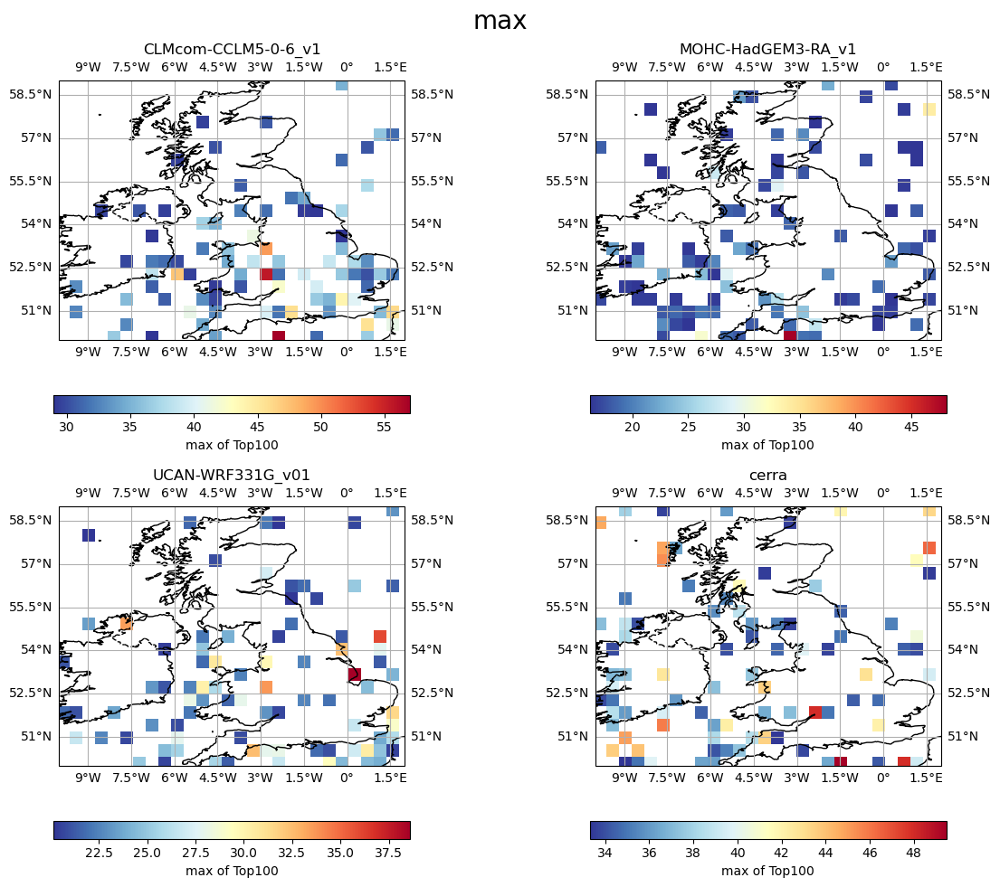

min
---------


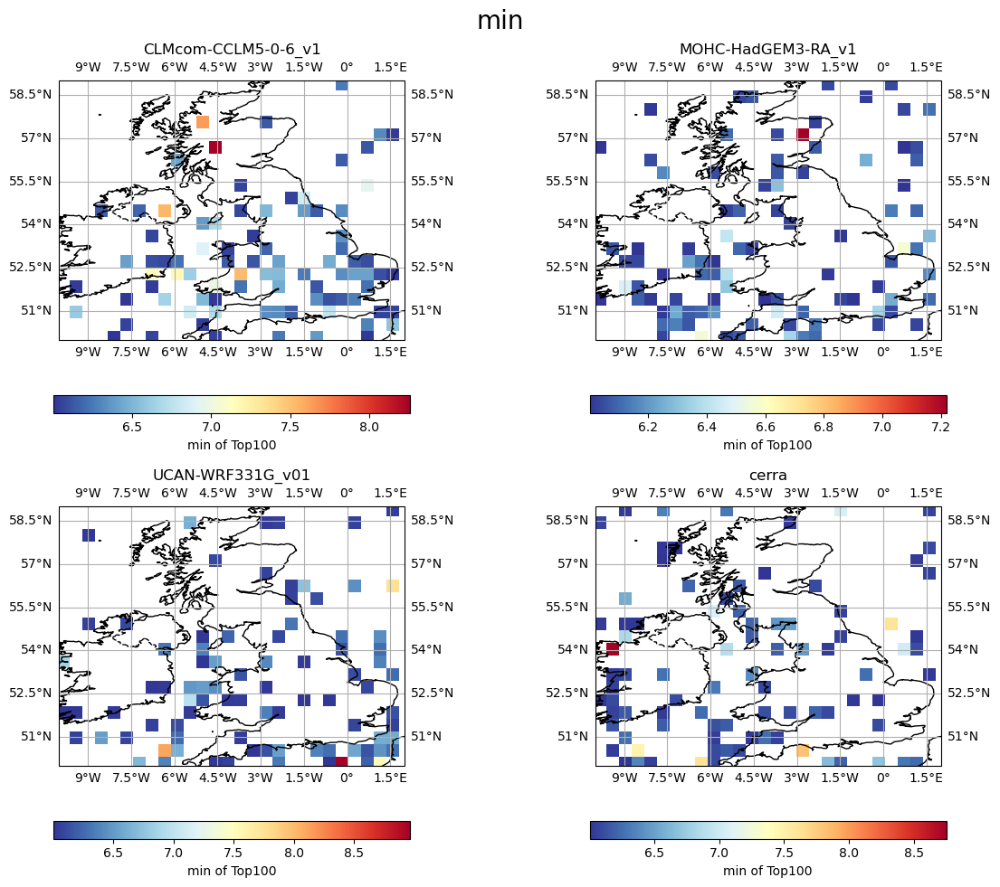

mean
---------


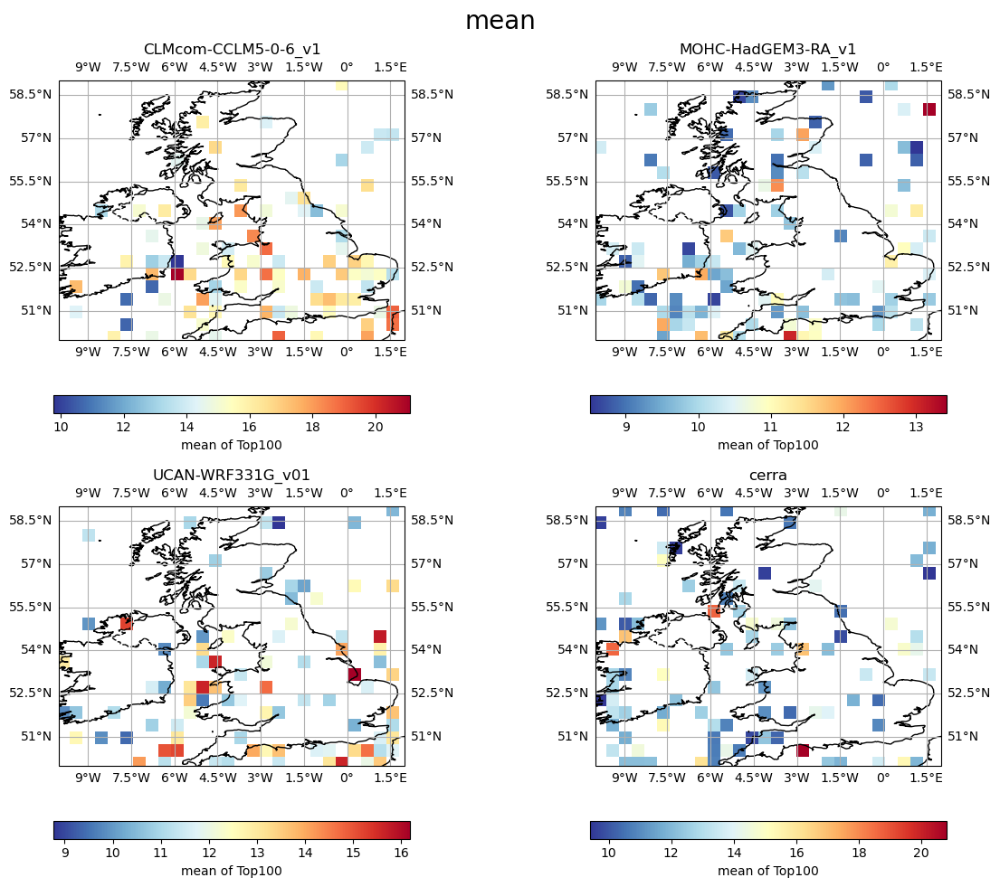

tot
---------


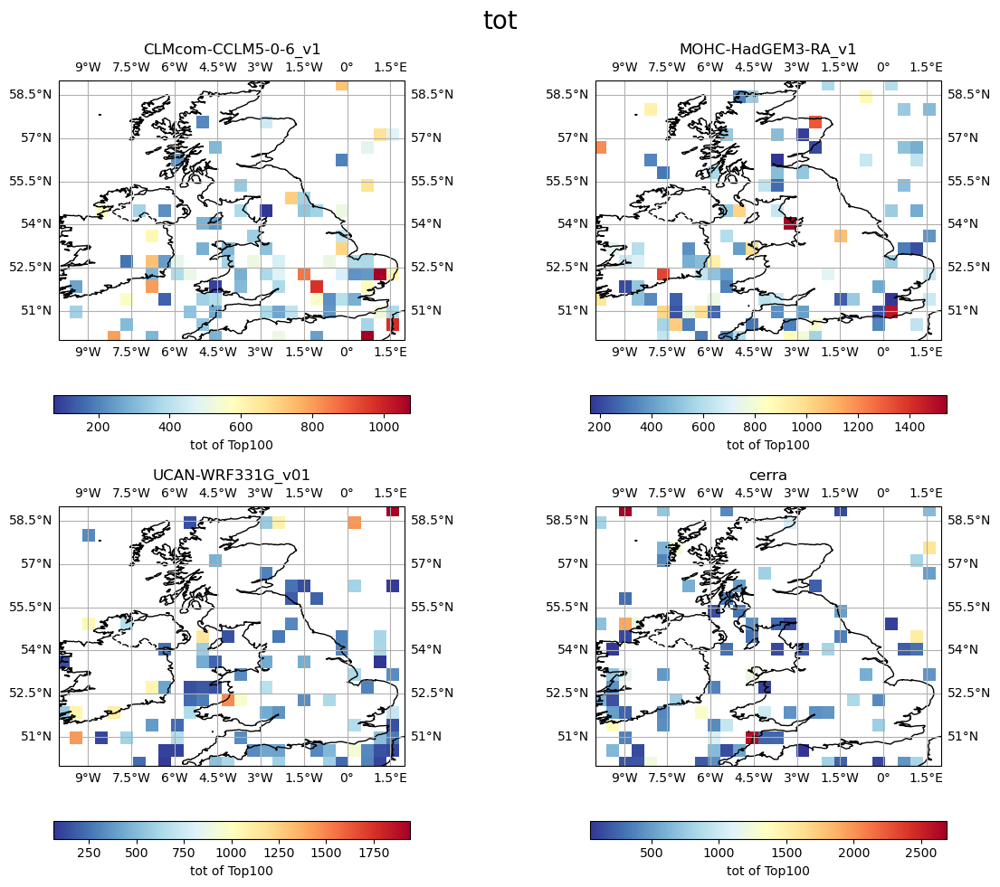

size
---------


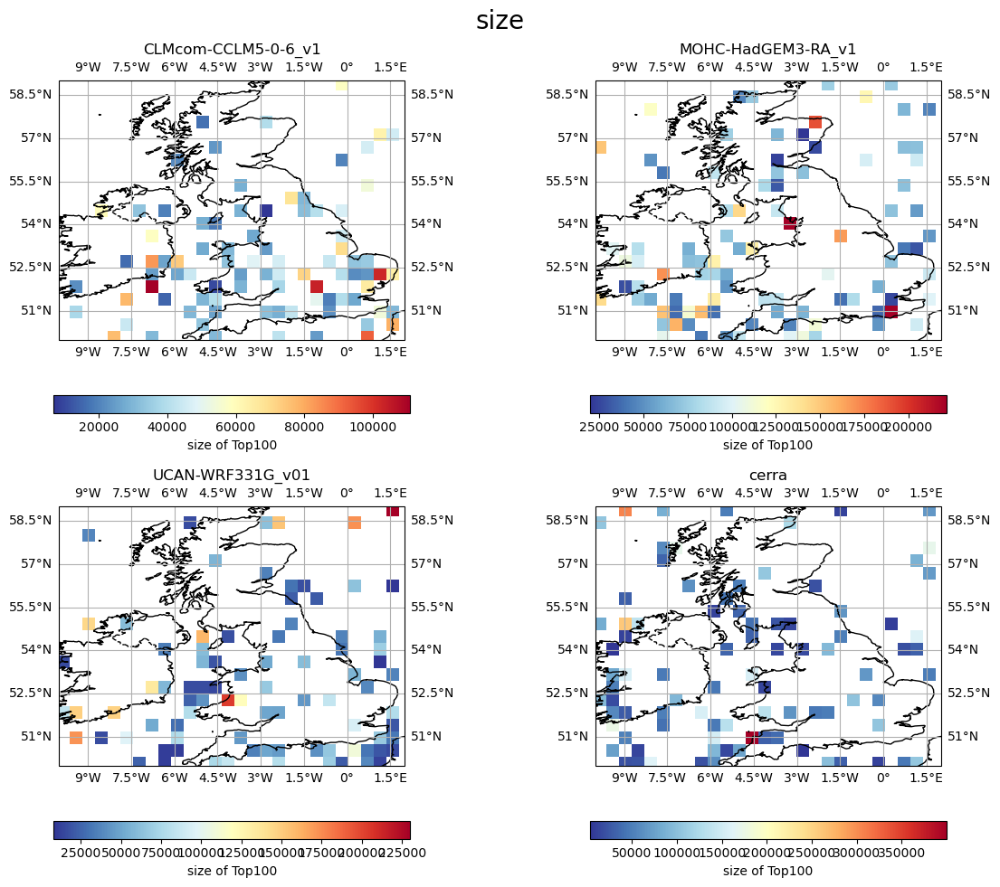

max
---------


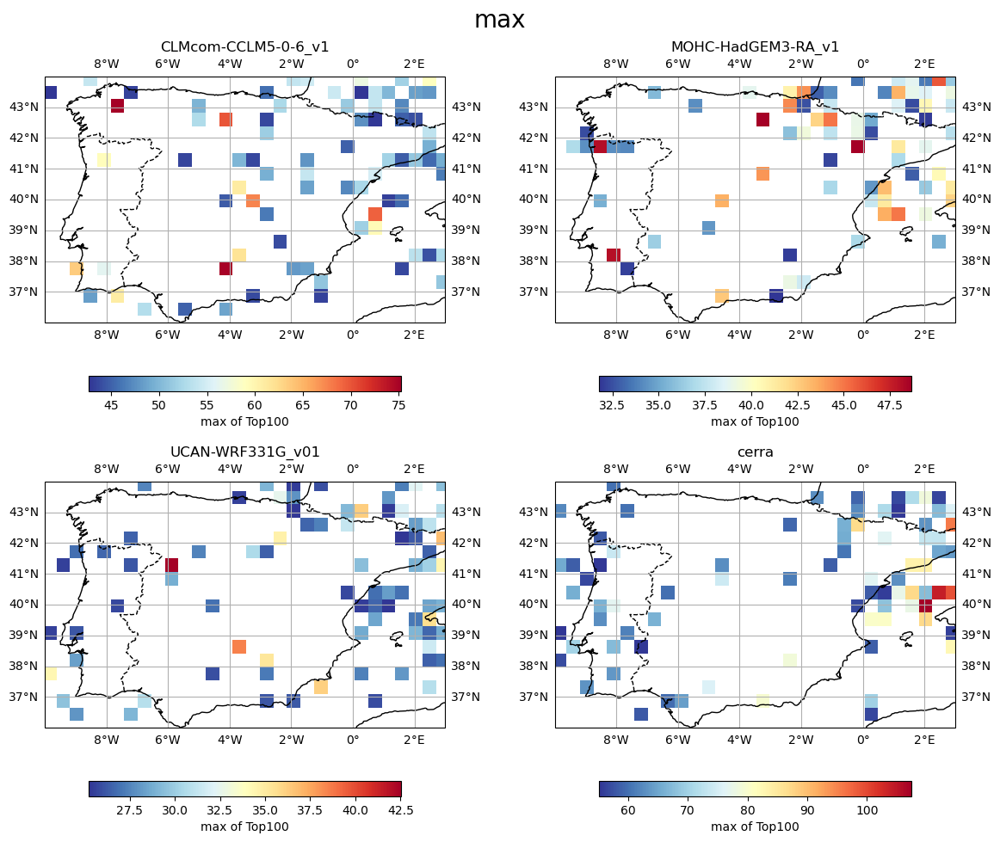

min
---------


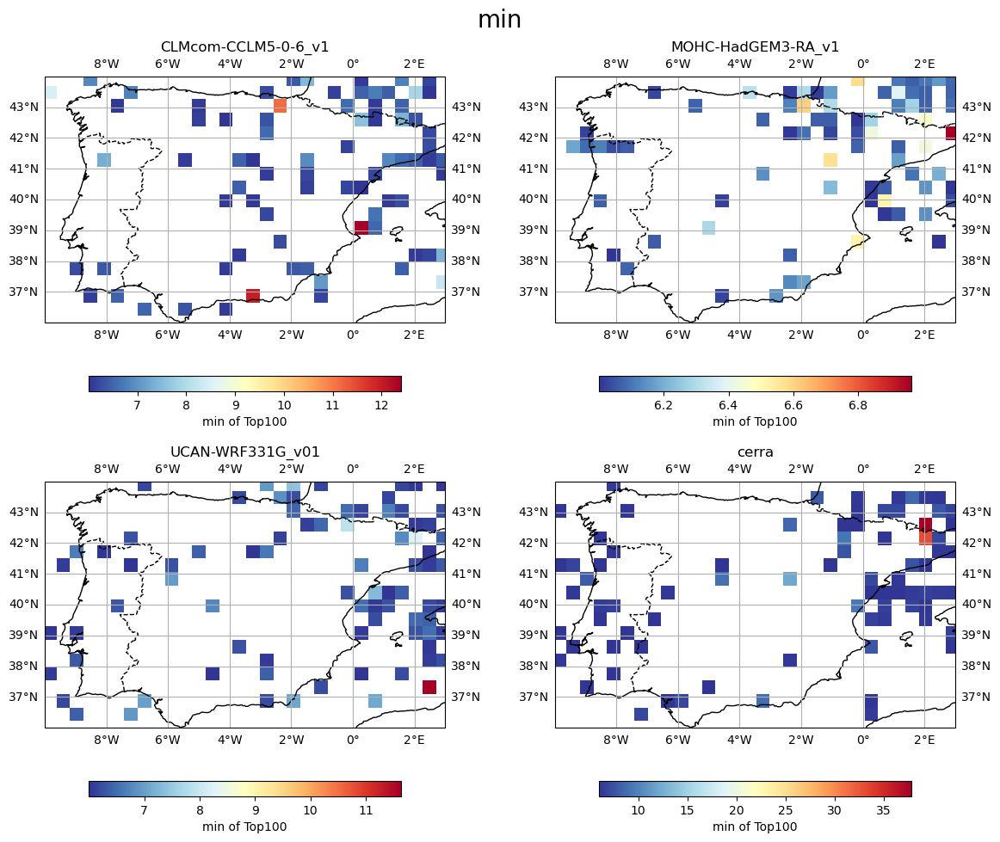

mean
---------


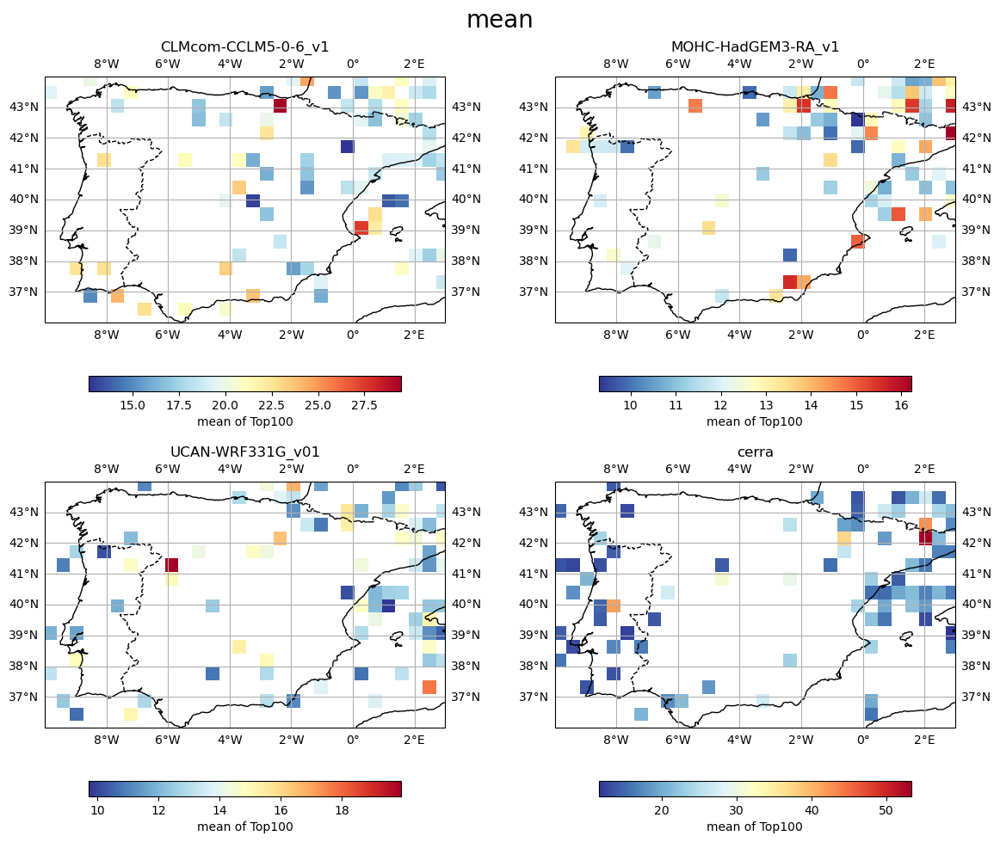

tot
---------


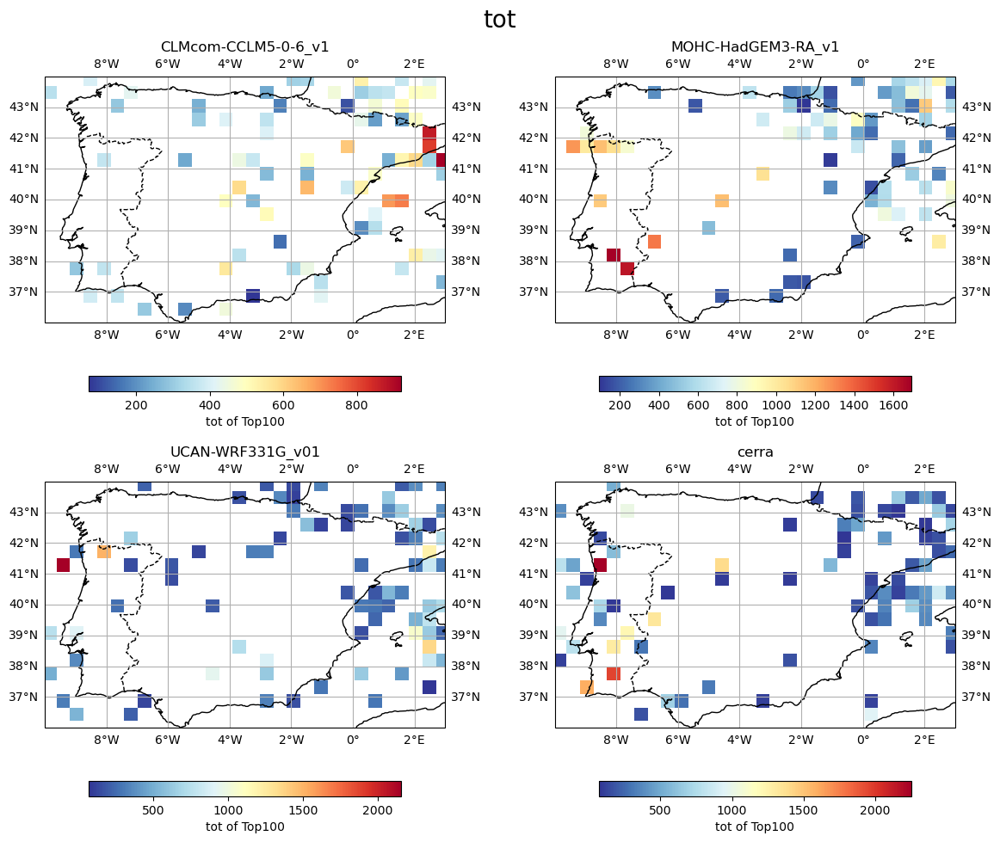

size
---------


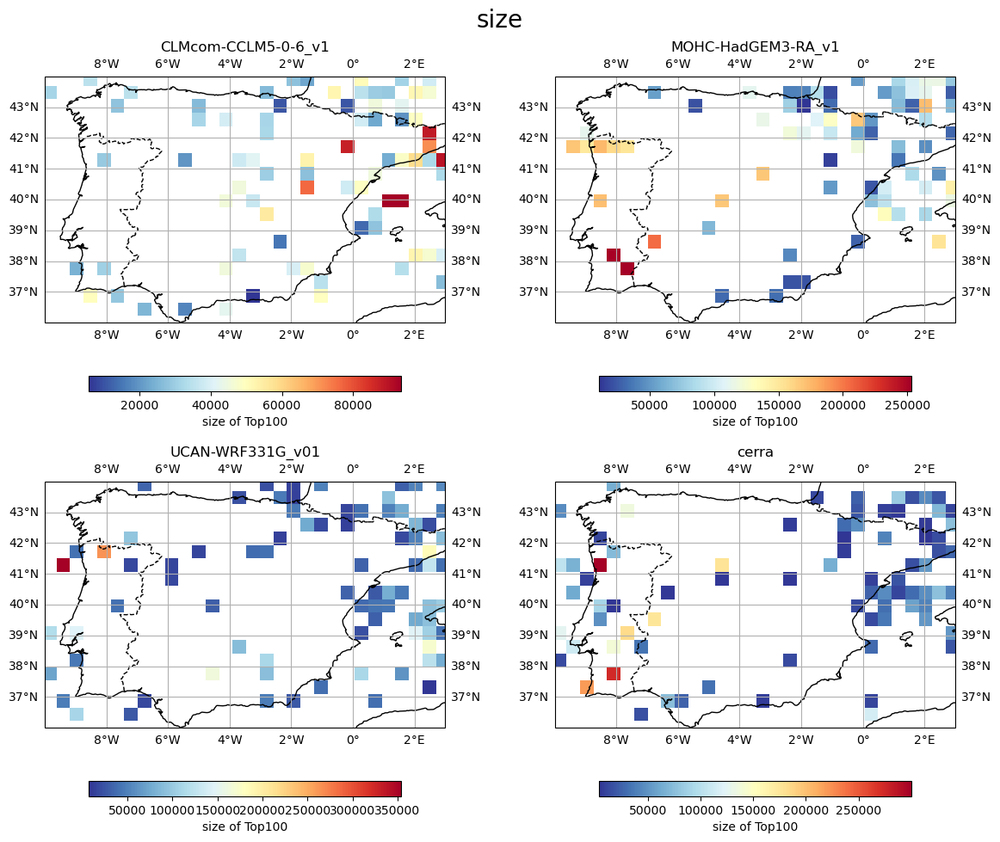

max
---------


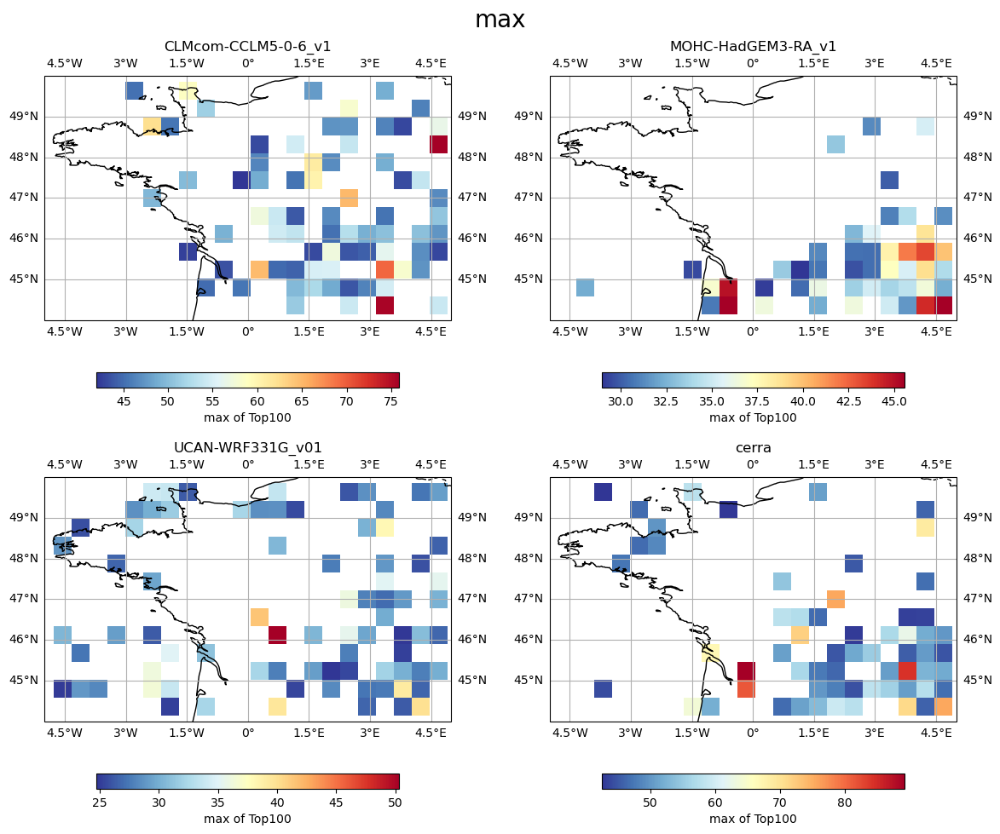

min
---------


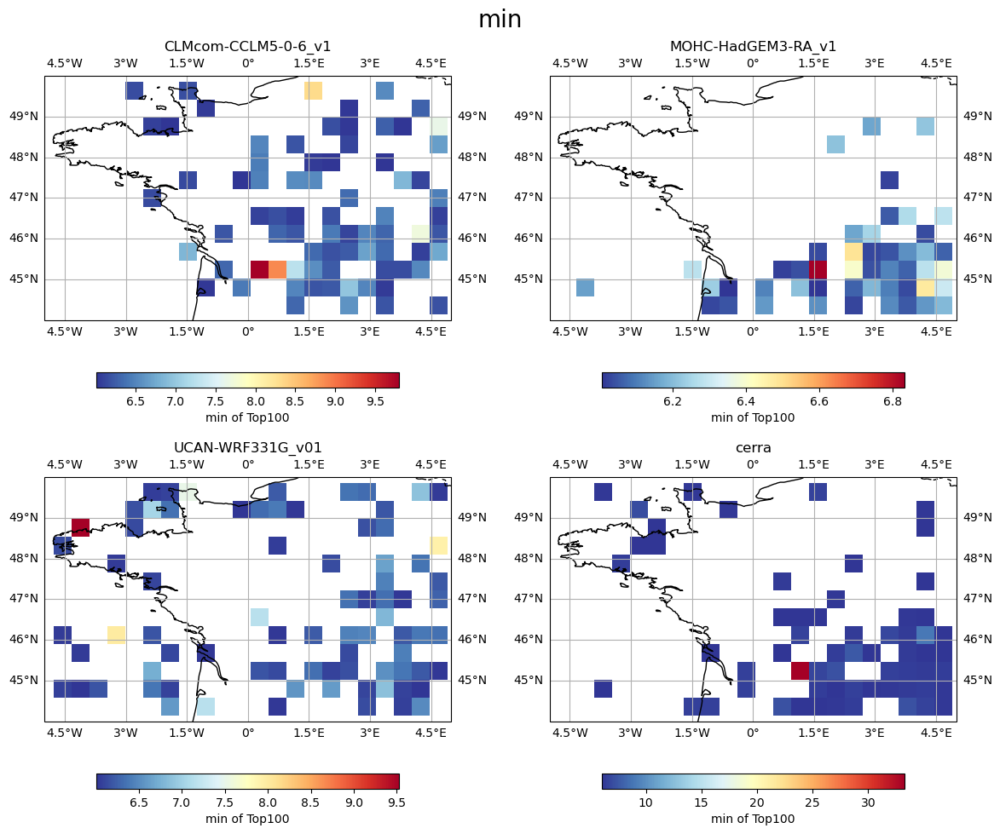

mean
---------


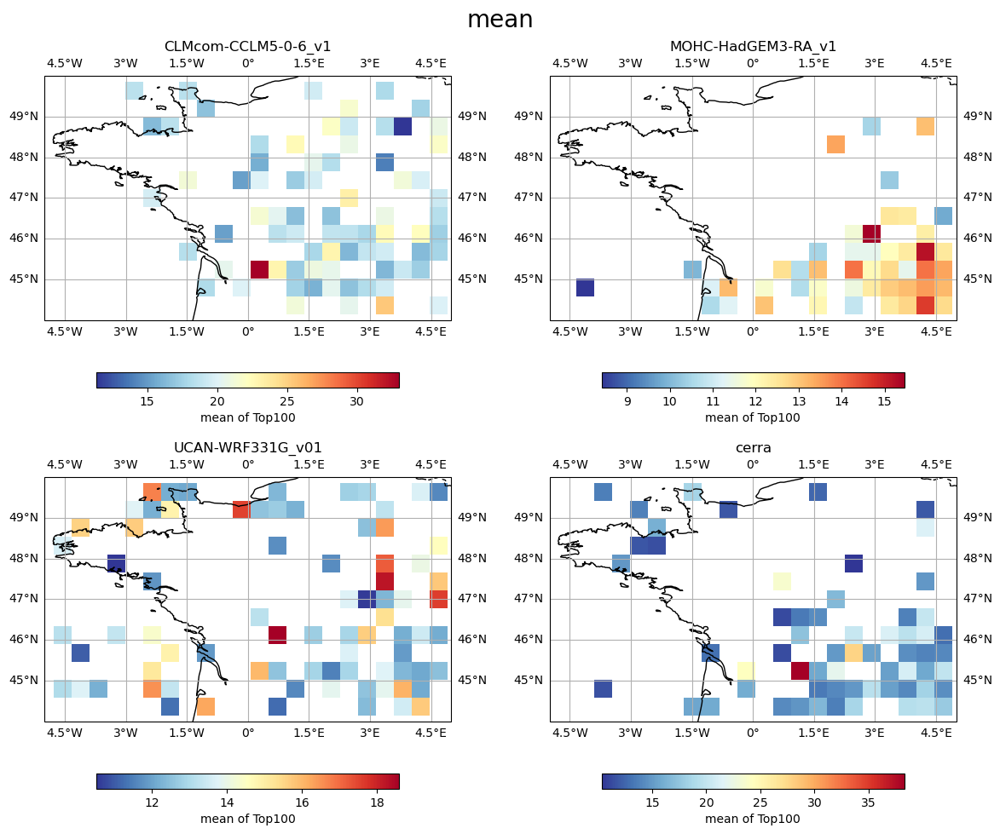

tot
---------


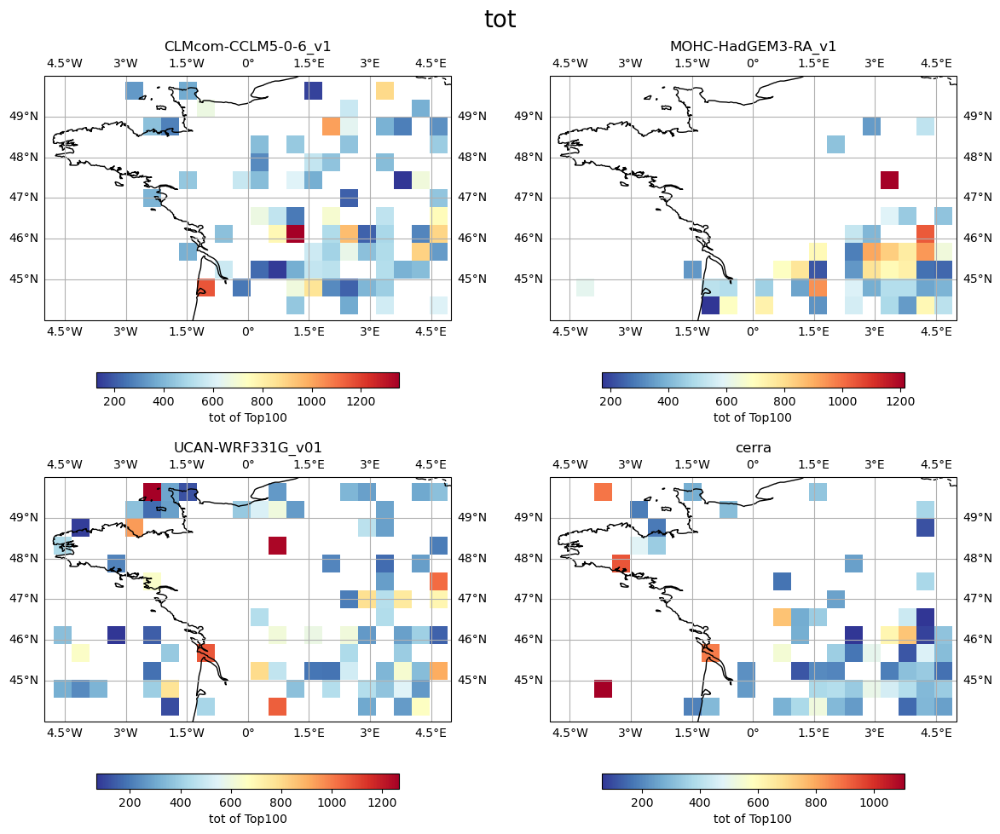

size
---------


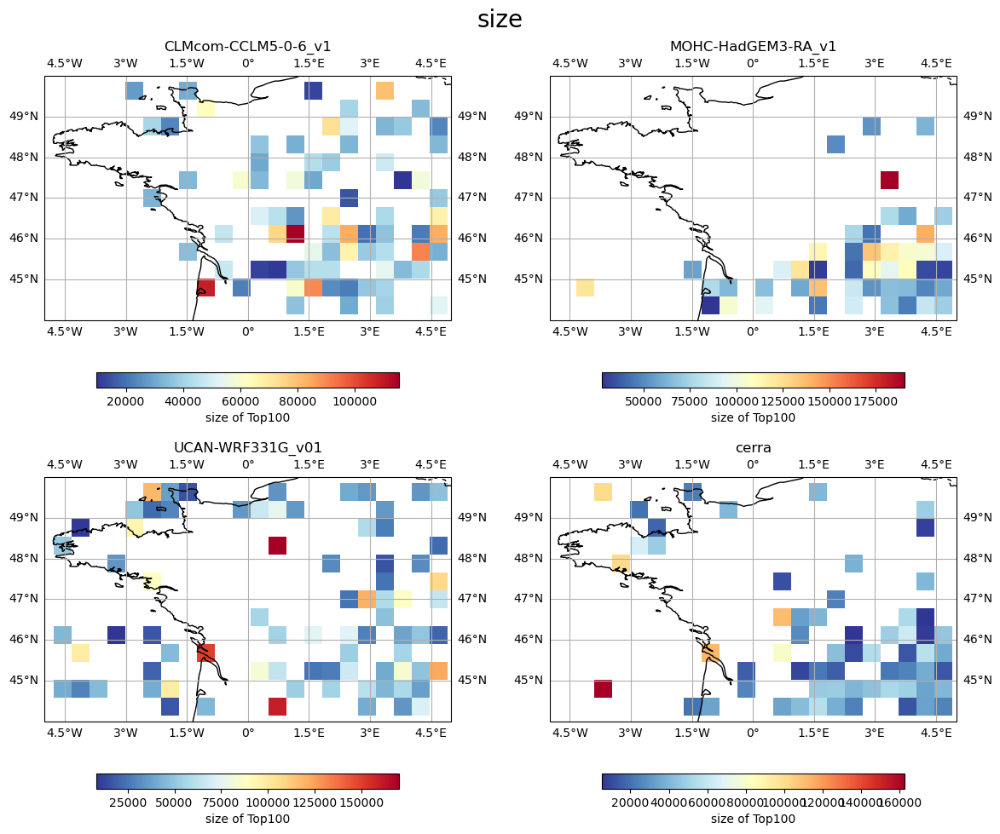

max
---------


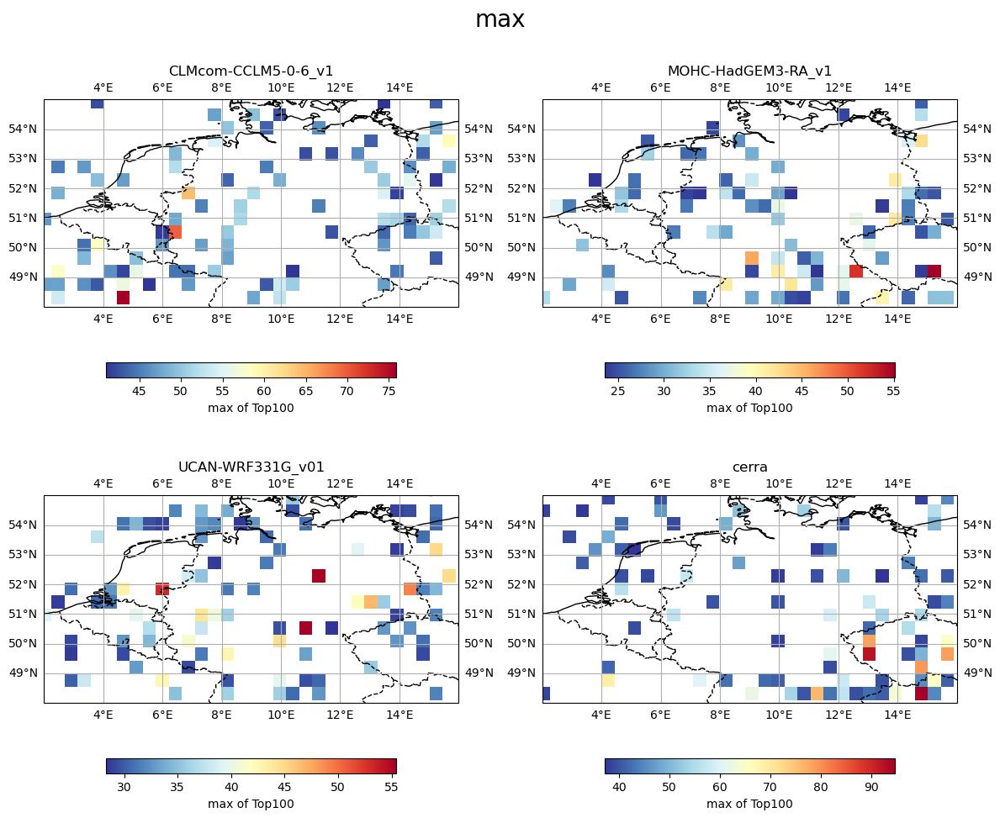

min
---------


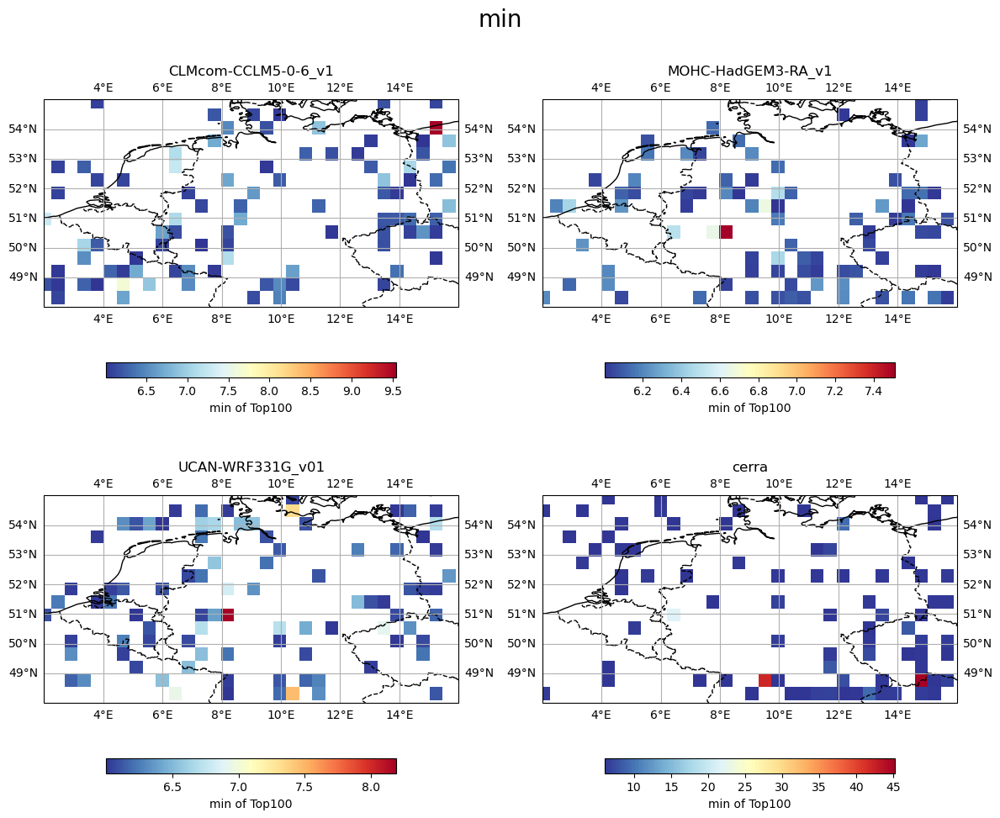

mean
---------


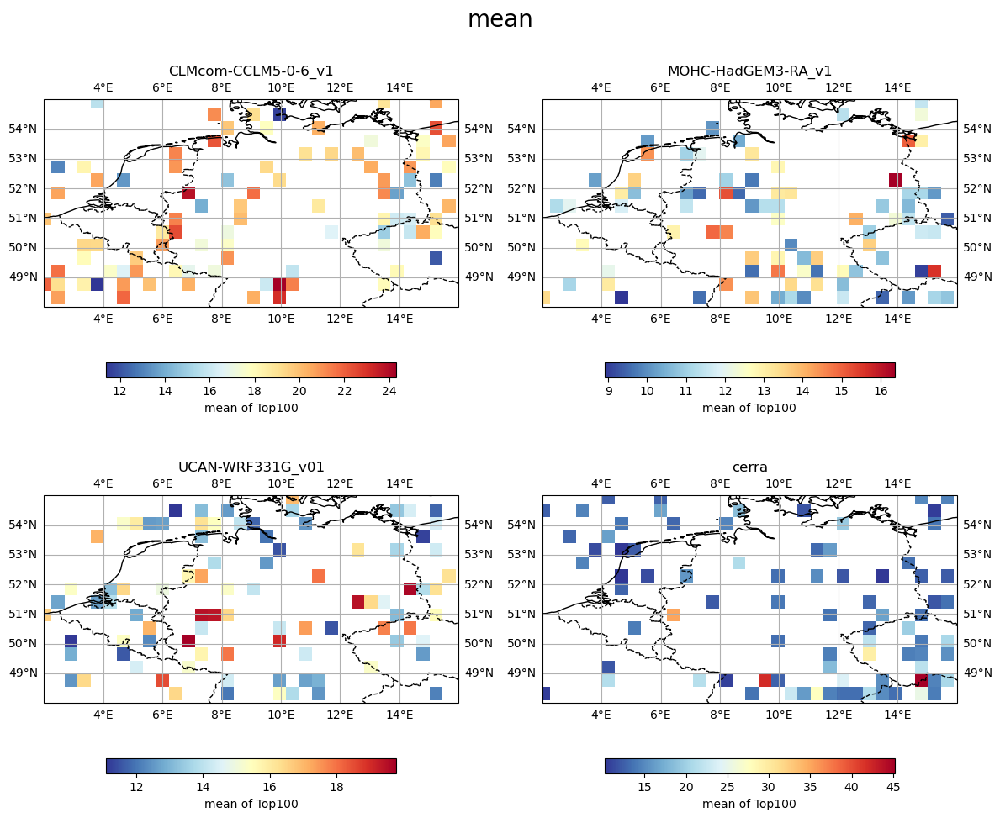

tot
---------


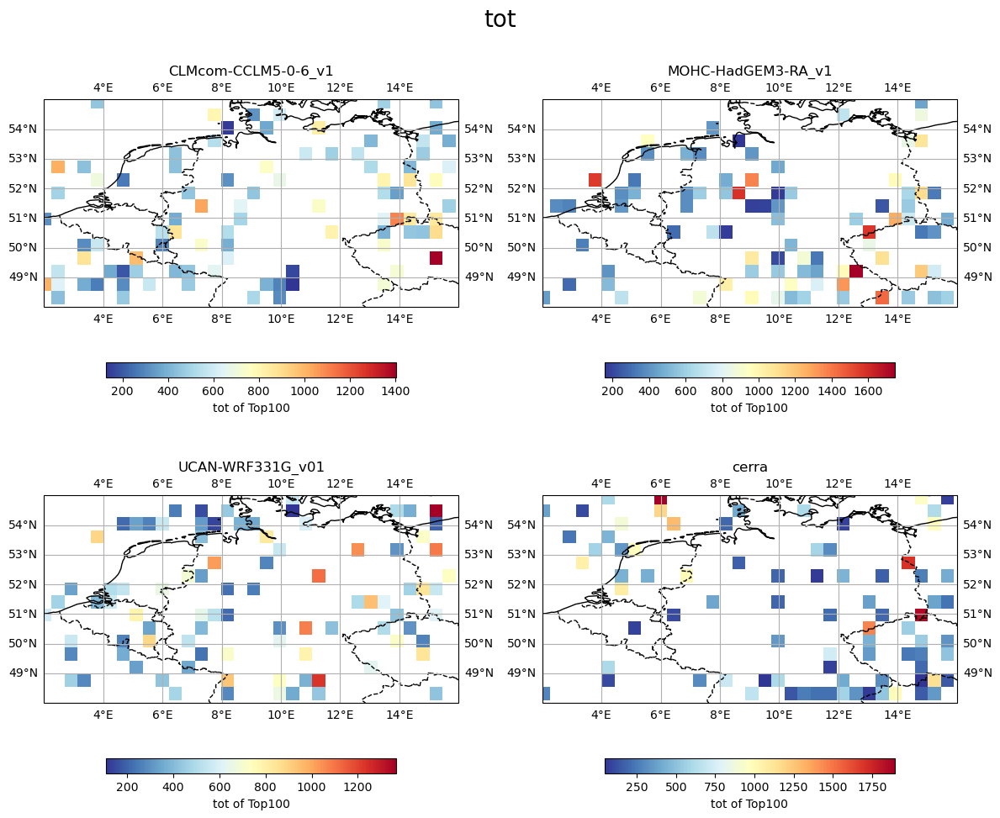

size
---------


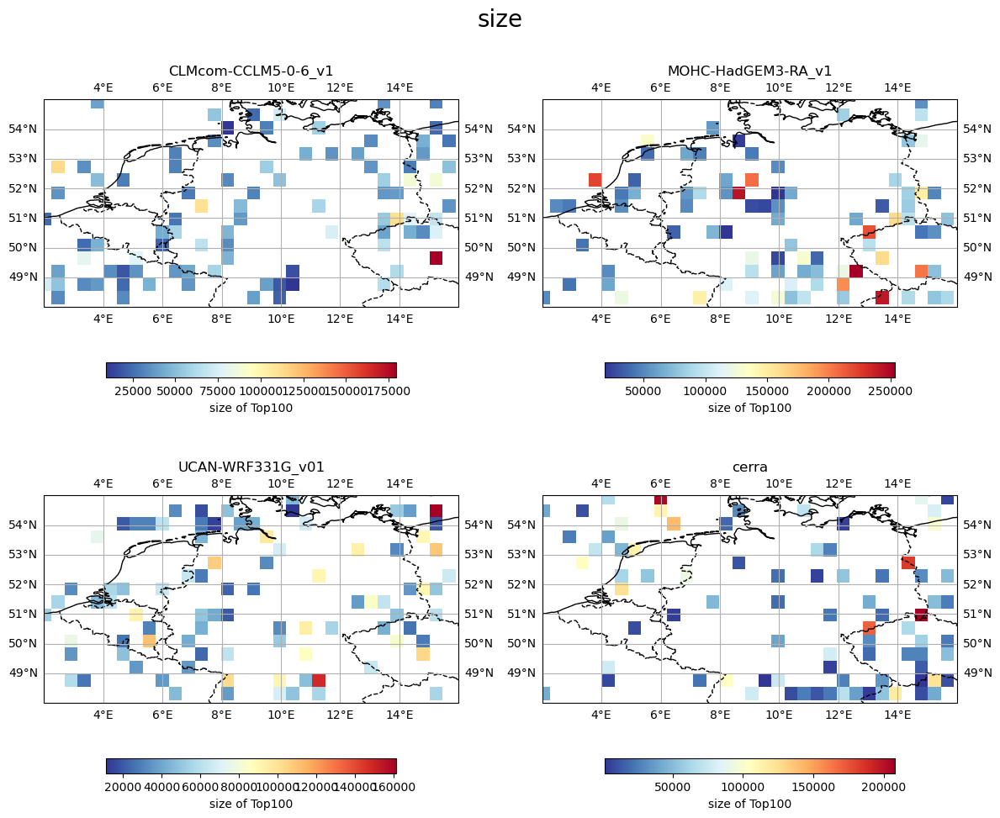

max
---------


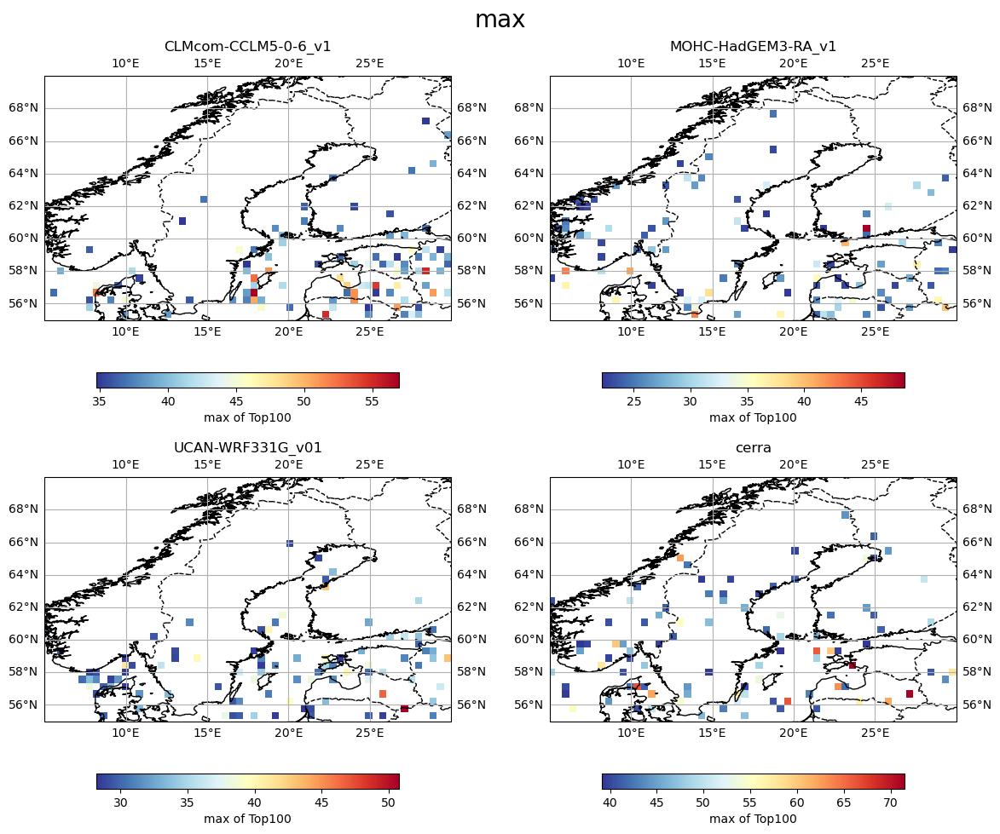

min
---------


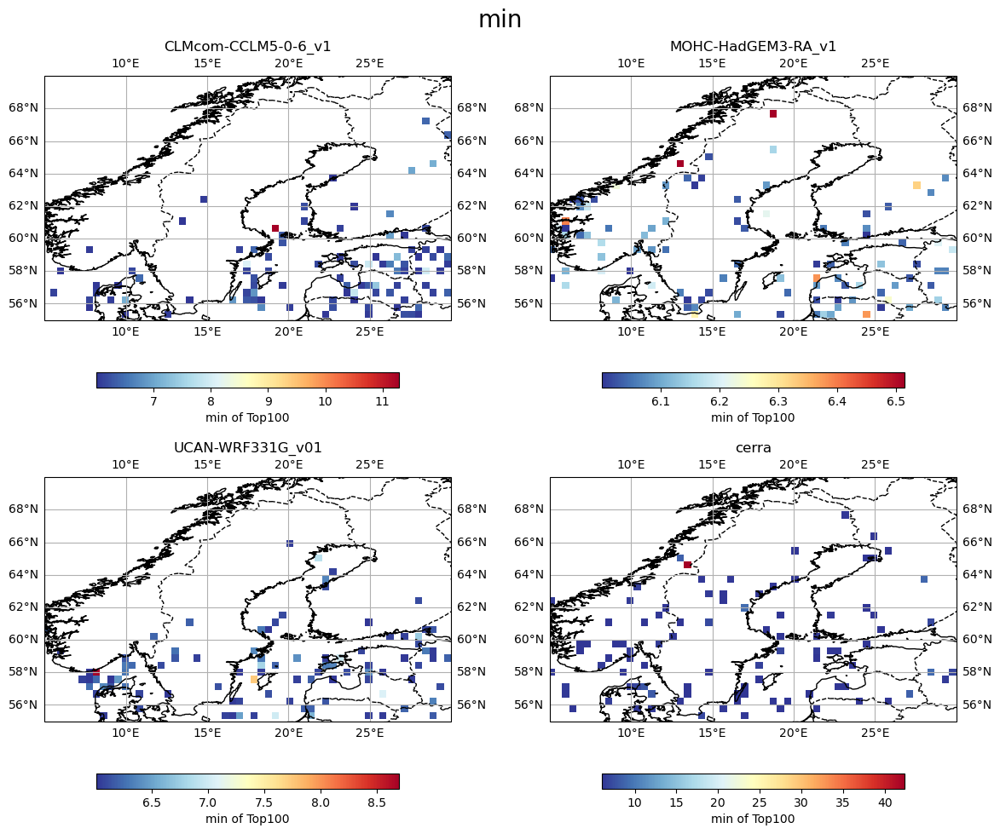

mean
---------


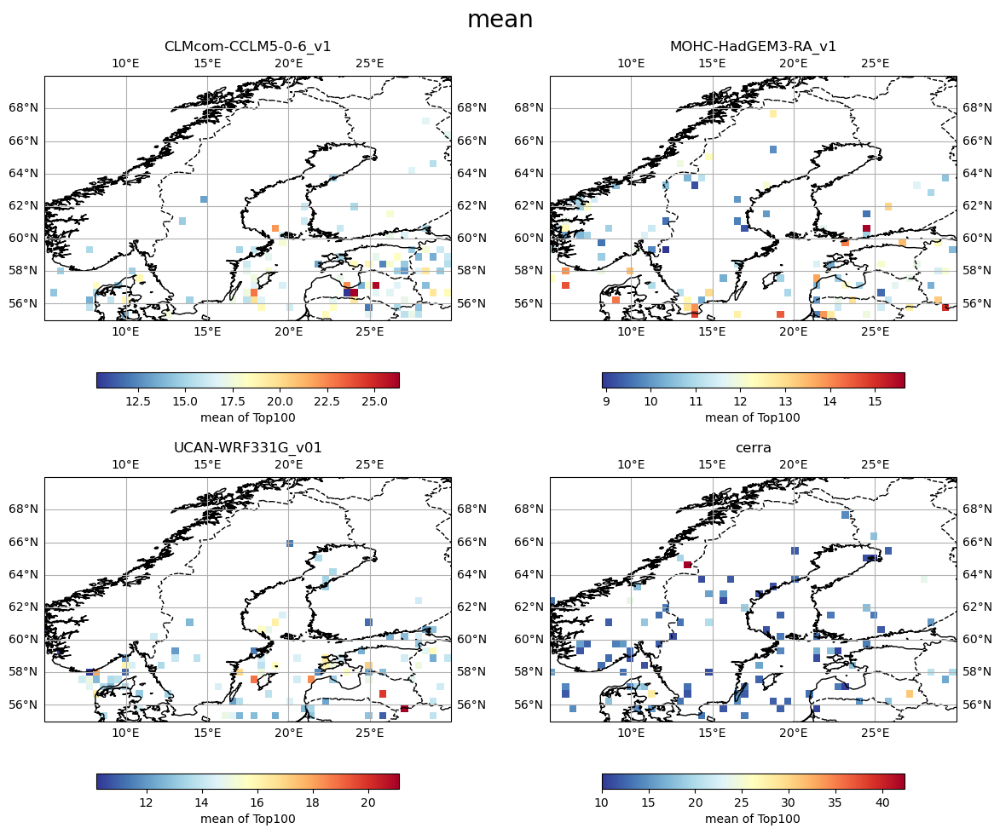

tot
---------


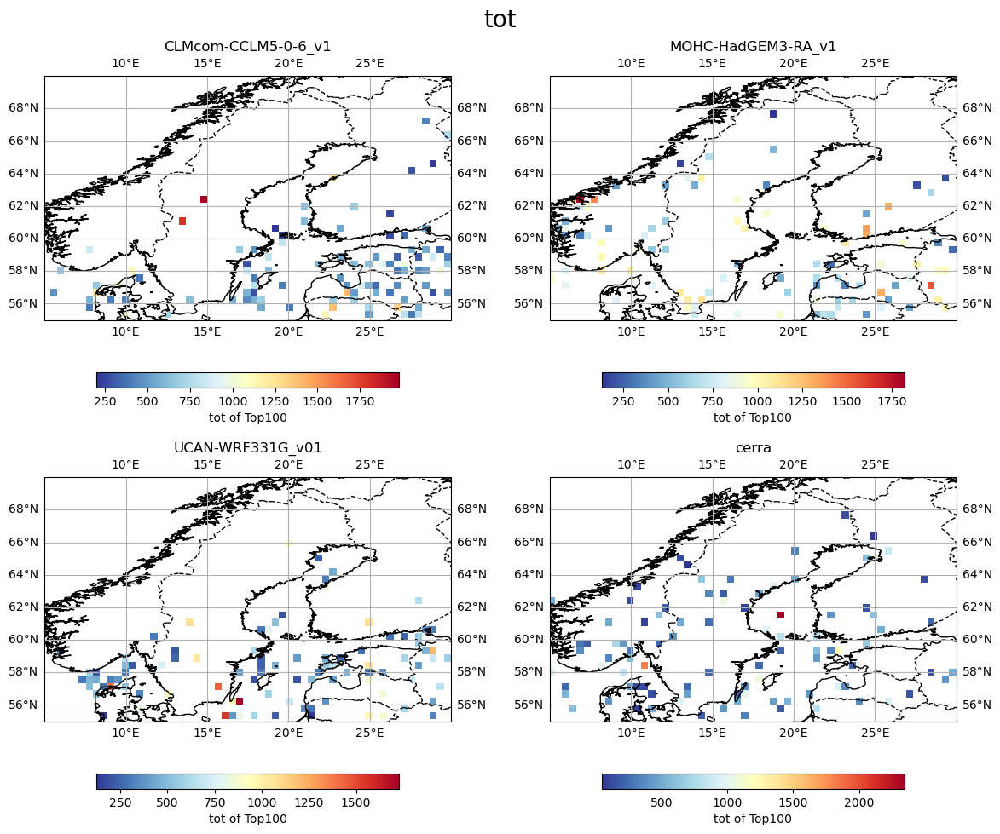

size
---------


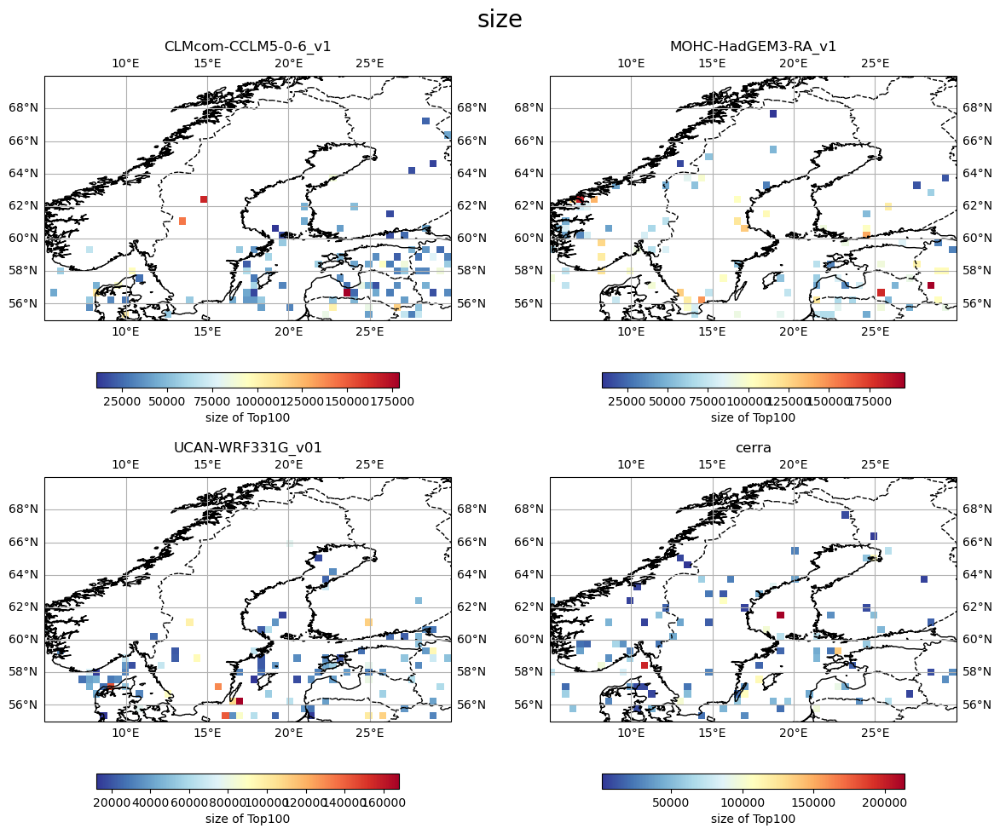

max
---------


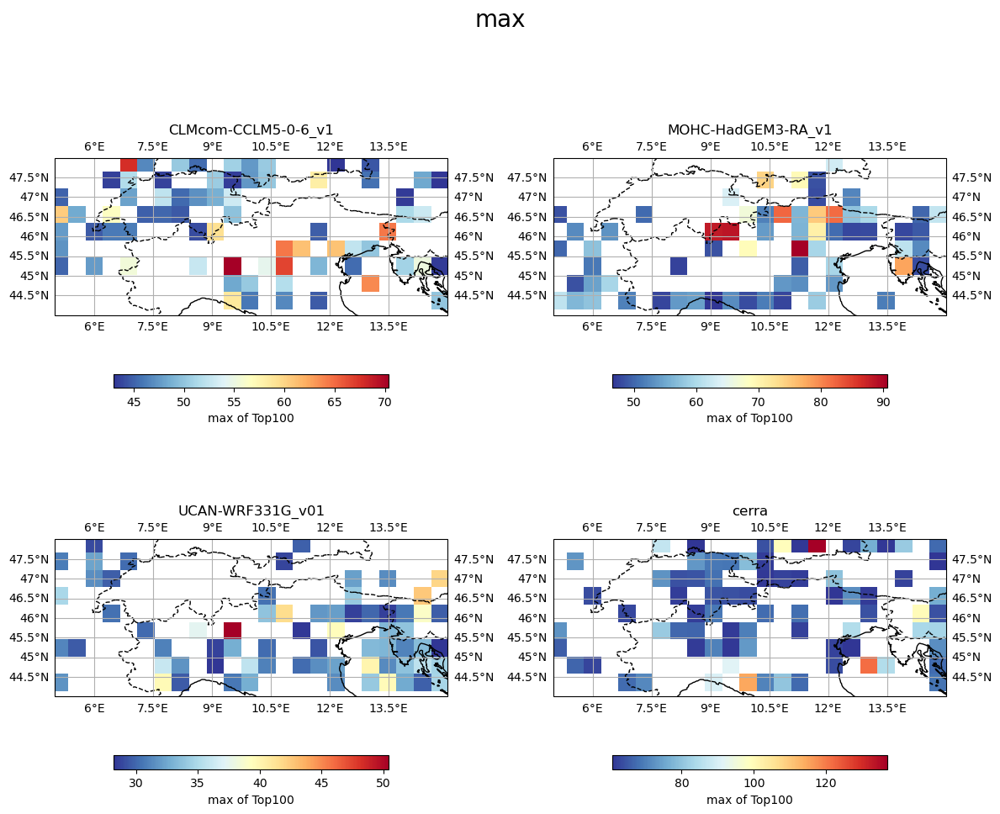

min
---------


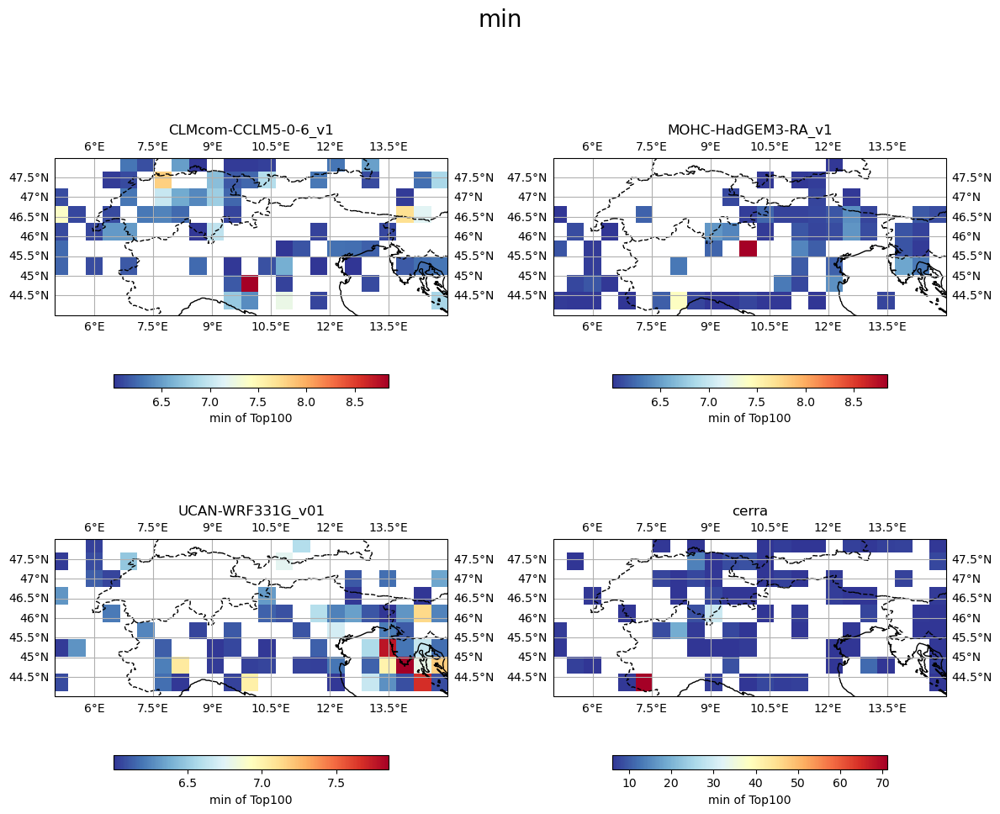

mean
---------


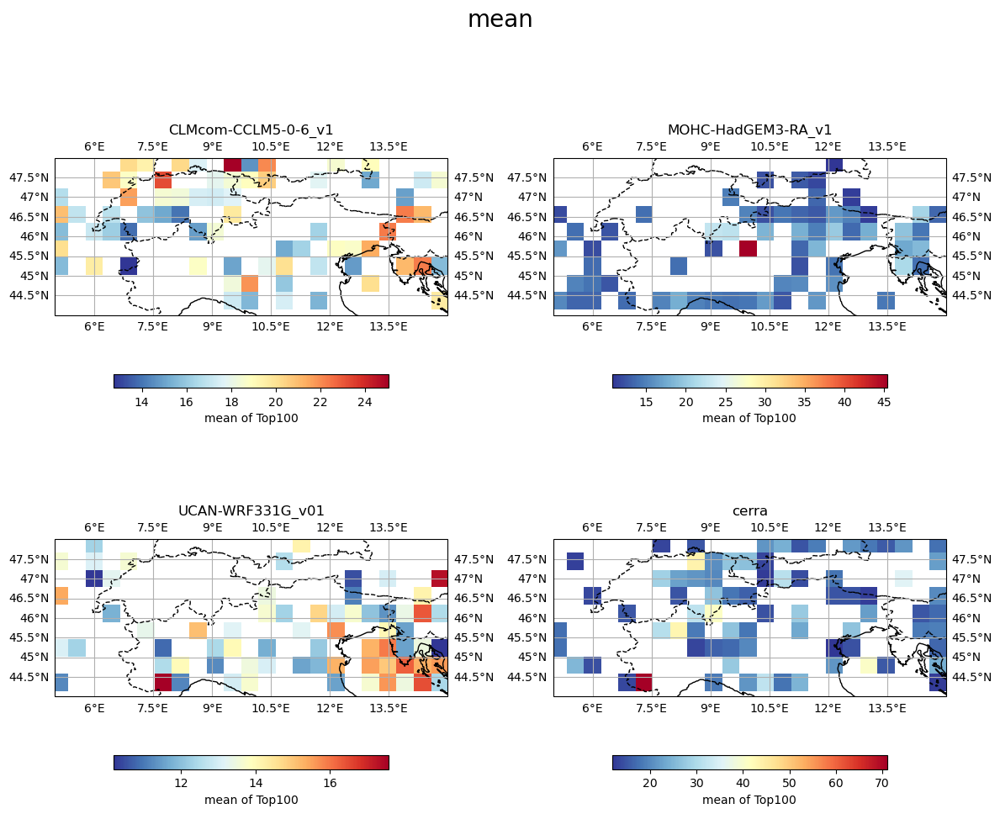

tot
---------


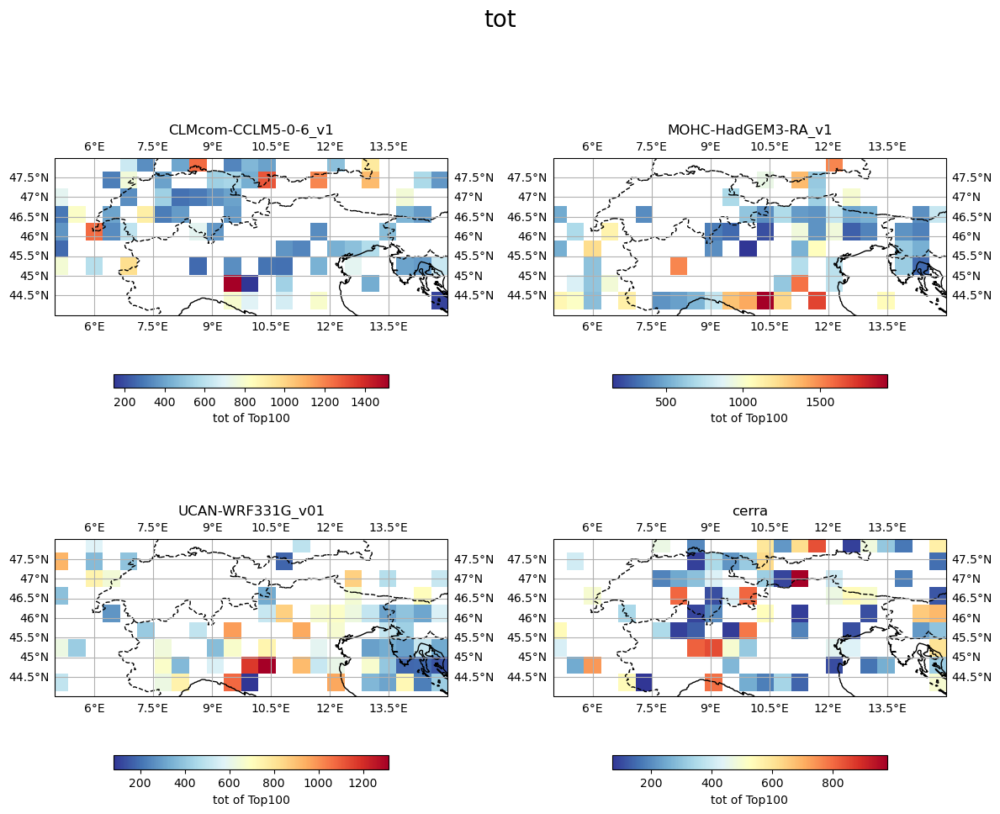

size
---------


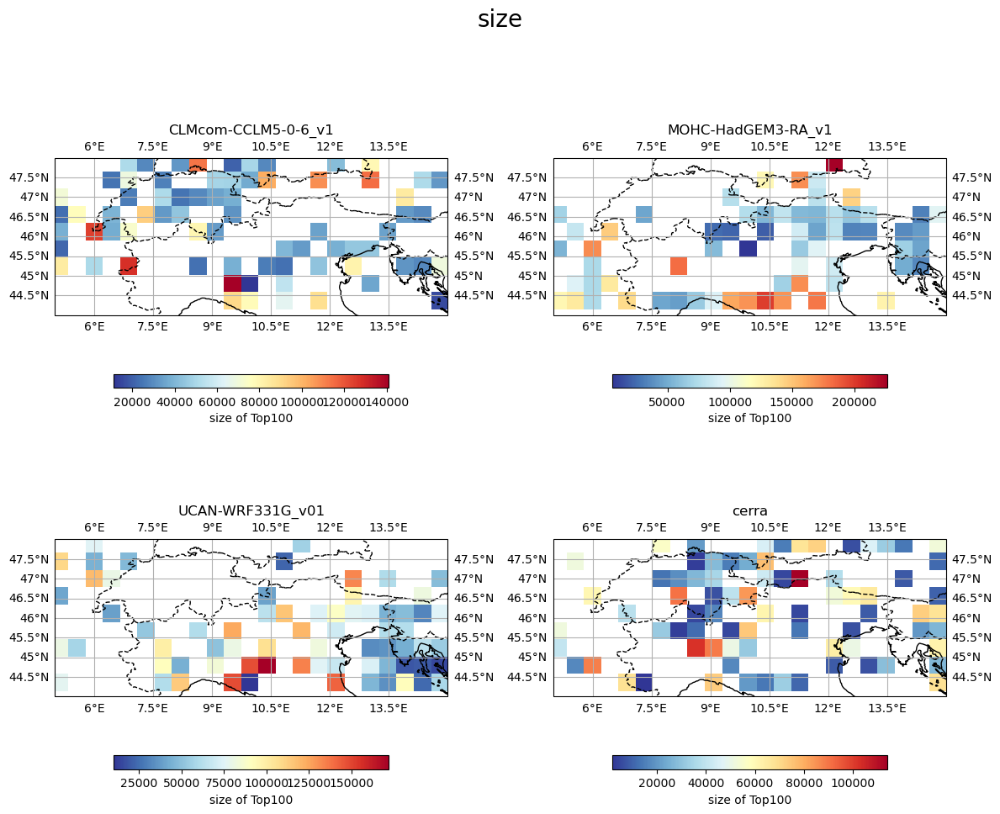

max
---------


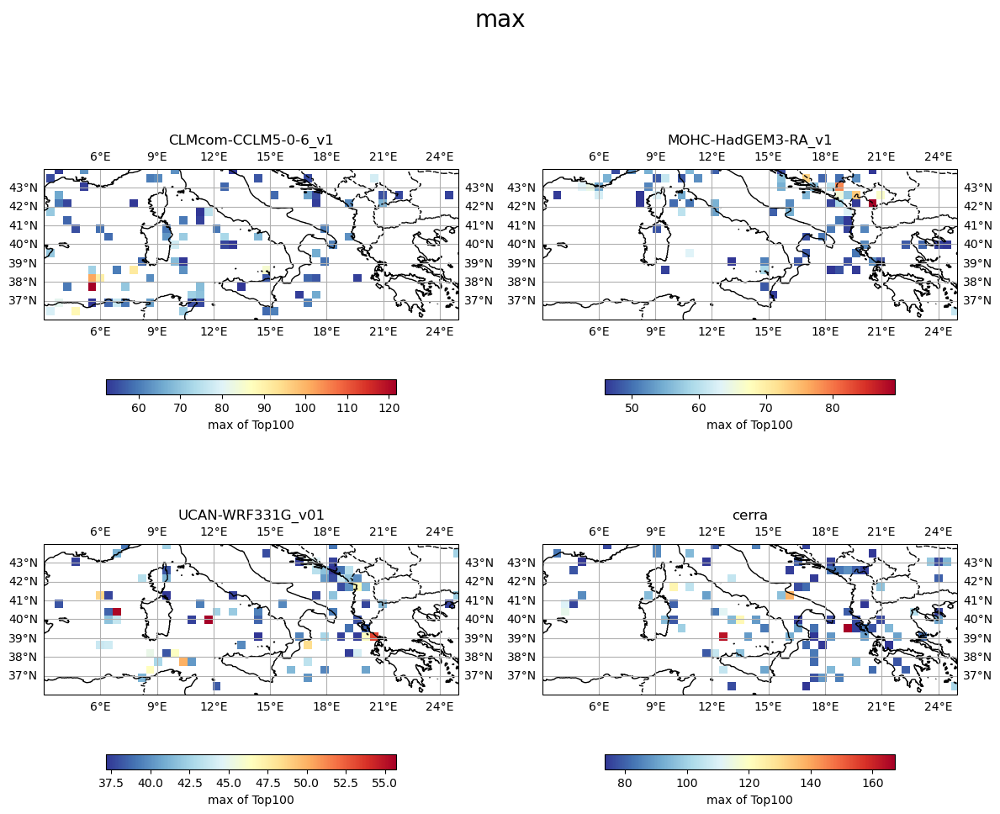

min
---------


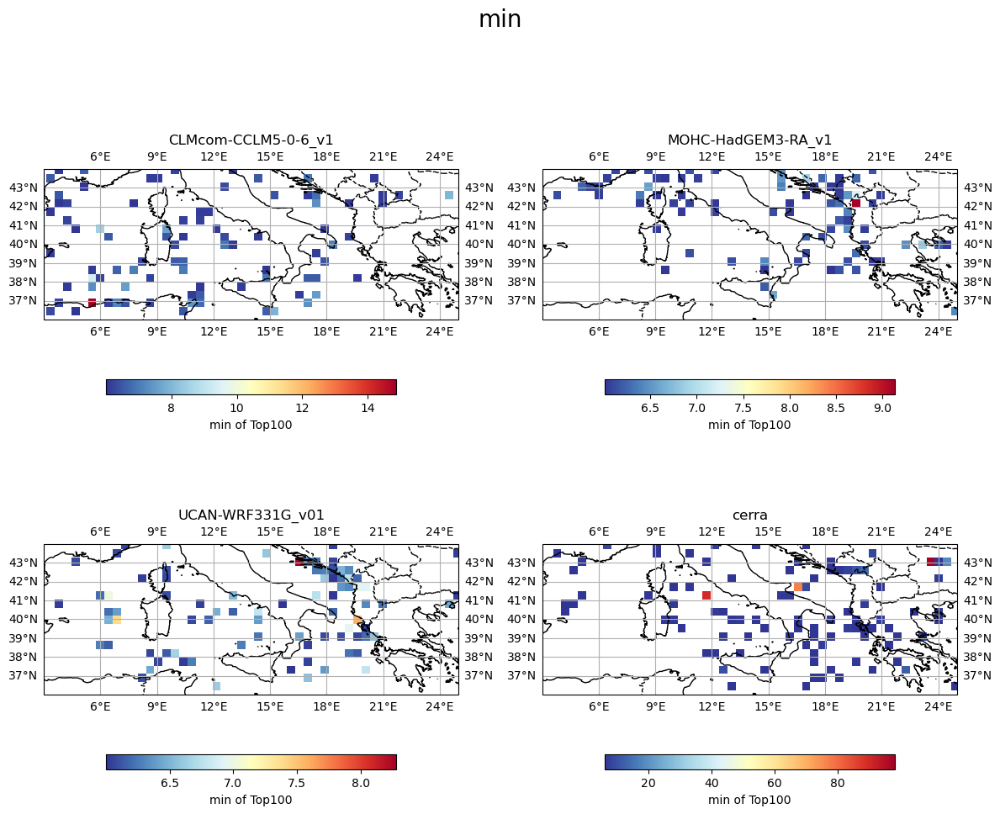

mean
---------


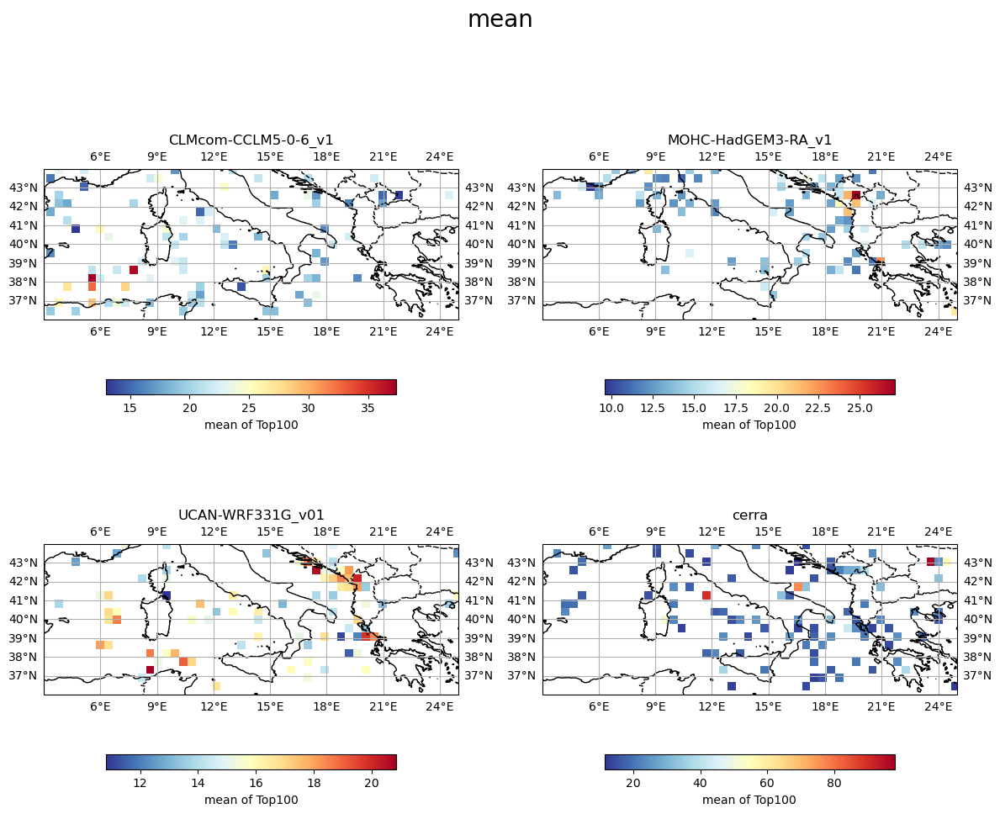

tot
---------


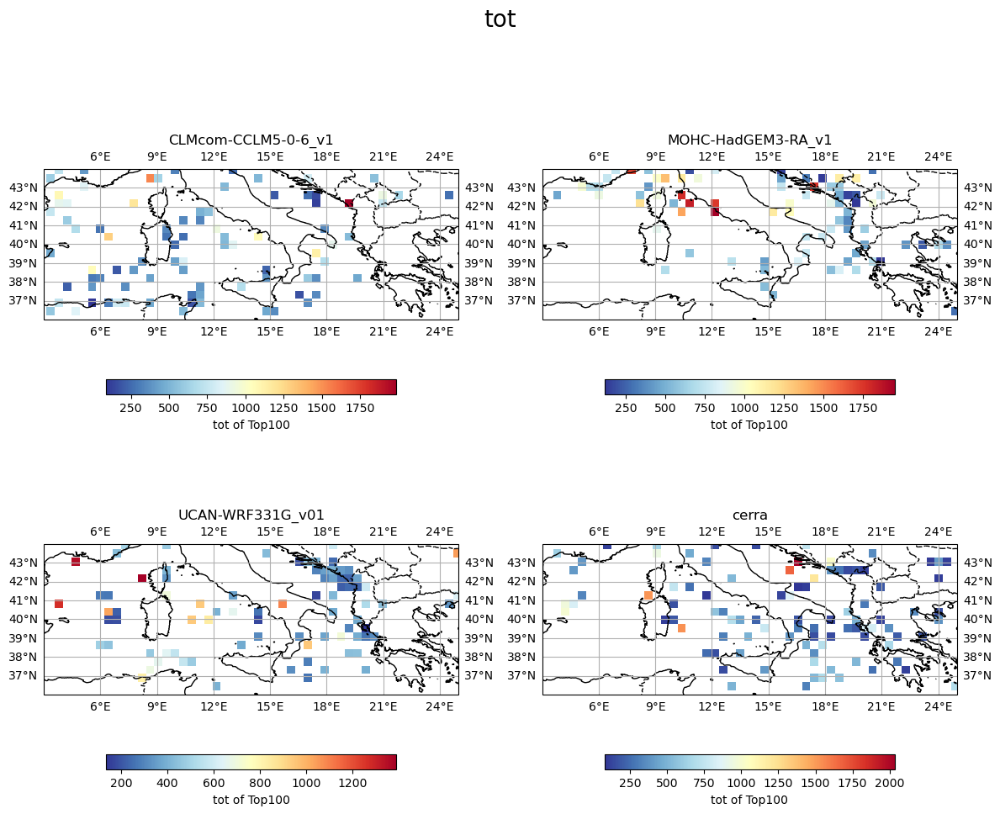

size
---------


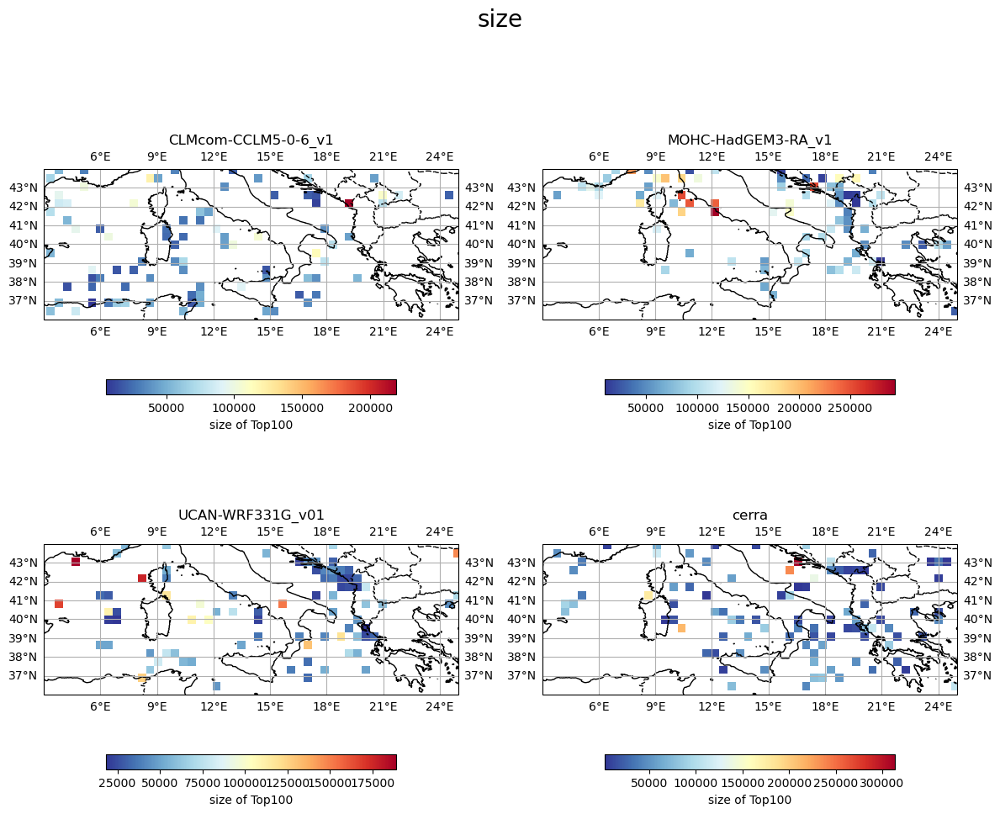

max
---------


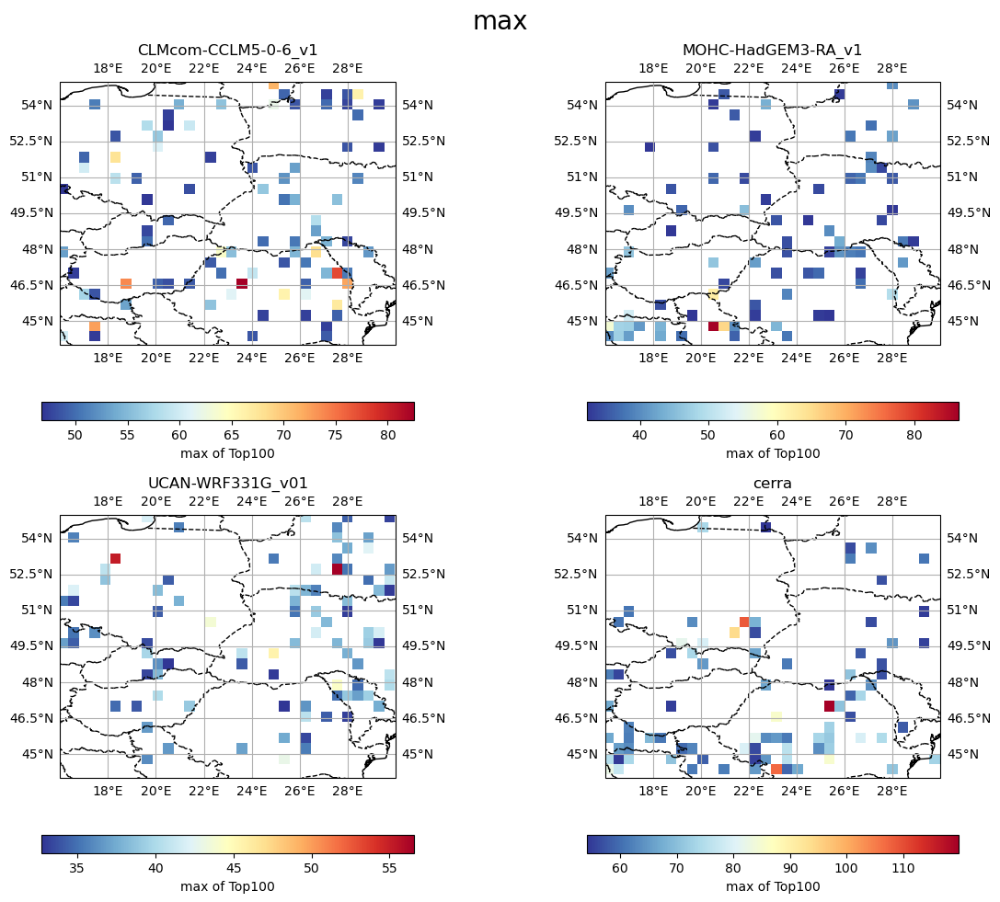

min
---------


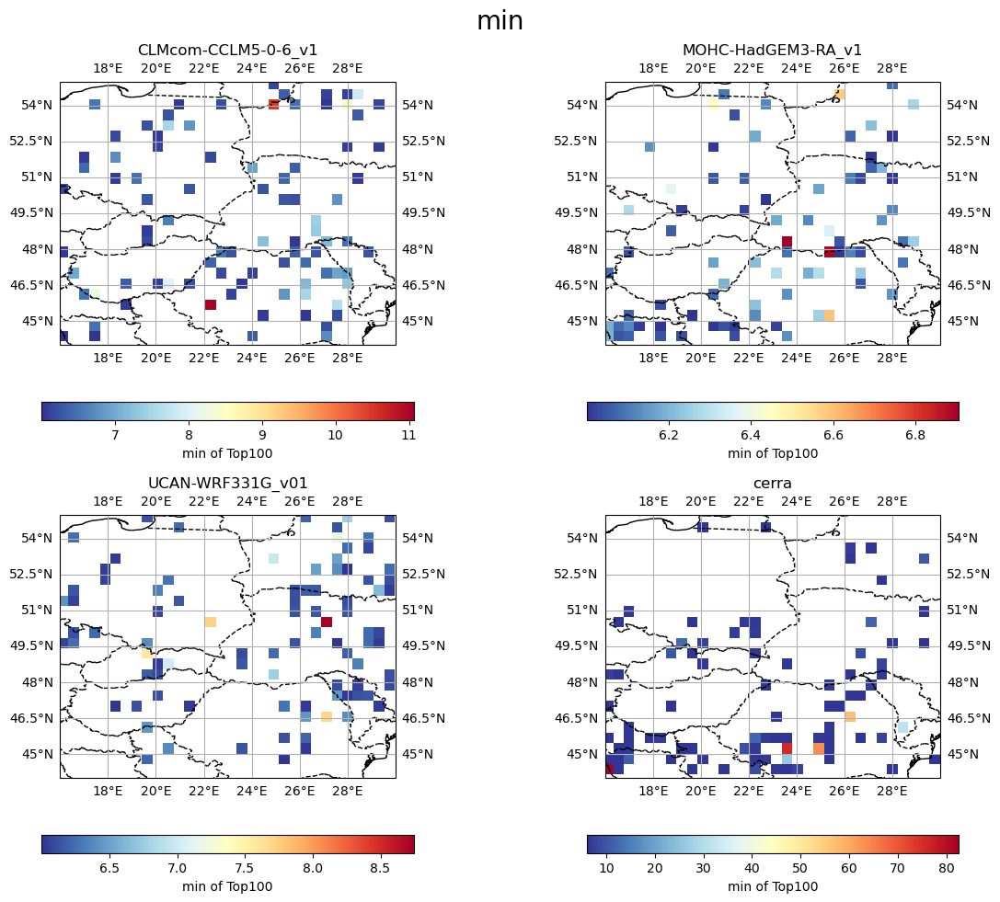

mean
---------


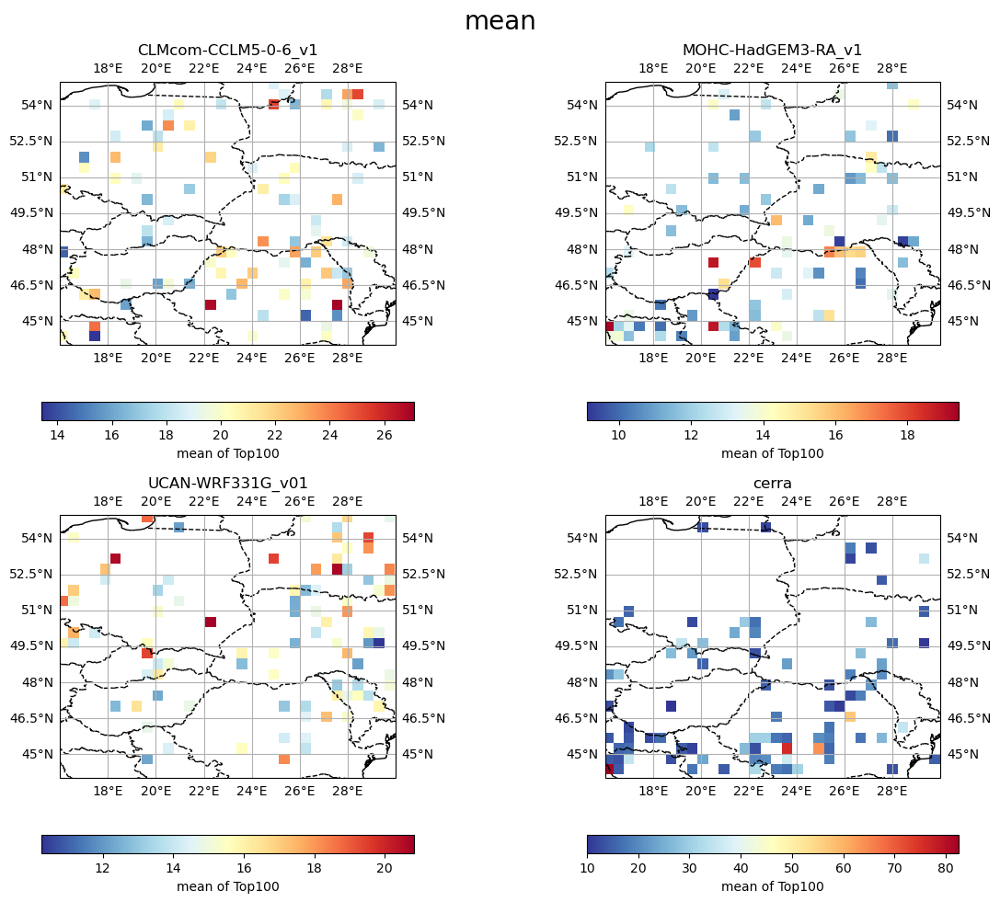

tot
---------


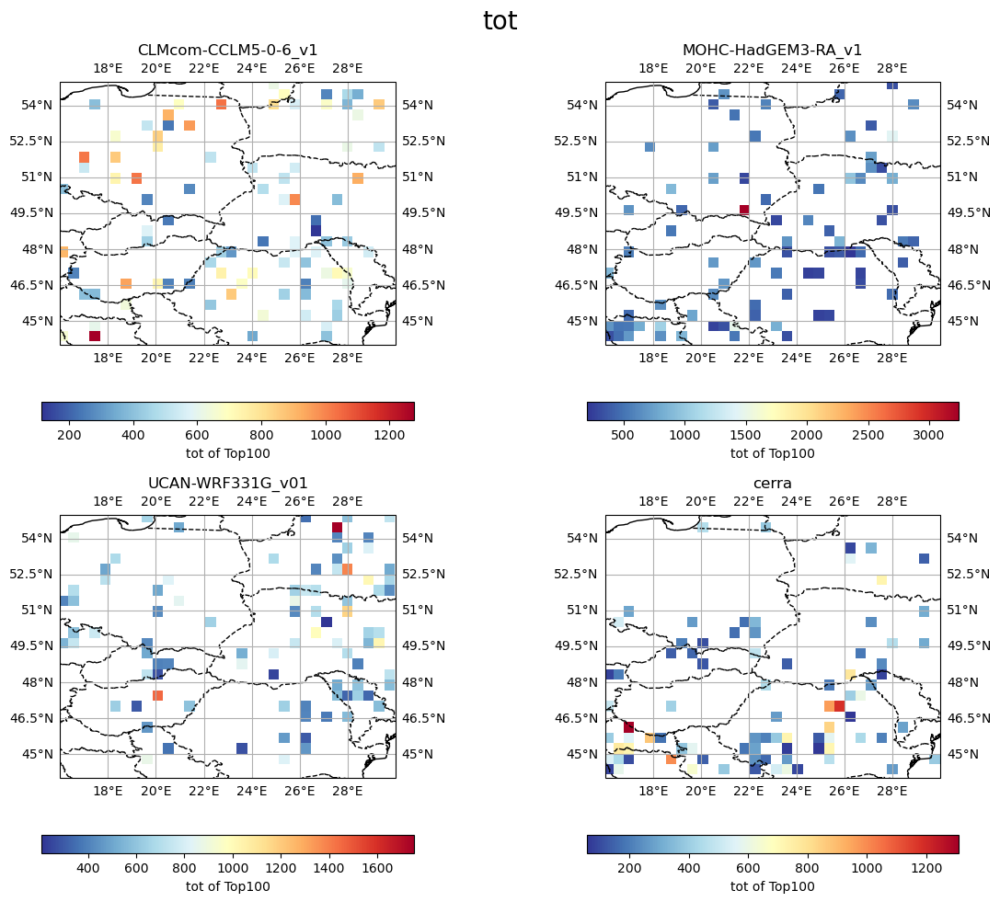

size
---------


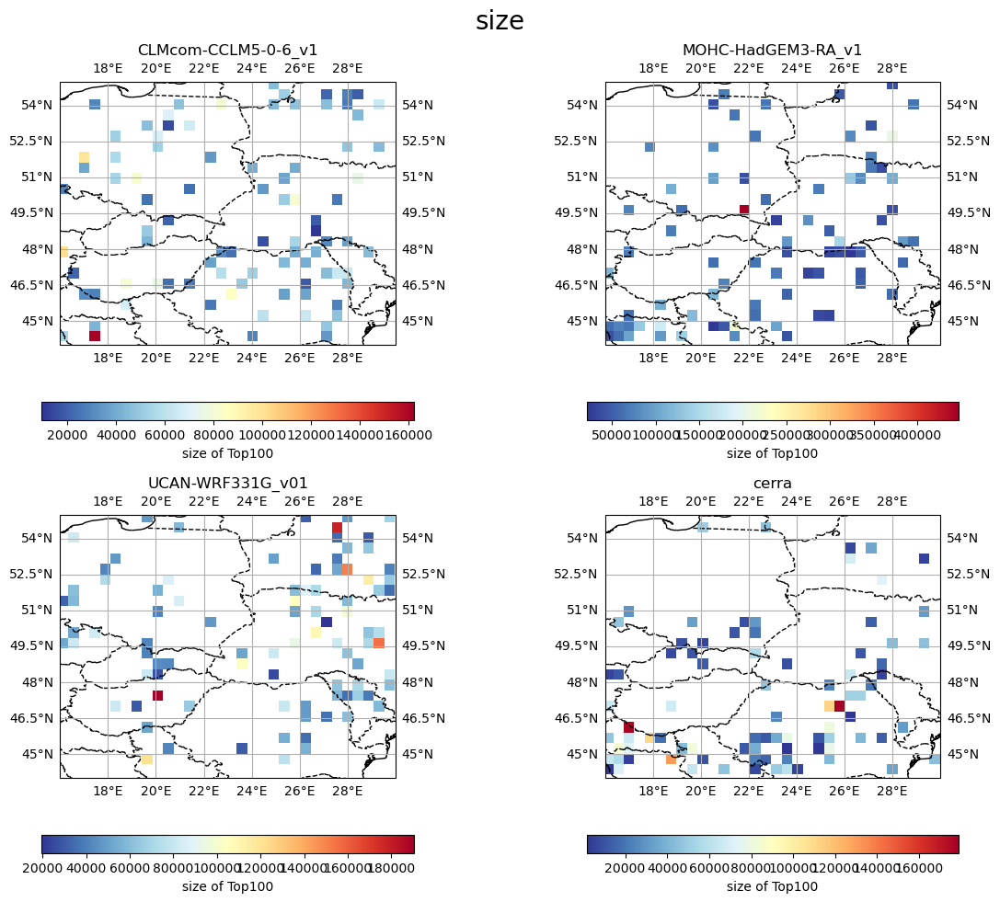

(4, 8, 5, 92, 187)
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CLMcom-ETH-COSMO-crCLIM-v1-1_v1_EUR-11.nc
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_MOHC-HadREM3-GA7-05_v1_EUR-11.nc
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_ICTP-RegCM4-6_v1_EUR-11.nc
/glade/campaign/mmm/c3we/mingge/FRONTIERS/PAPER/obj_Top100Character_CERRA_EUR-44.nc
max
---------


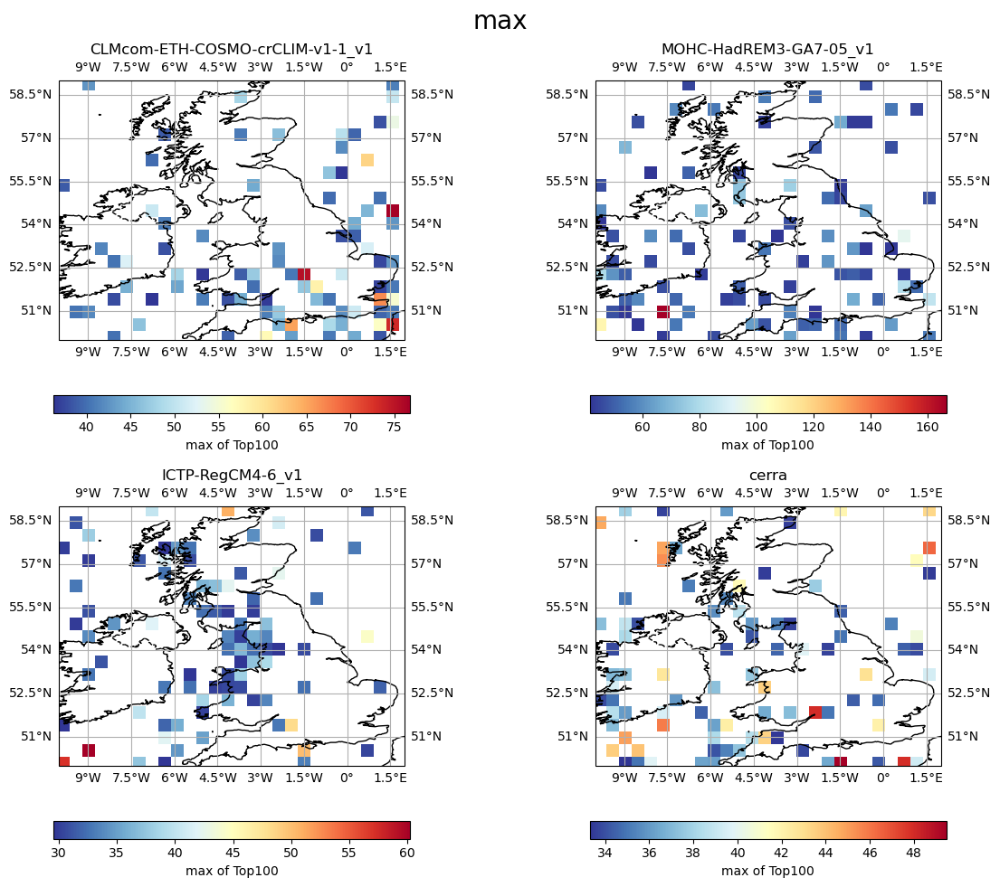

min
---------


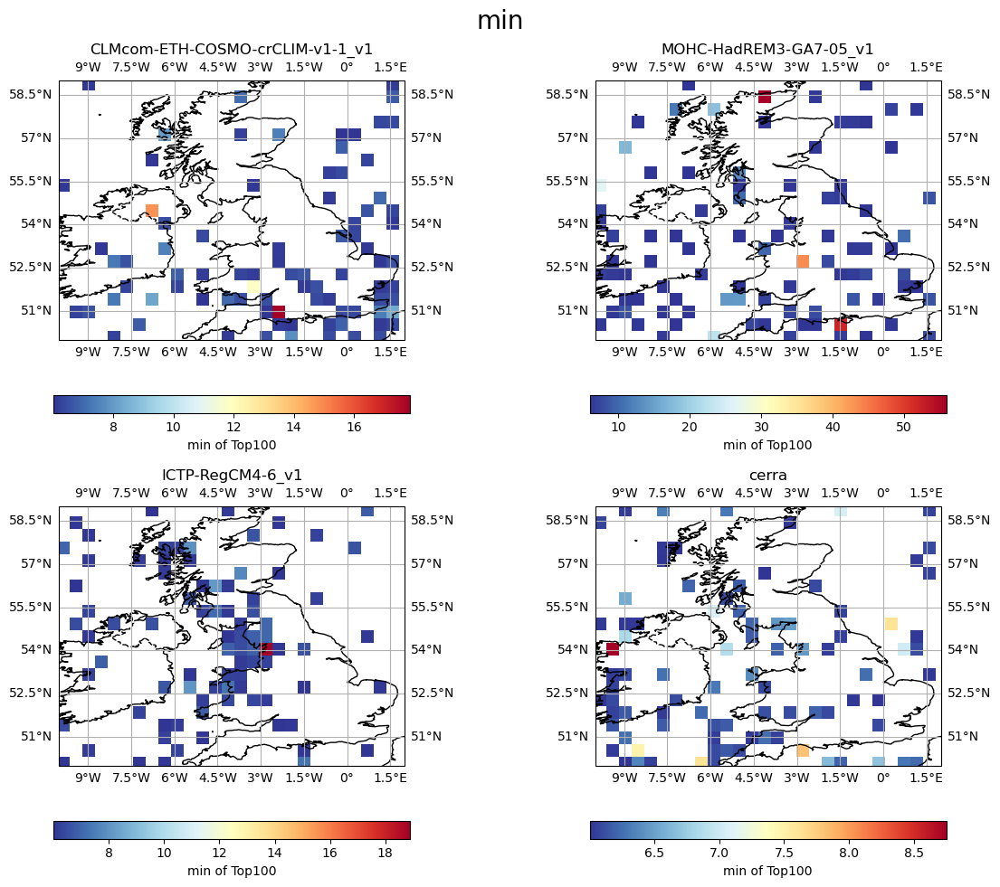

mean
---------


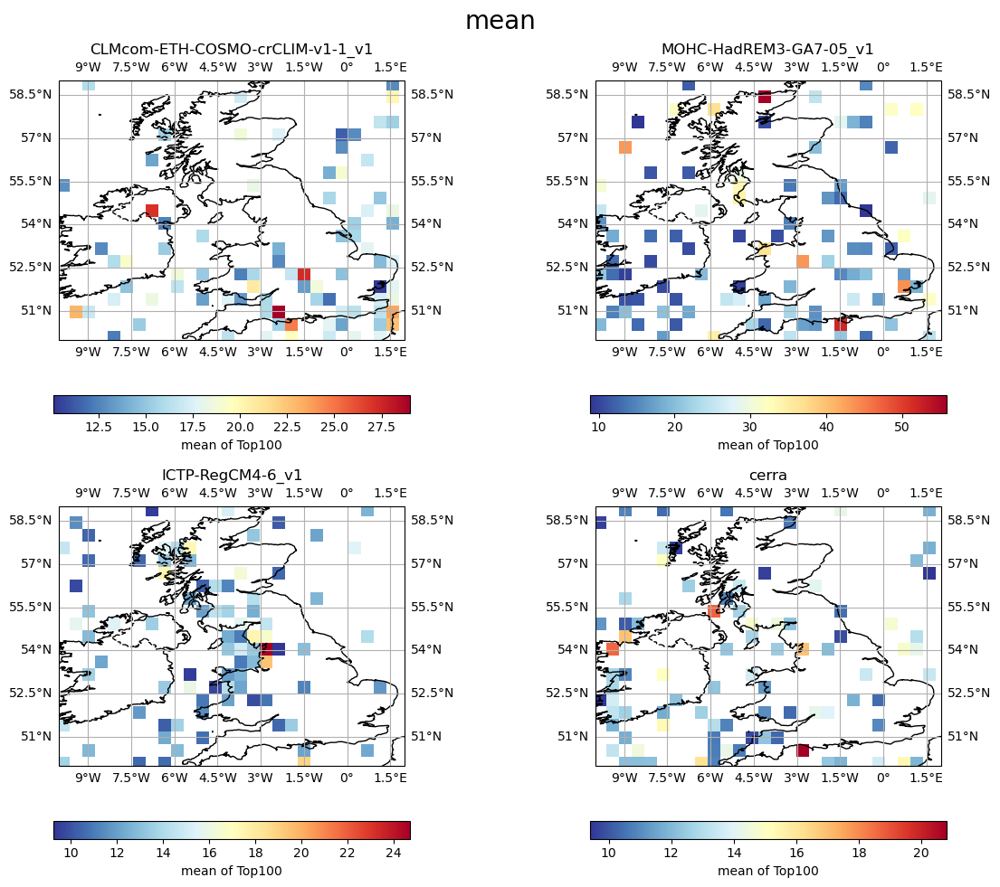

tot
---------


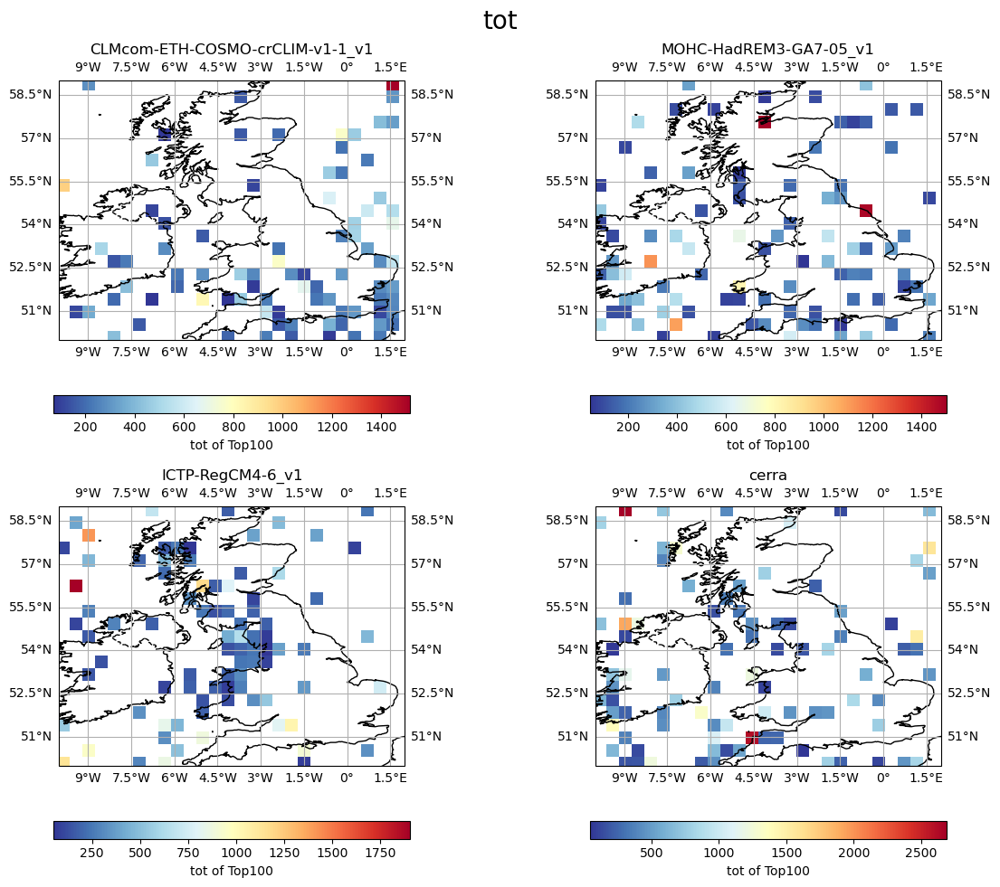

size
---------


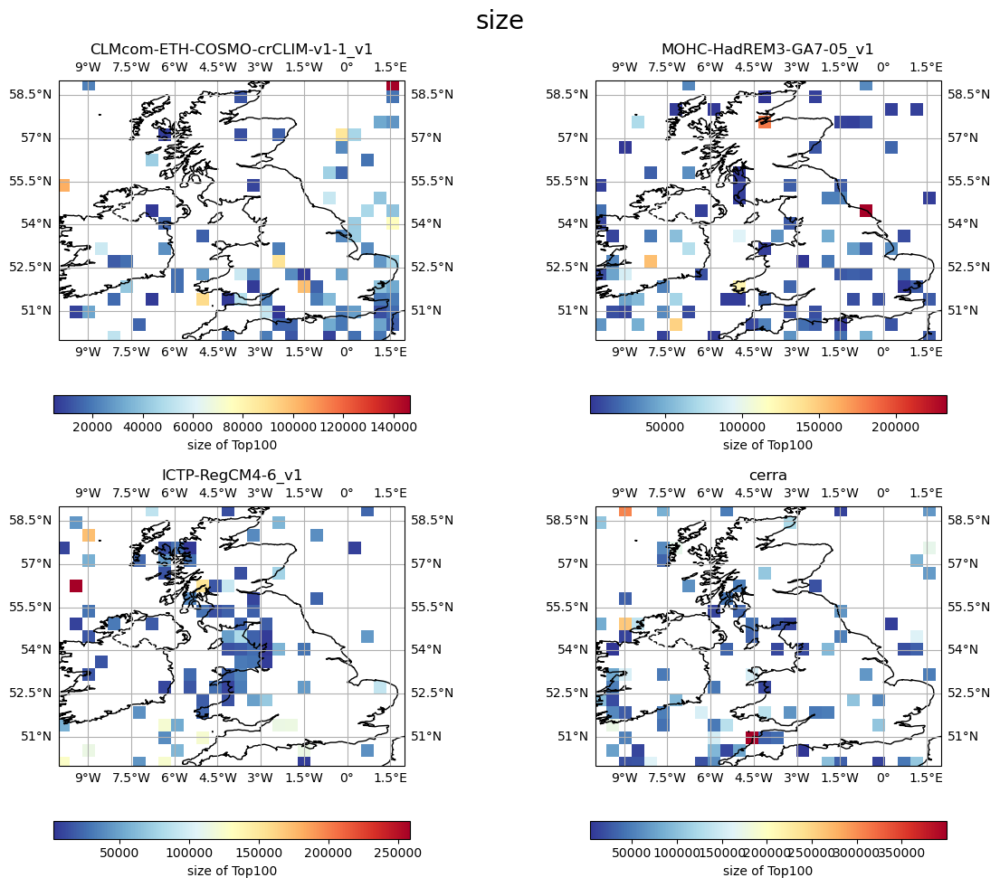

max
---------


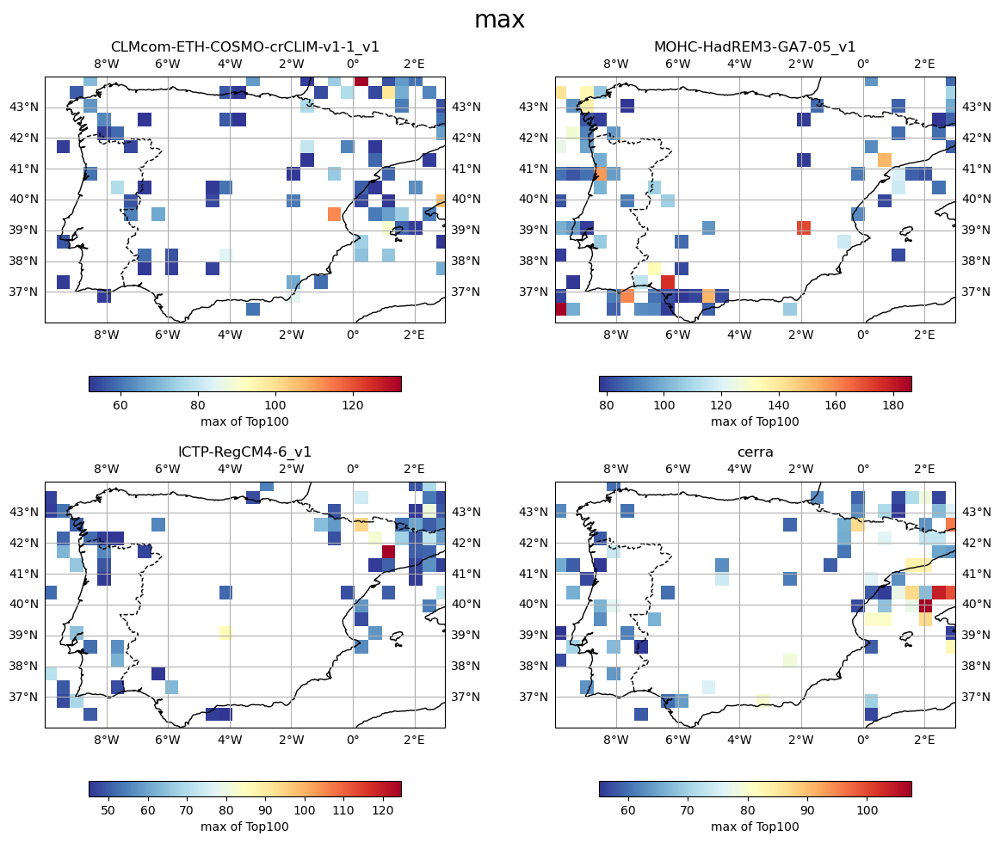

min
---------


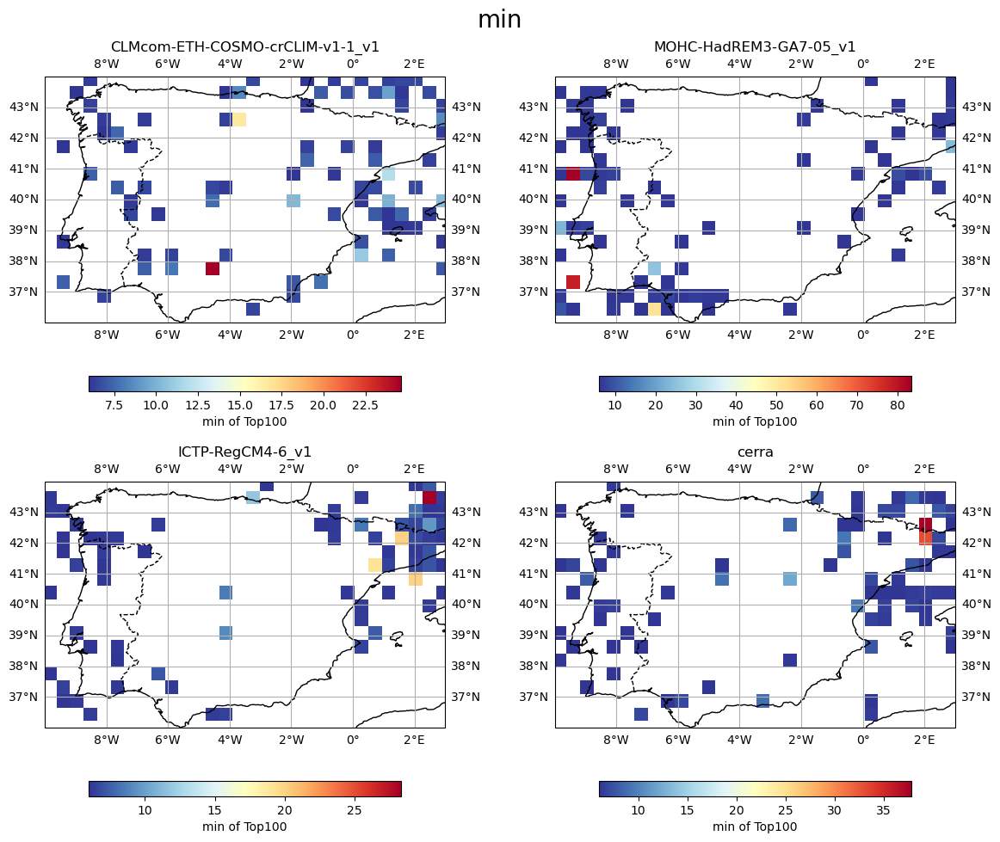

mean
---------


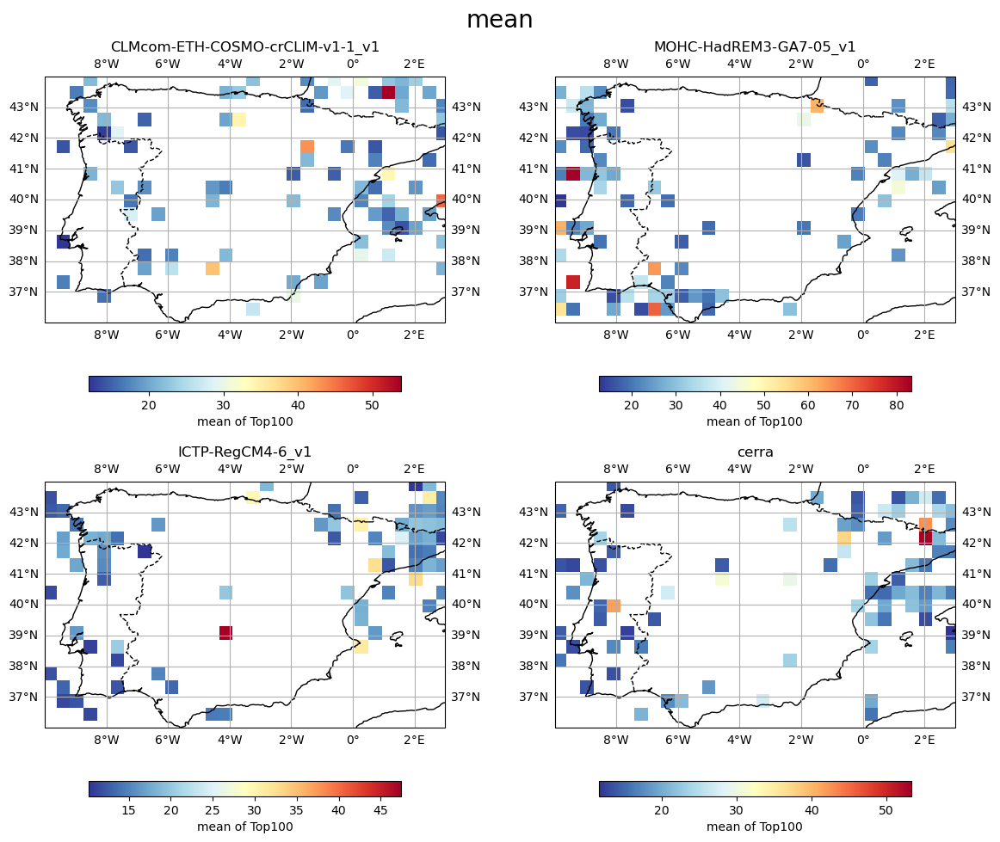

tot
---------


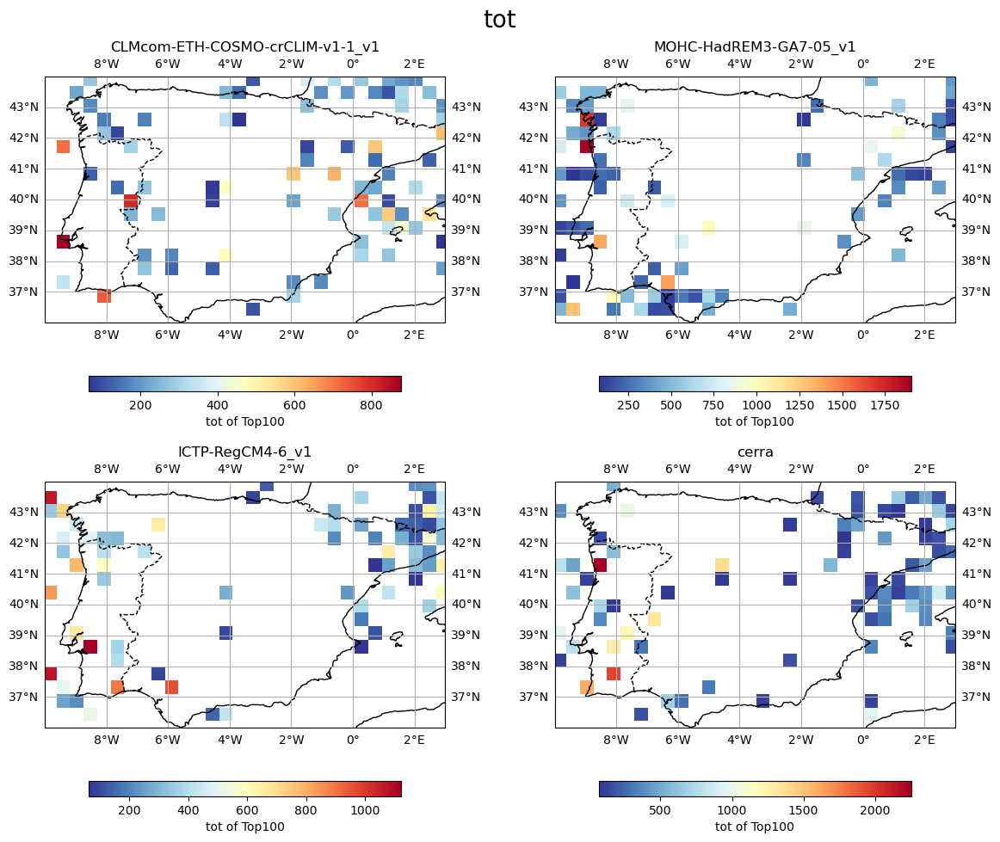

size
---------


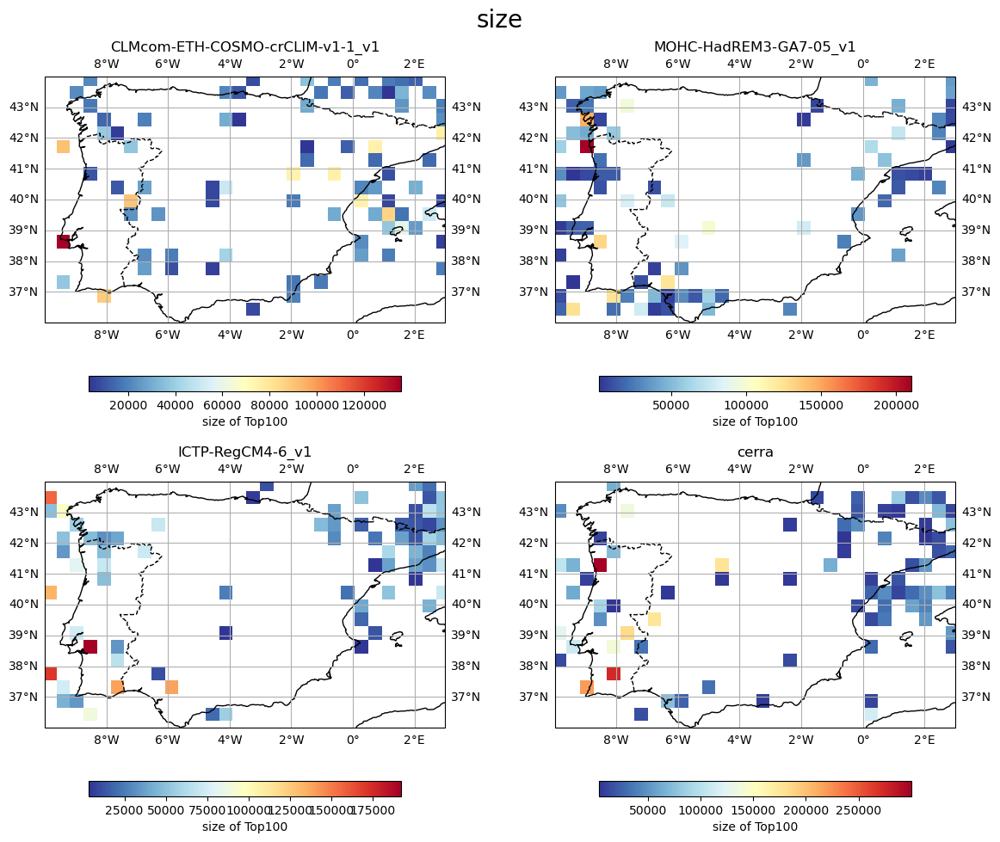

max
---------


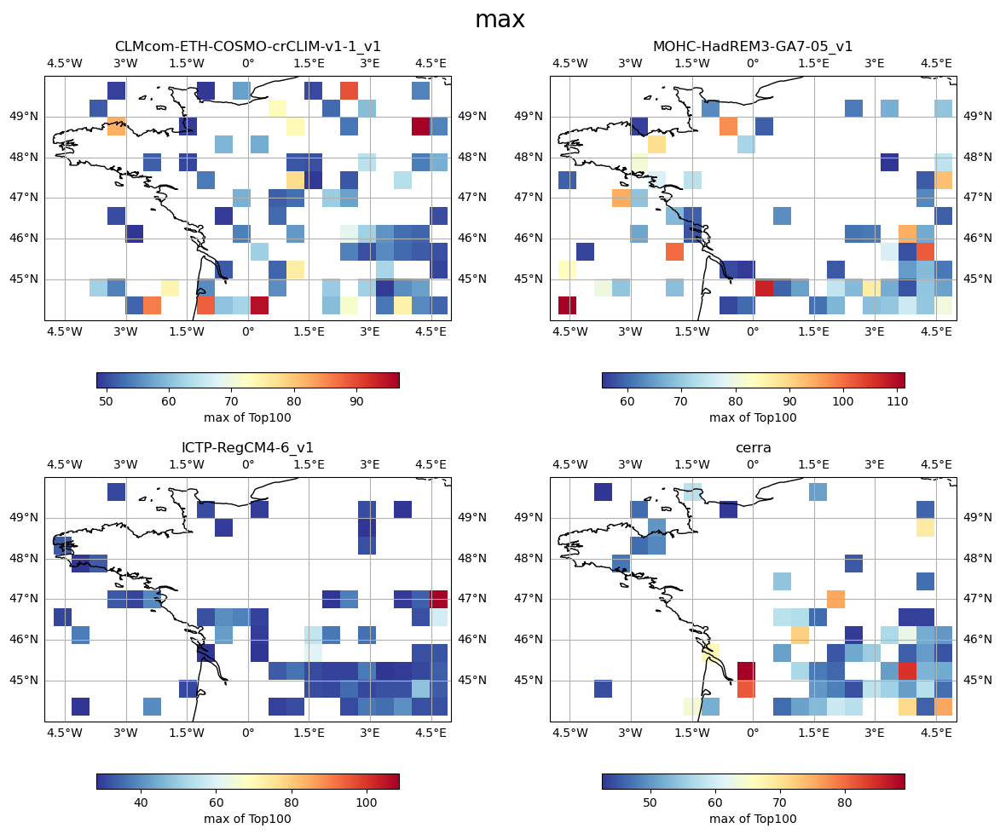

min
---------


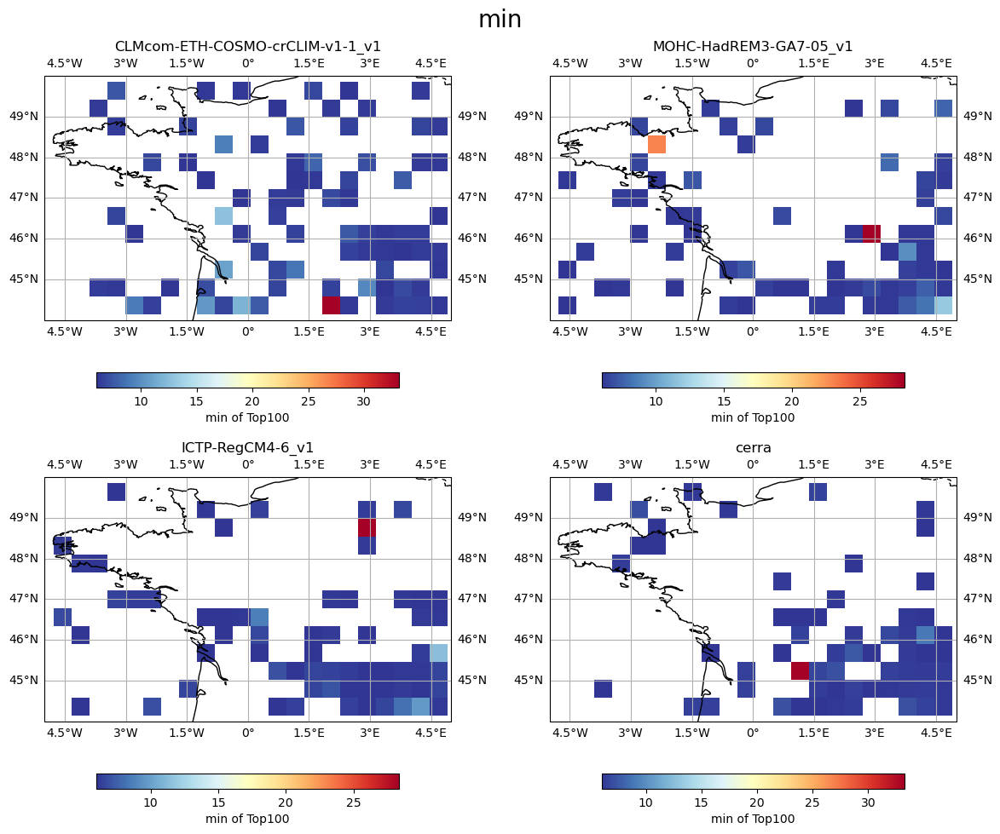

mean
---------


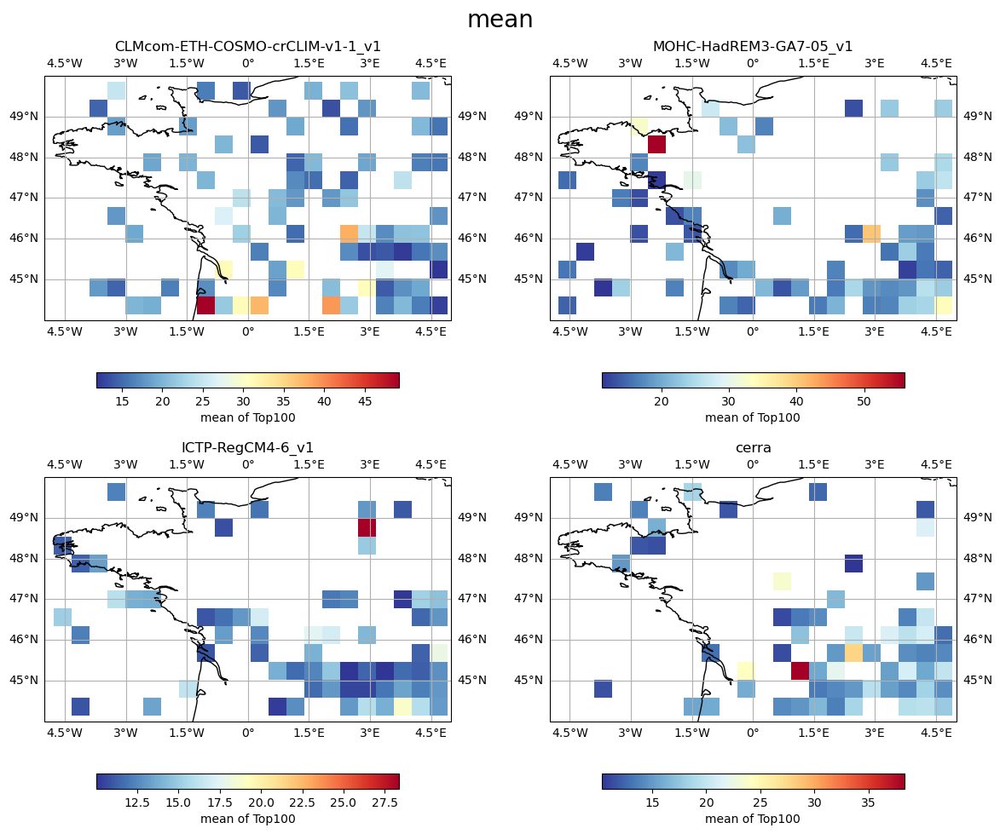

tot
---------


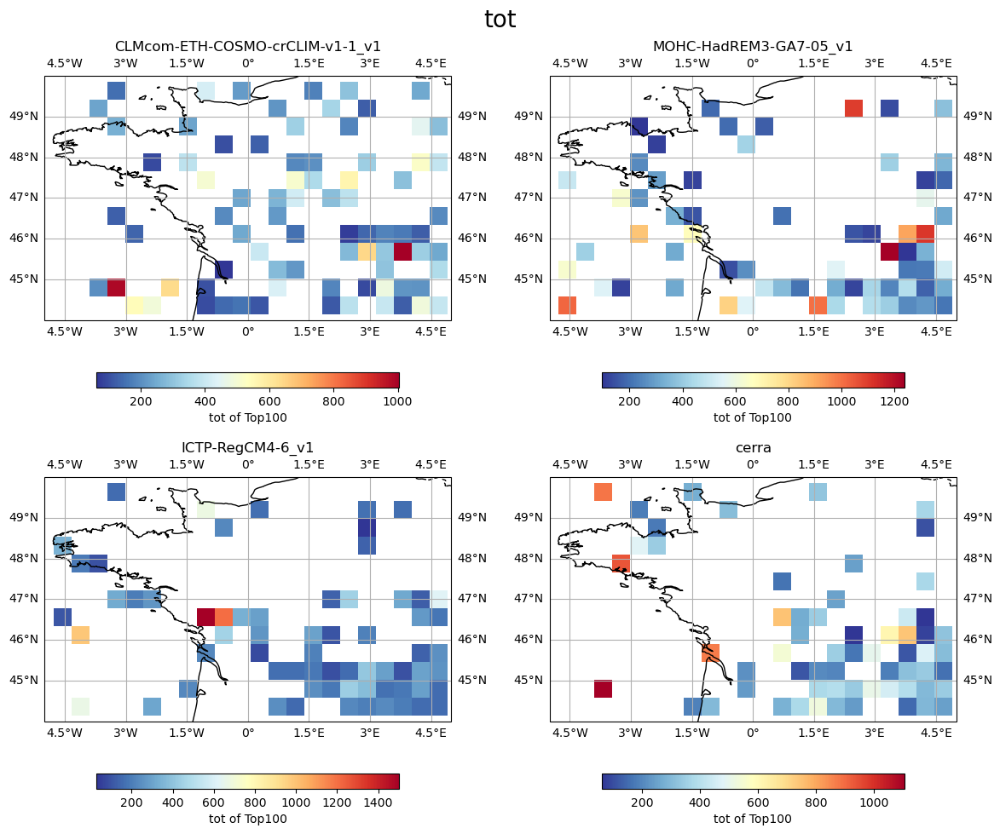

size
---------


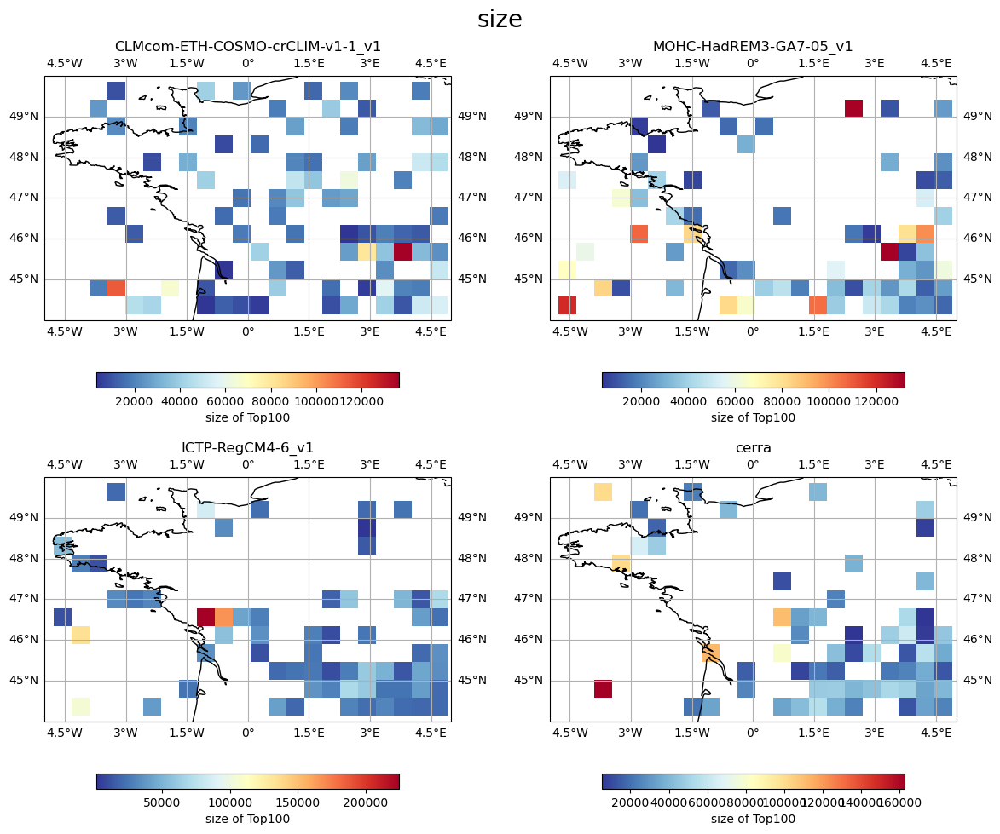

max
---------


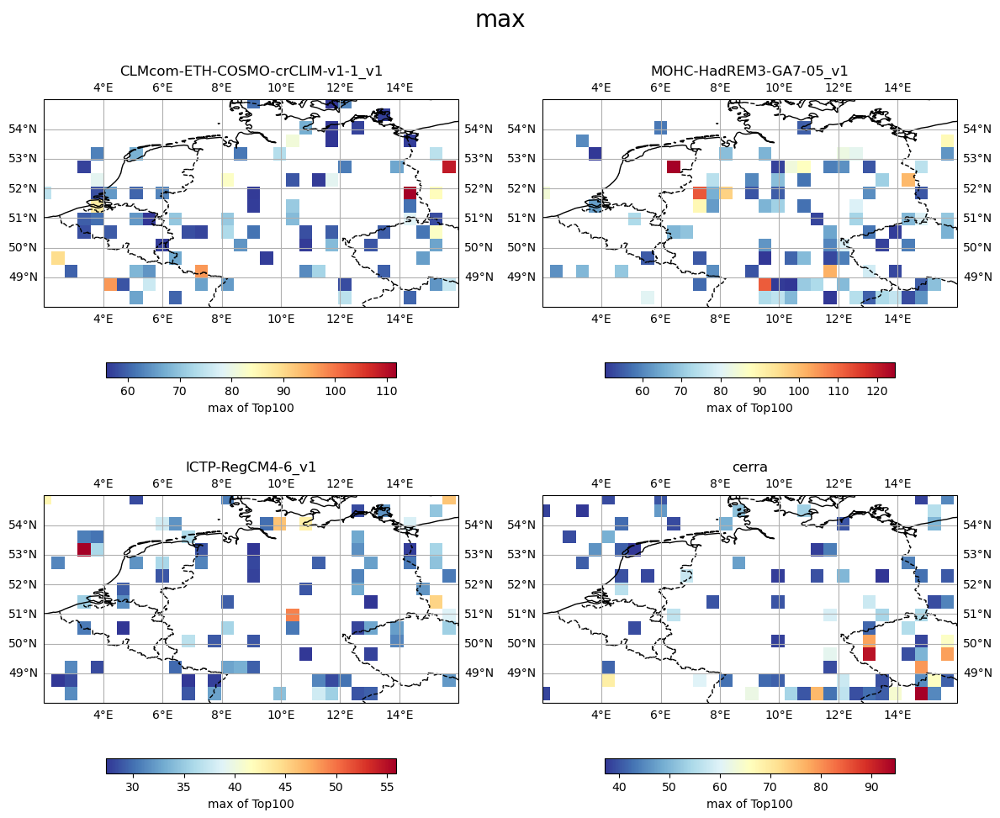

min
---------


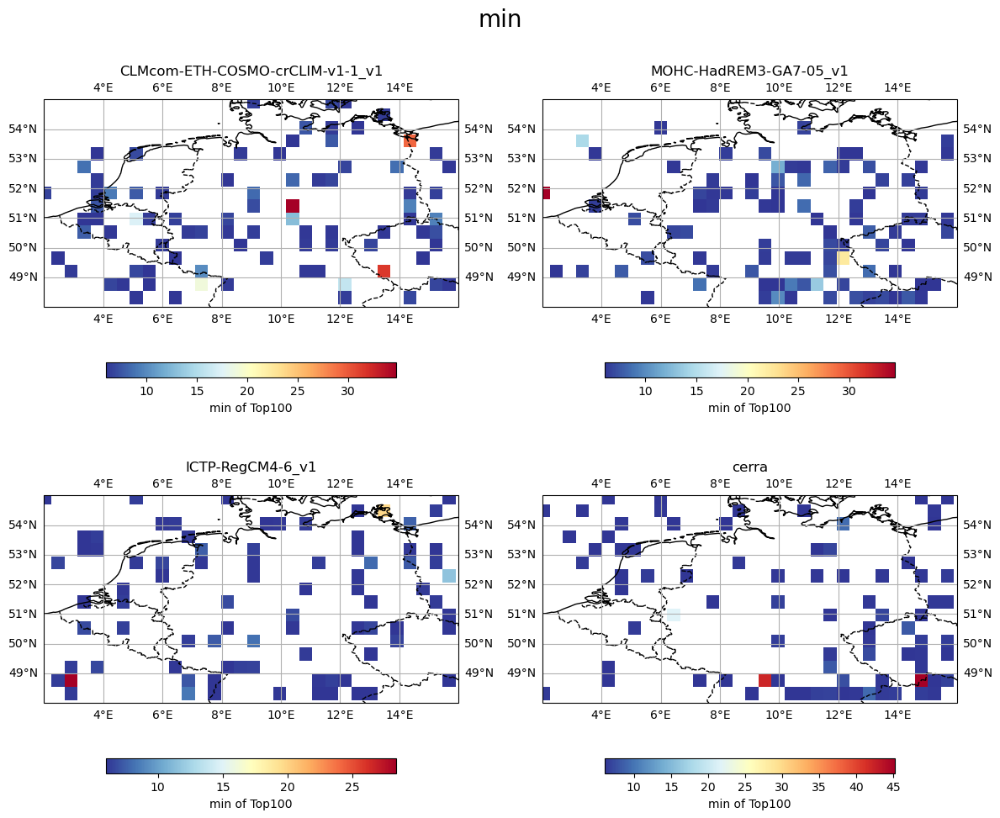

mean
---------


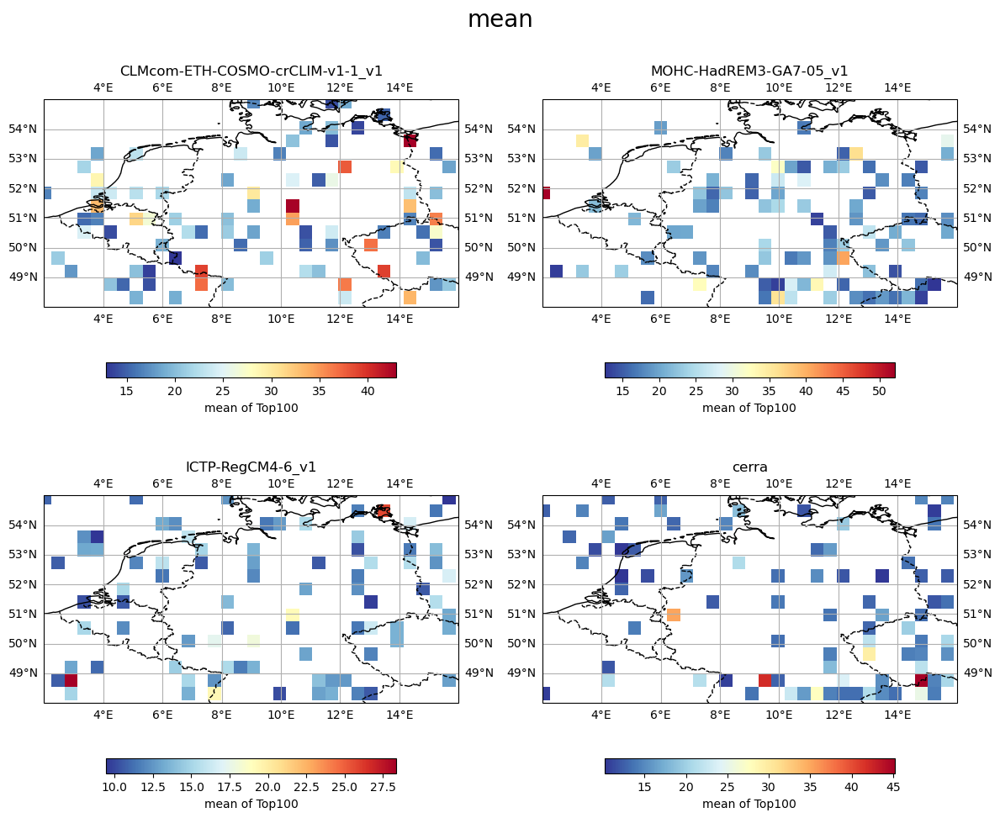

tot
---------


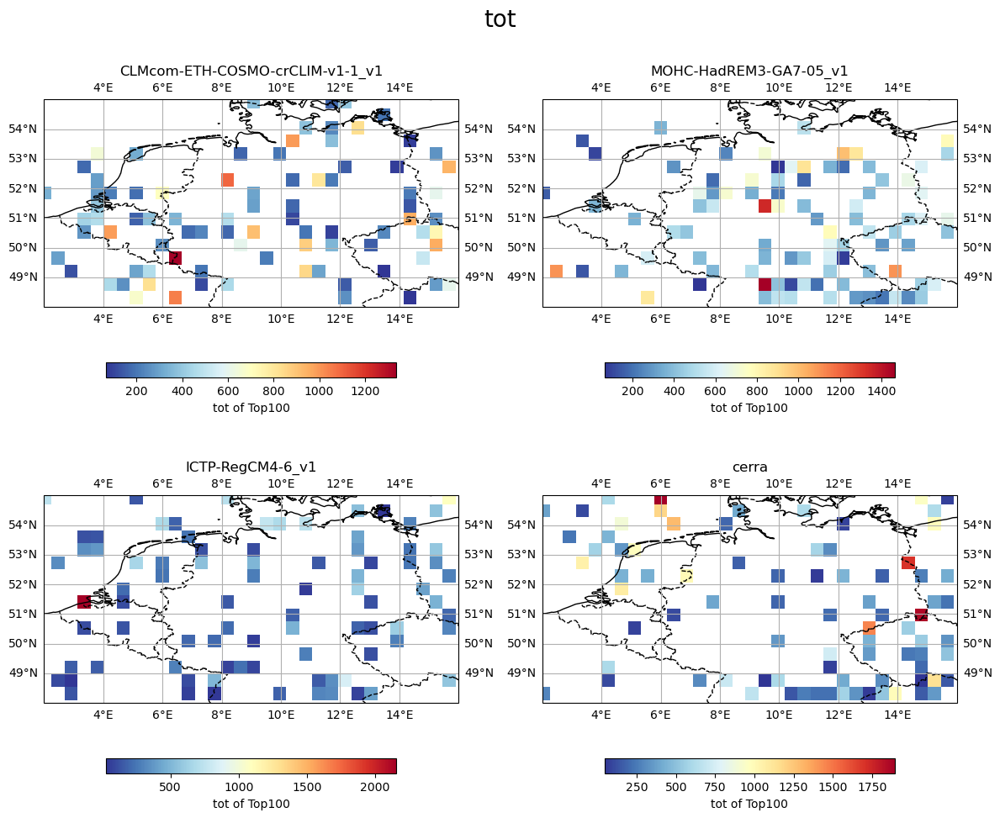

size
---------


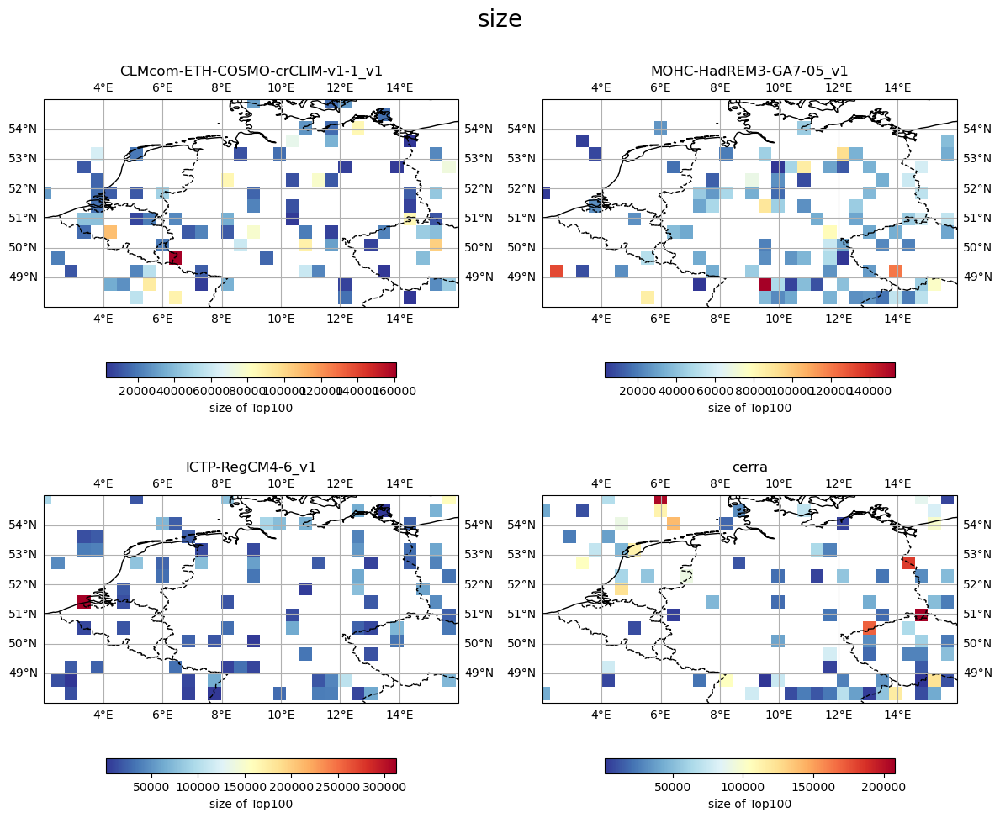

max
---------


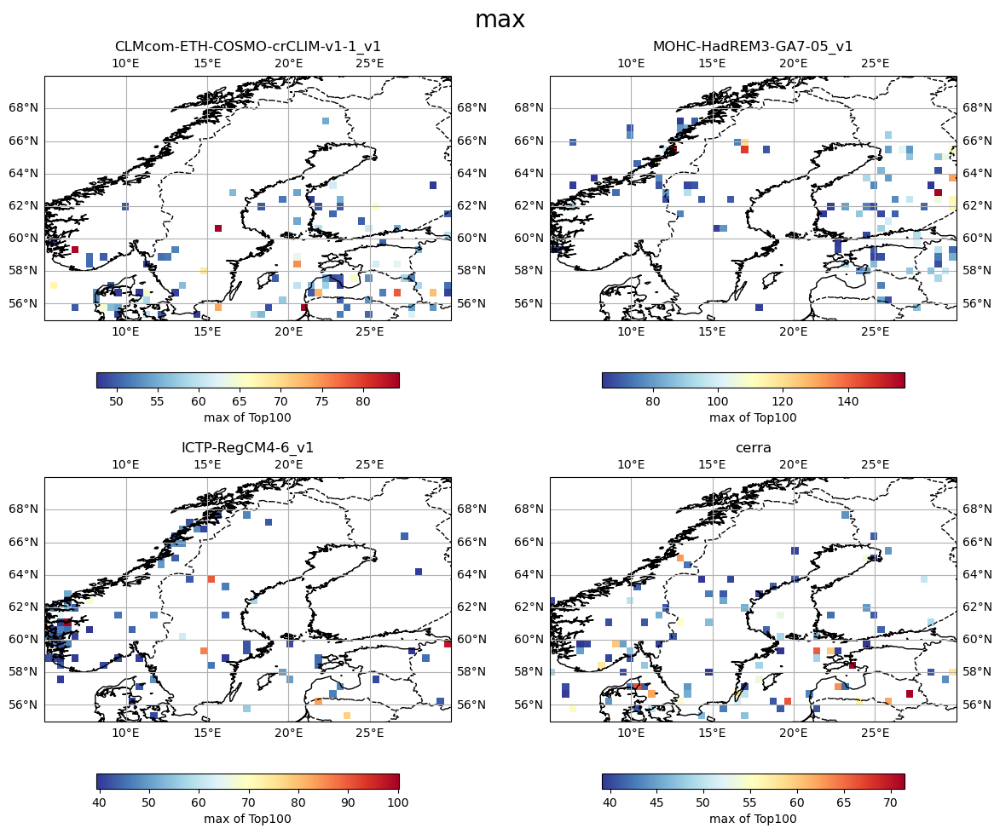

min
---------


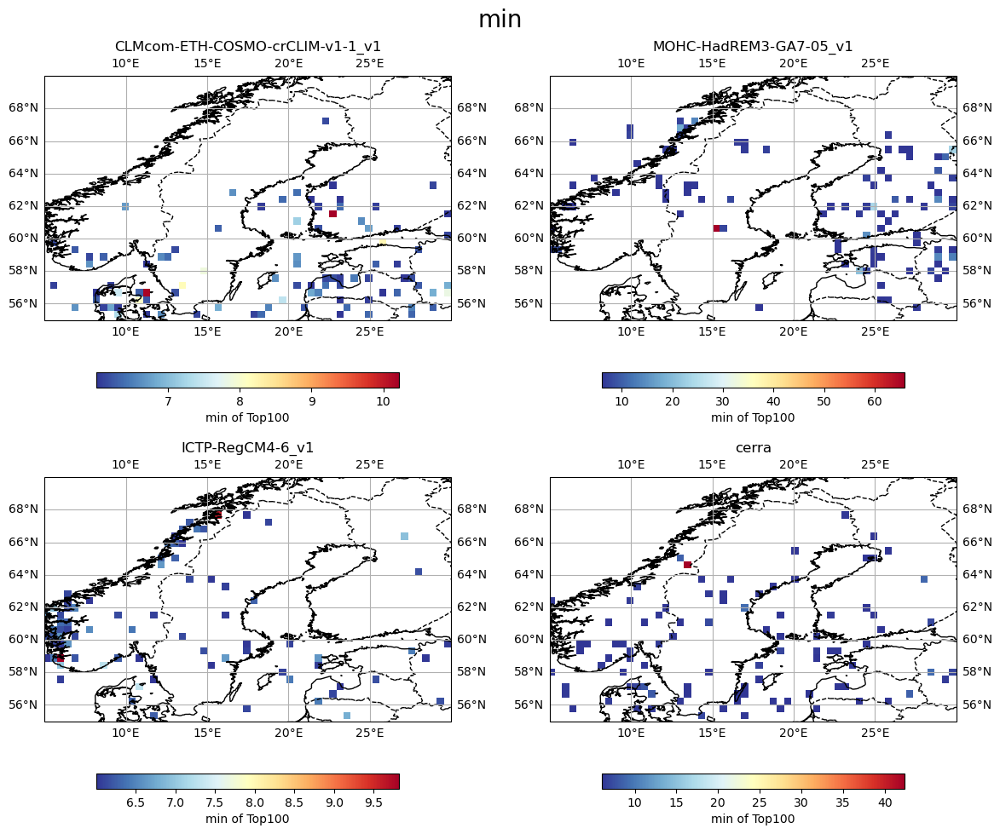

mean
---------


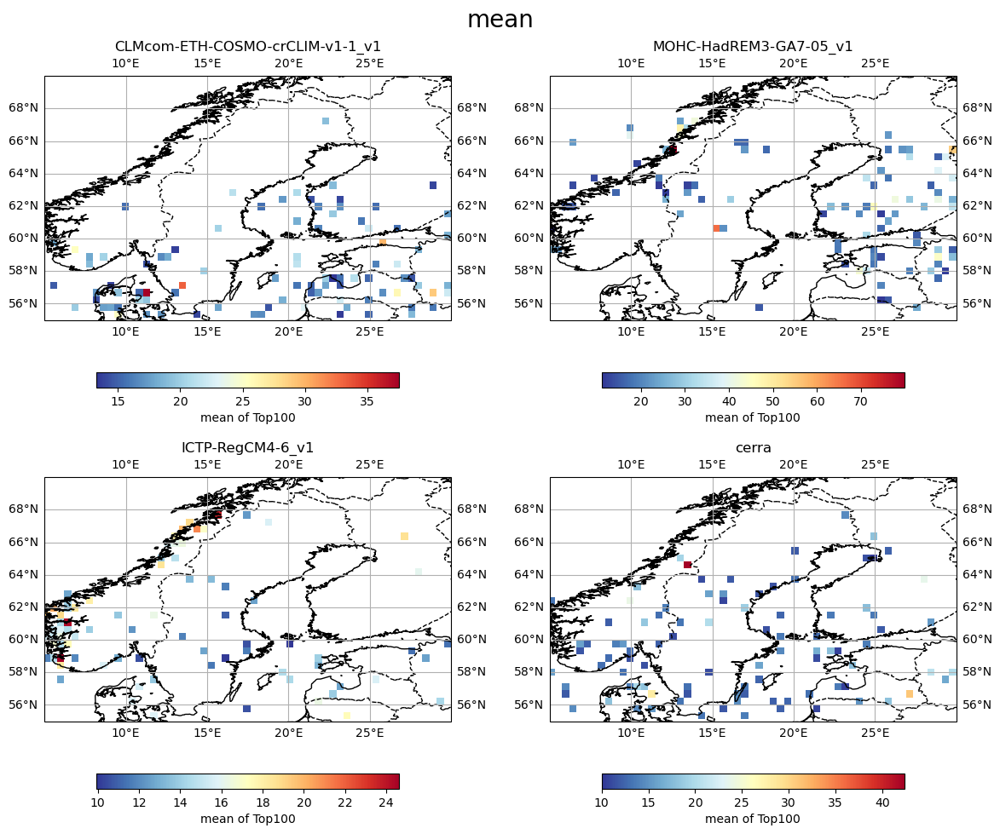

tot
---------


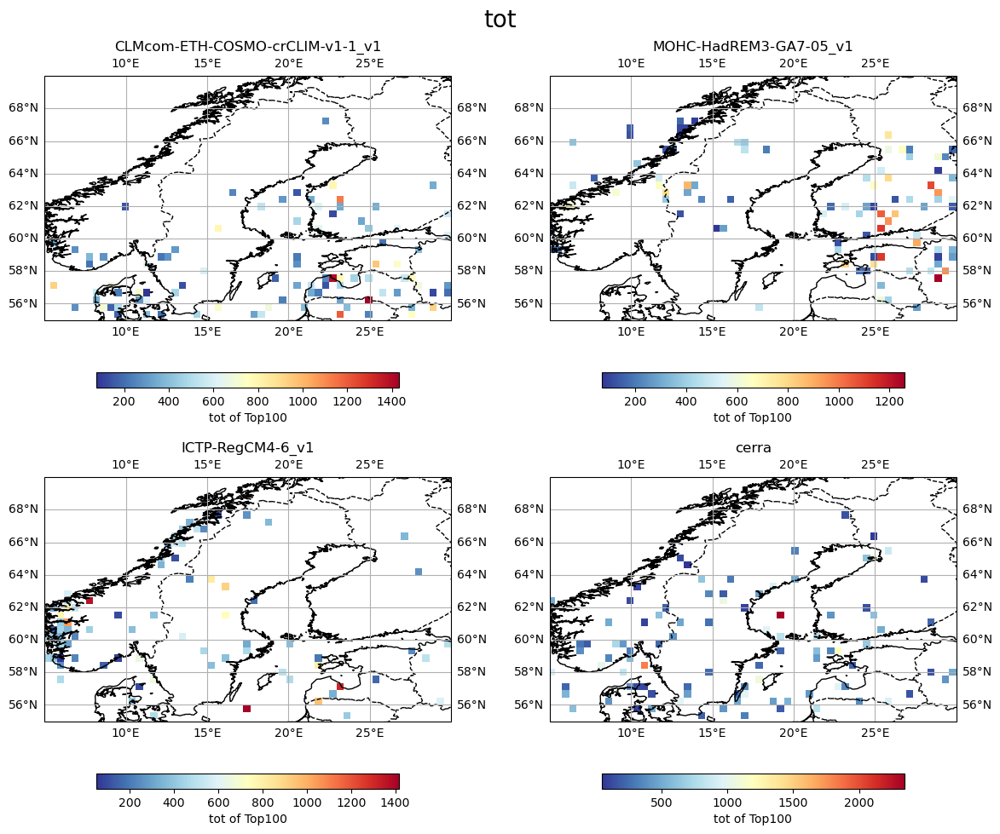

size
---------


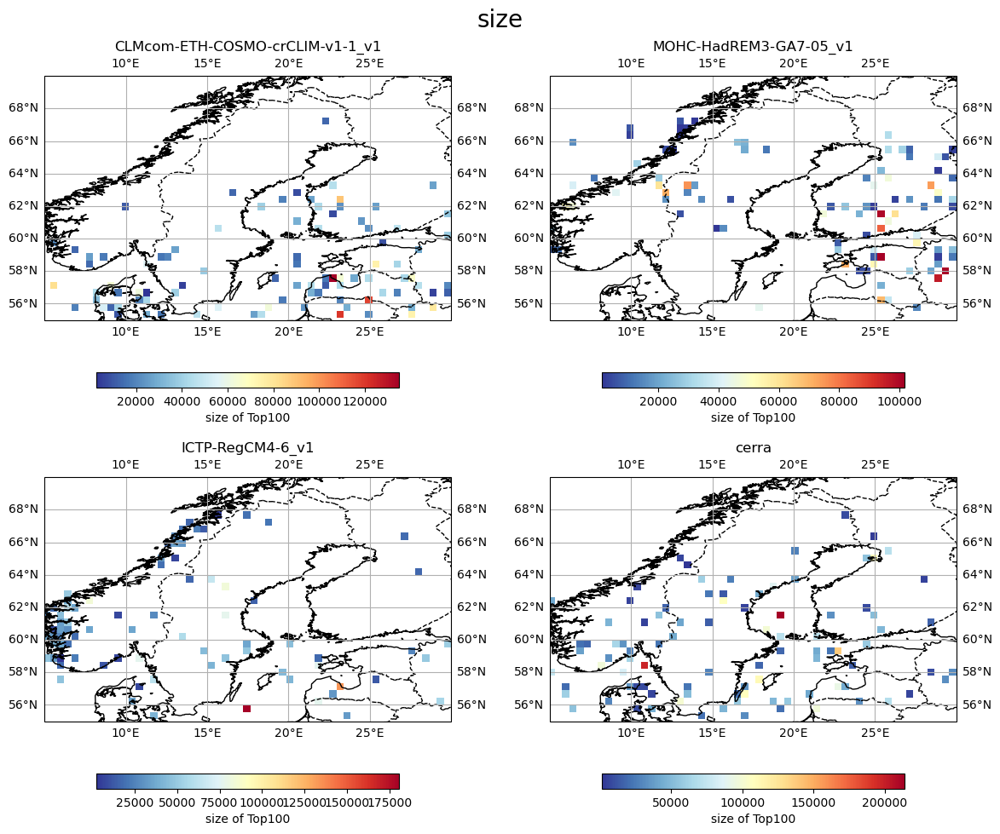

max
---------


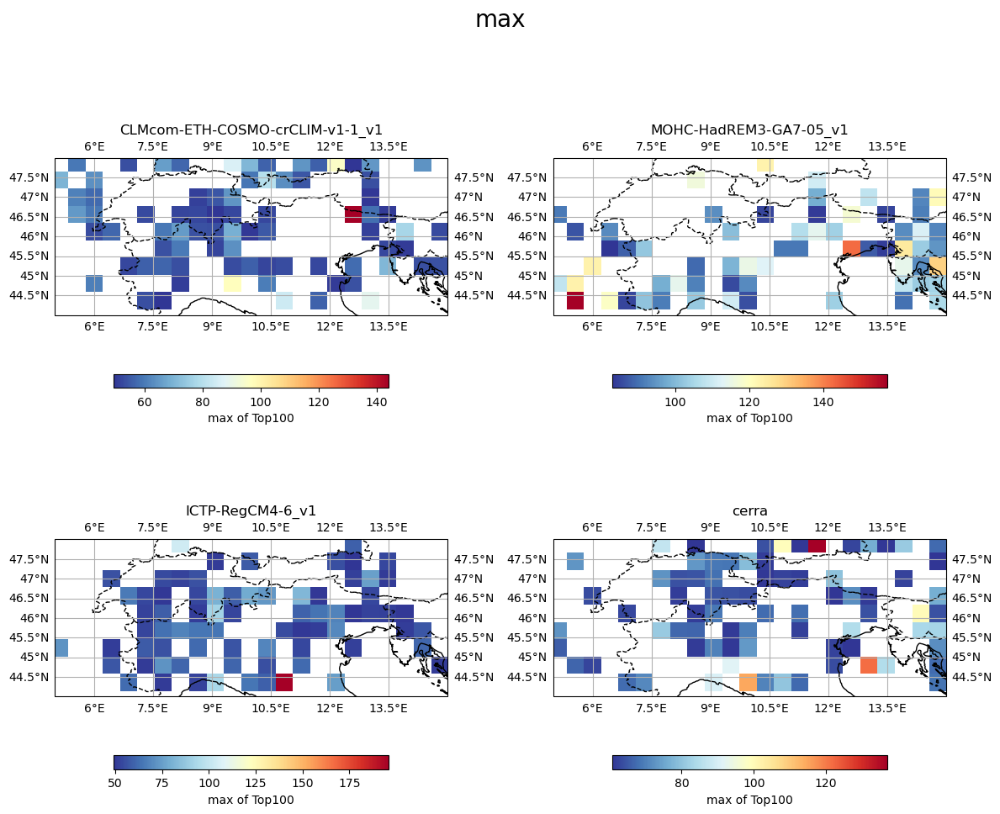

min
---------


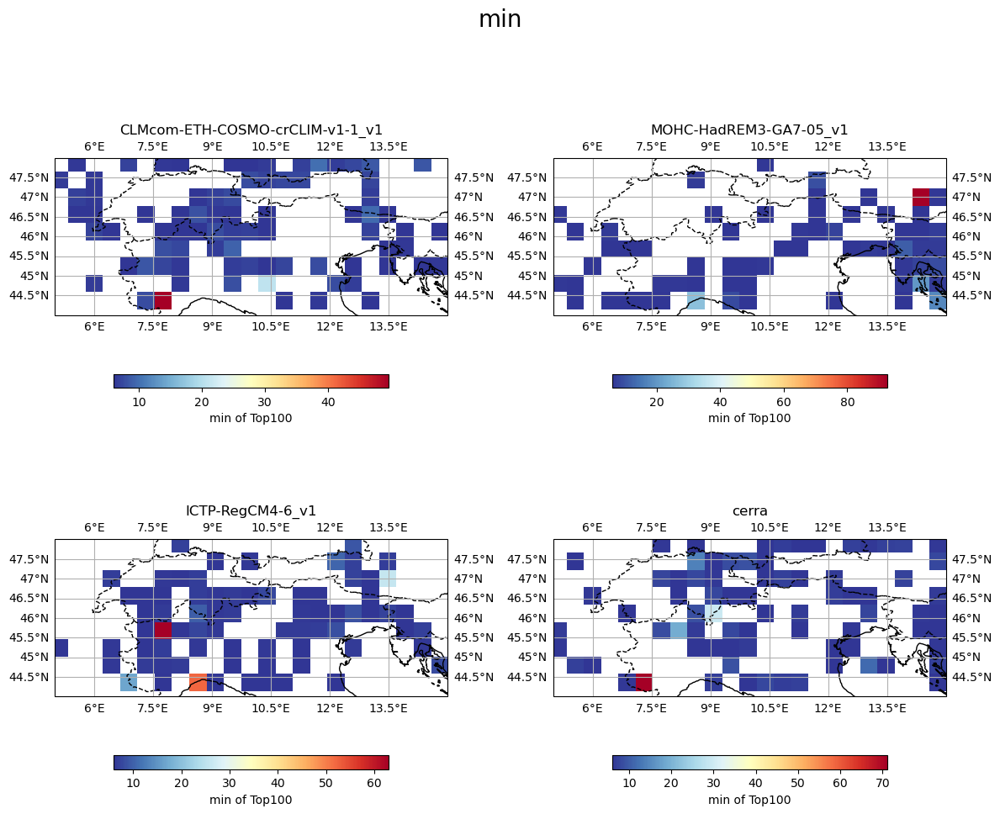

mean
---------


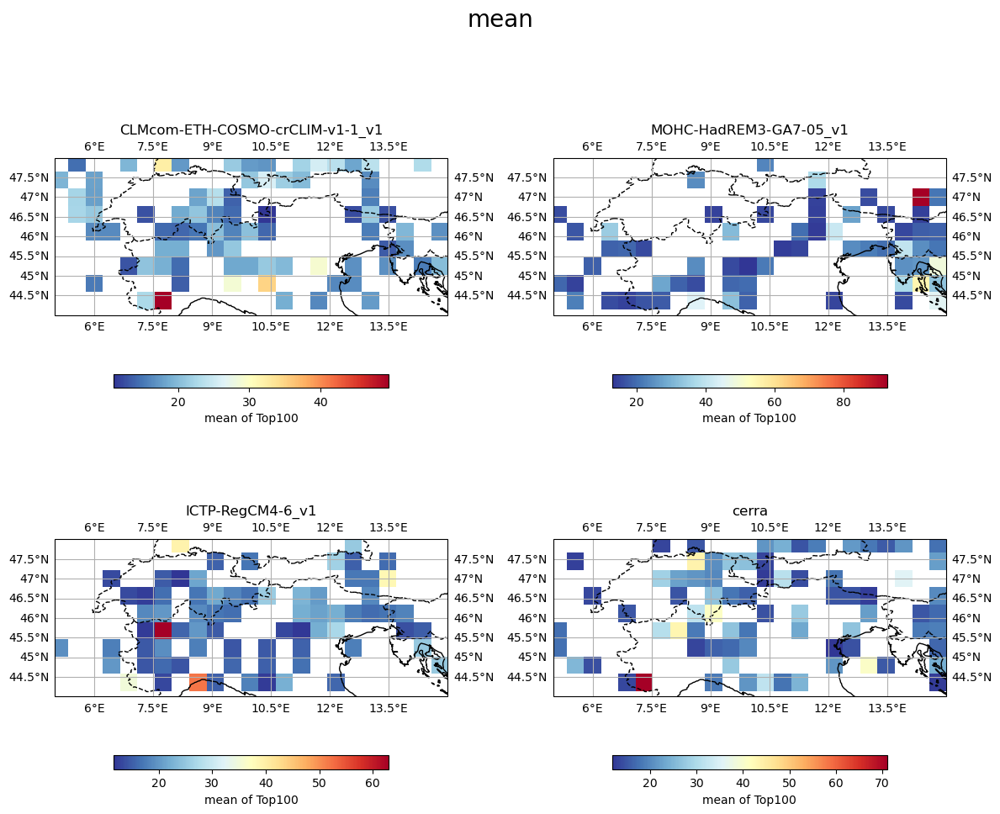

tot
---------


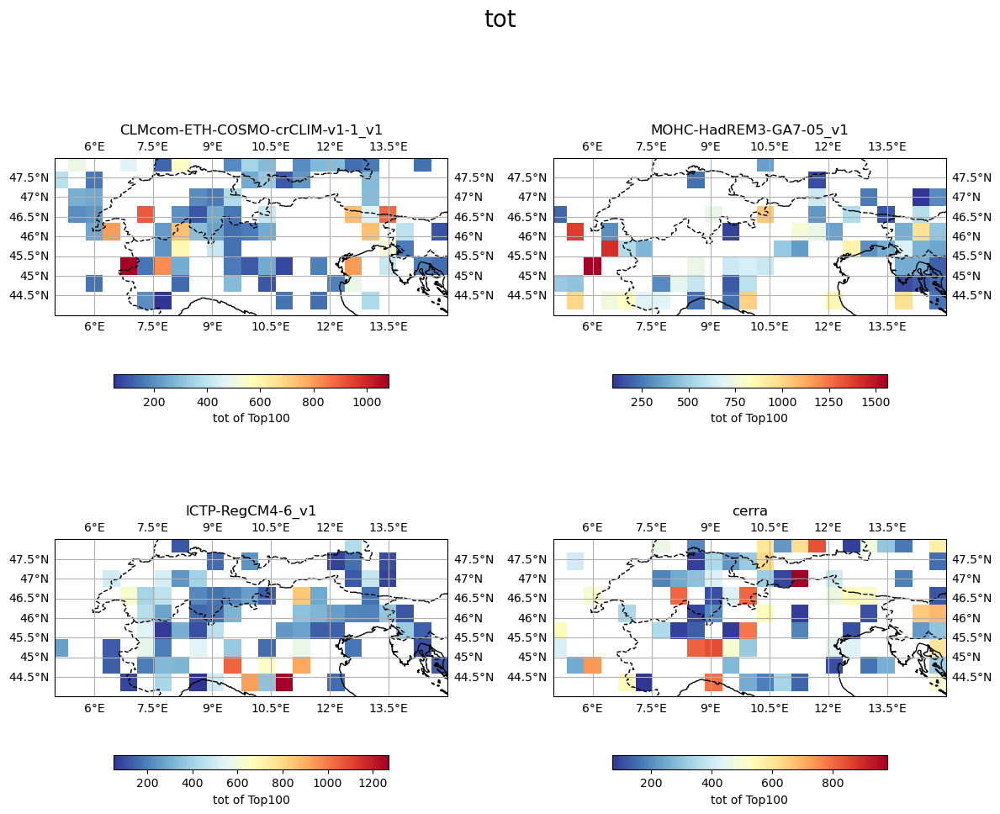

size
---------


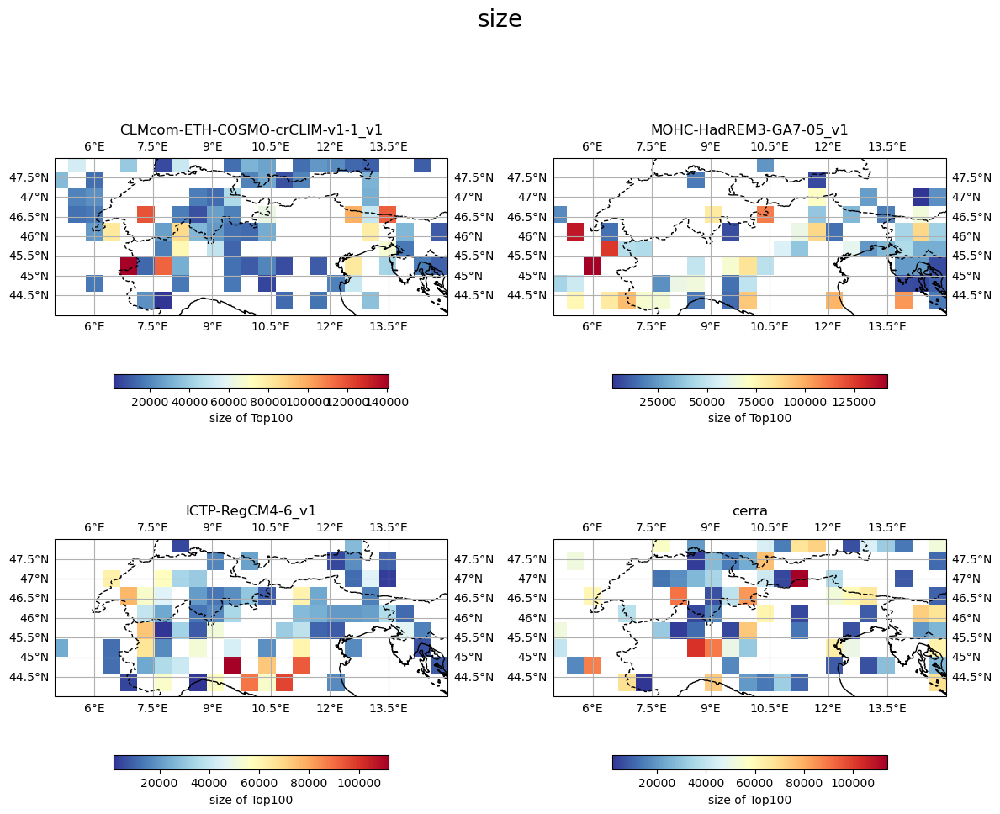

max
---------


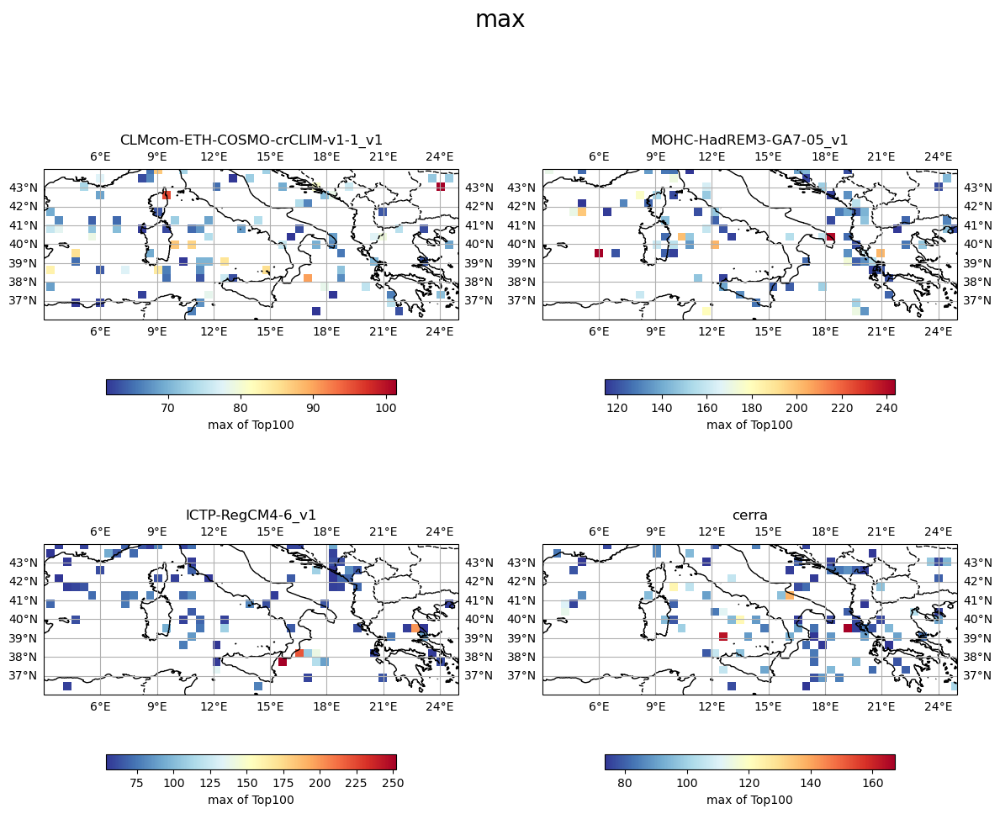

min
---------


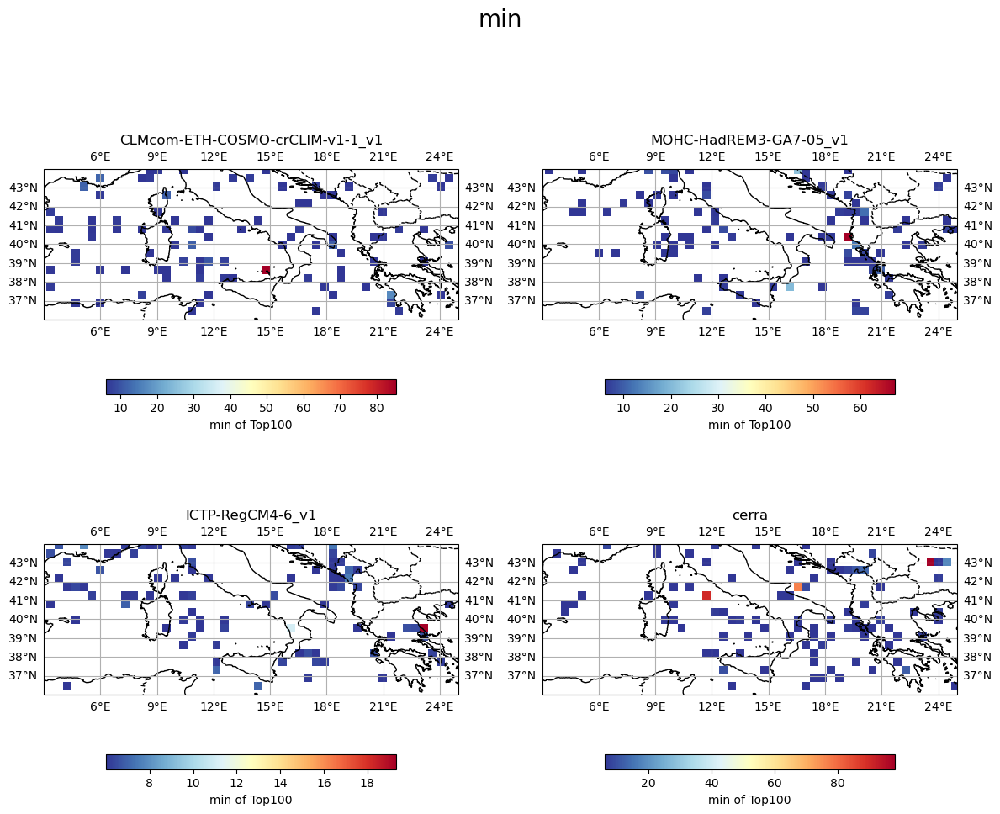

mean
---------


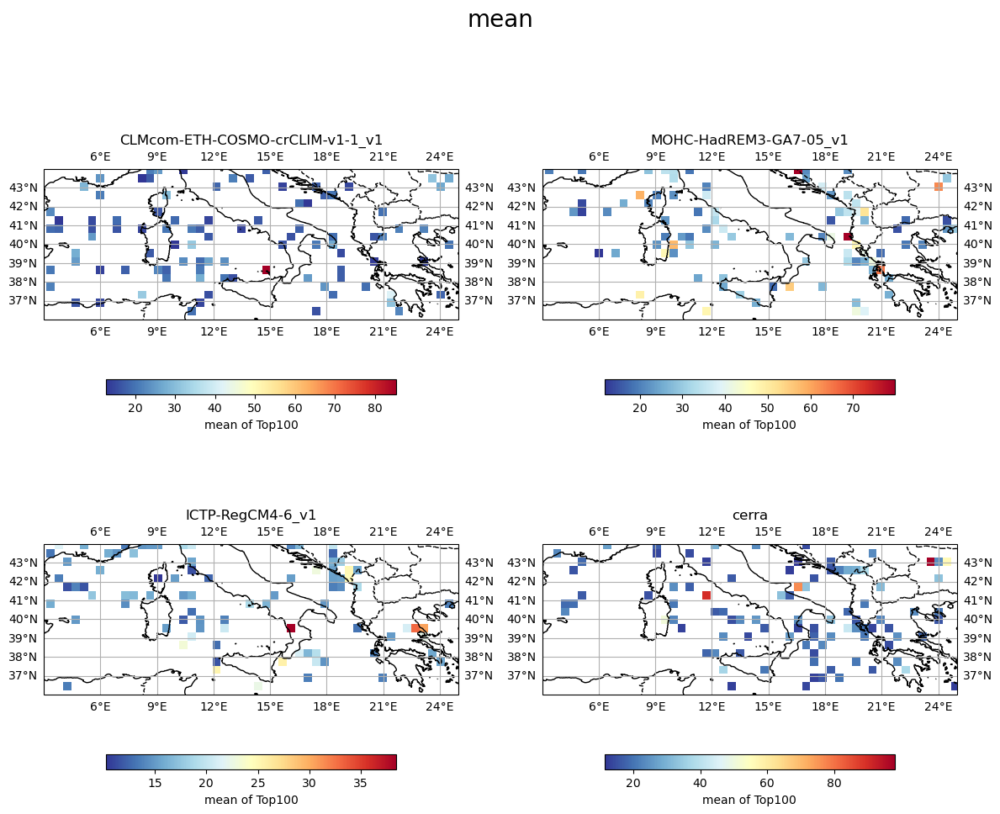

tot
---------


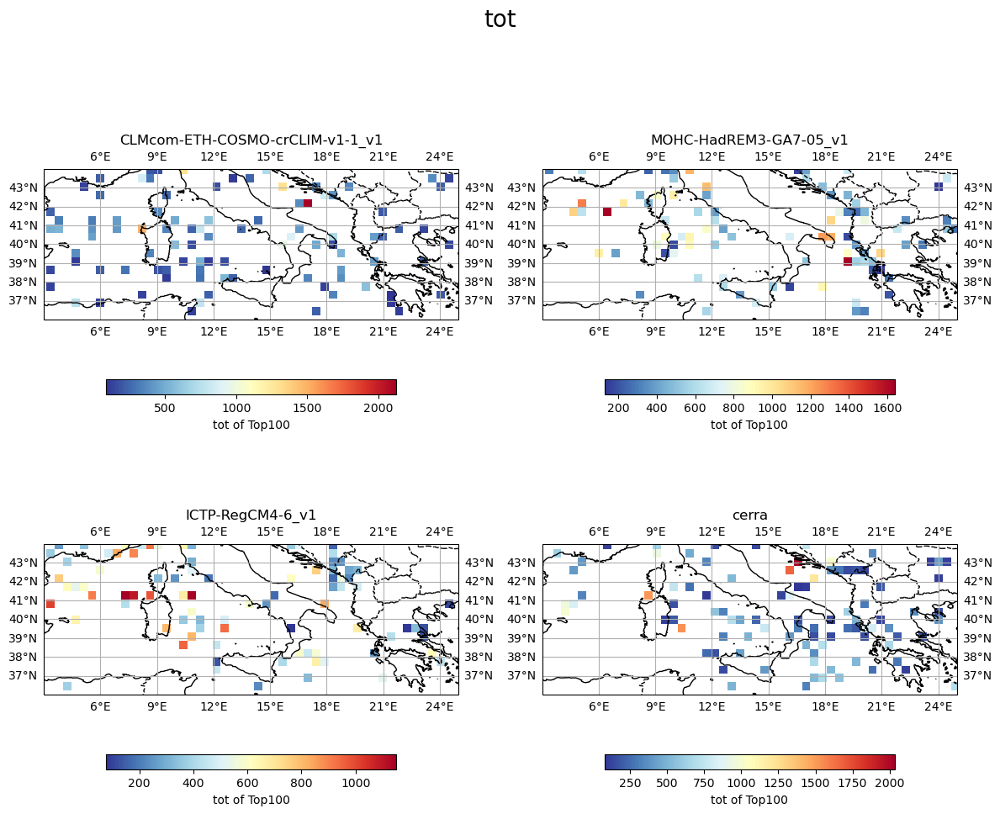

size
---------


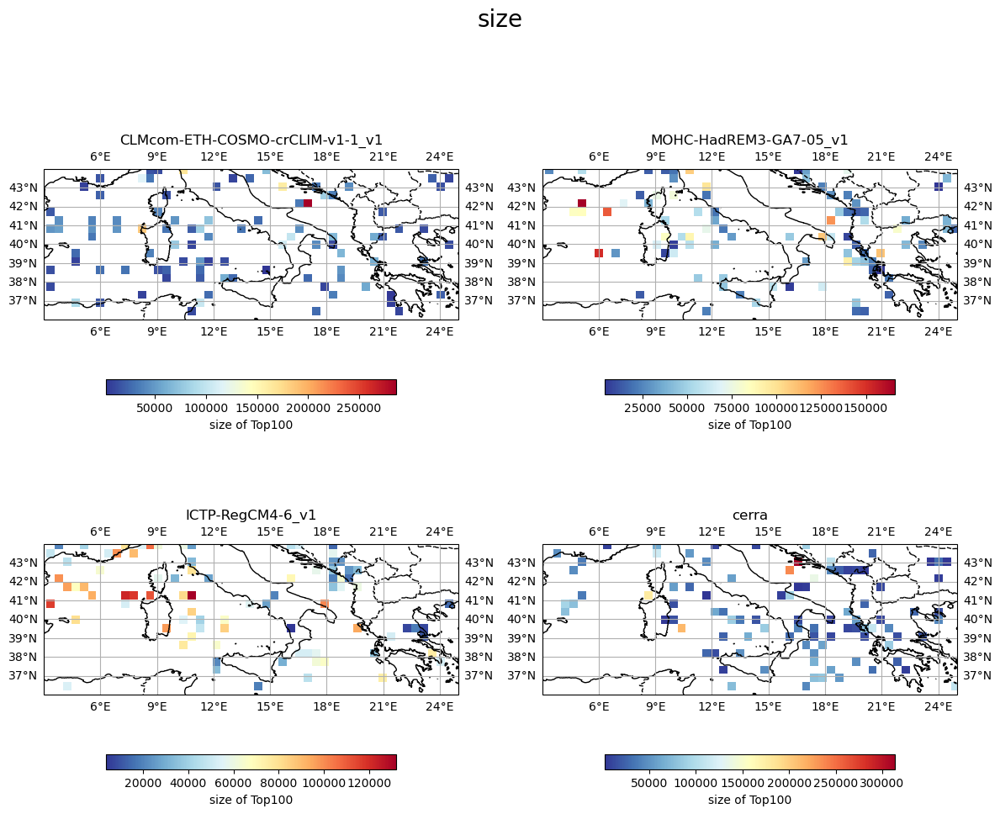

max
---------


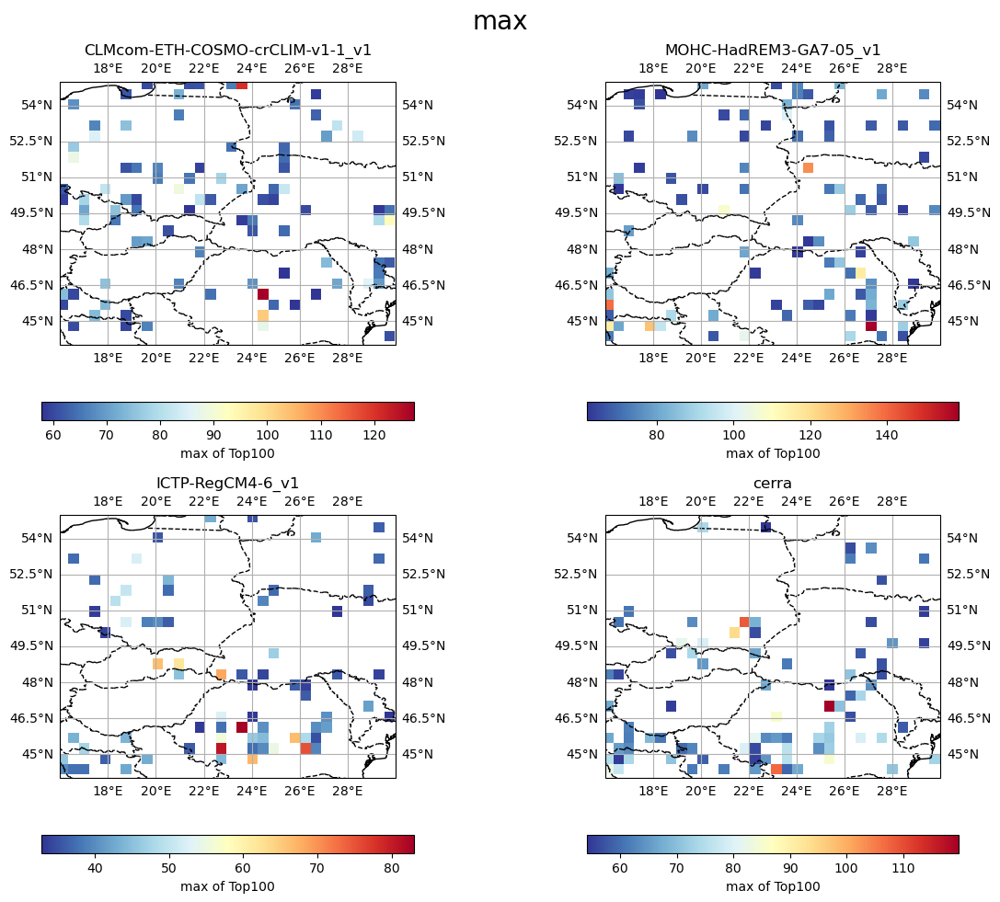

min
---------


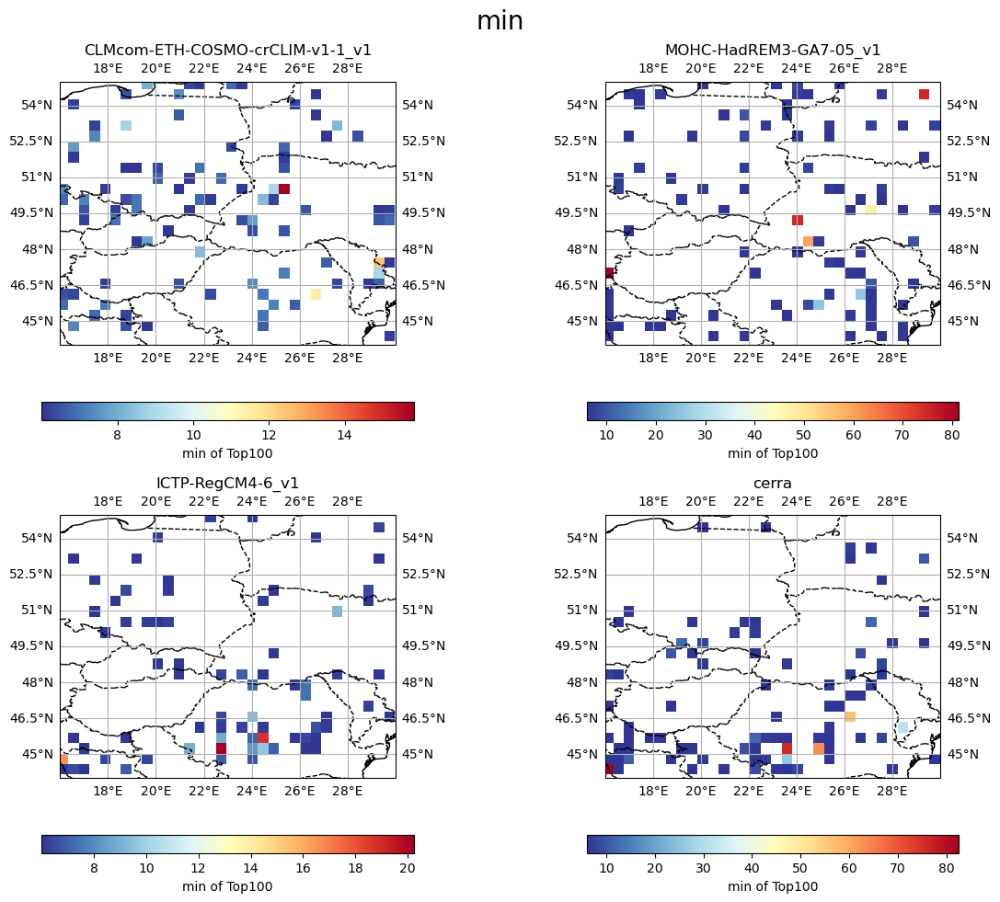

mean
---------


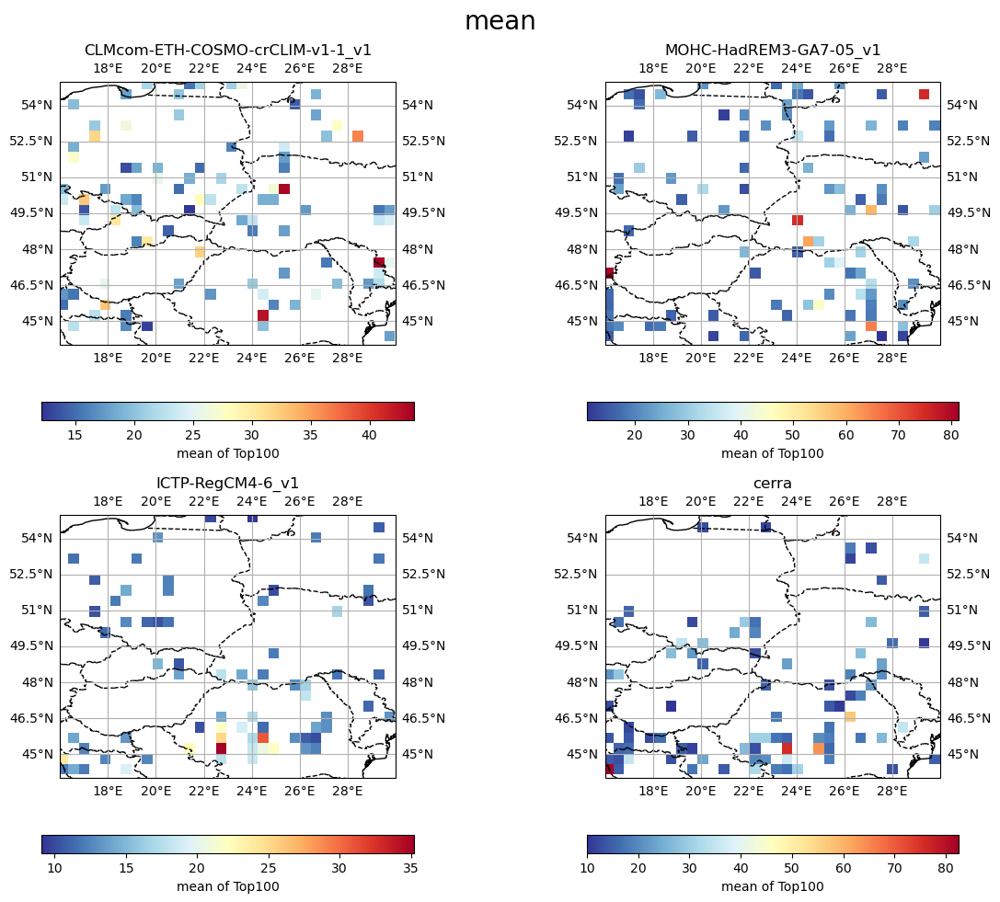

tot
---------


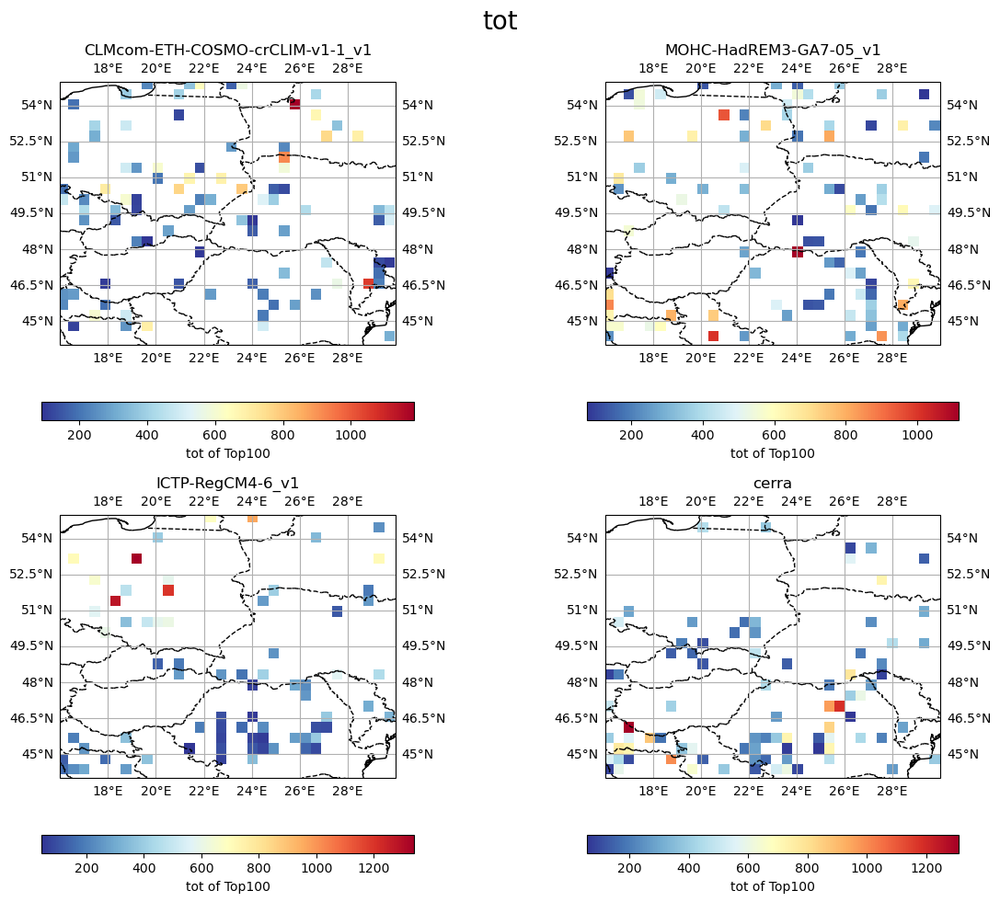

size
---------


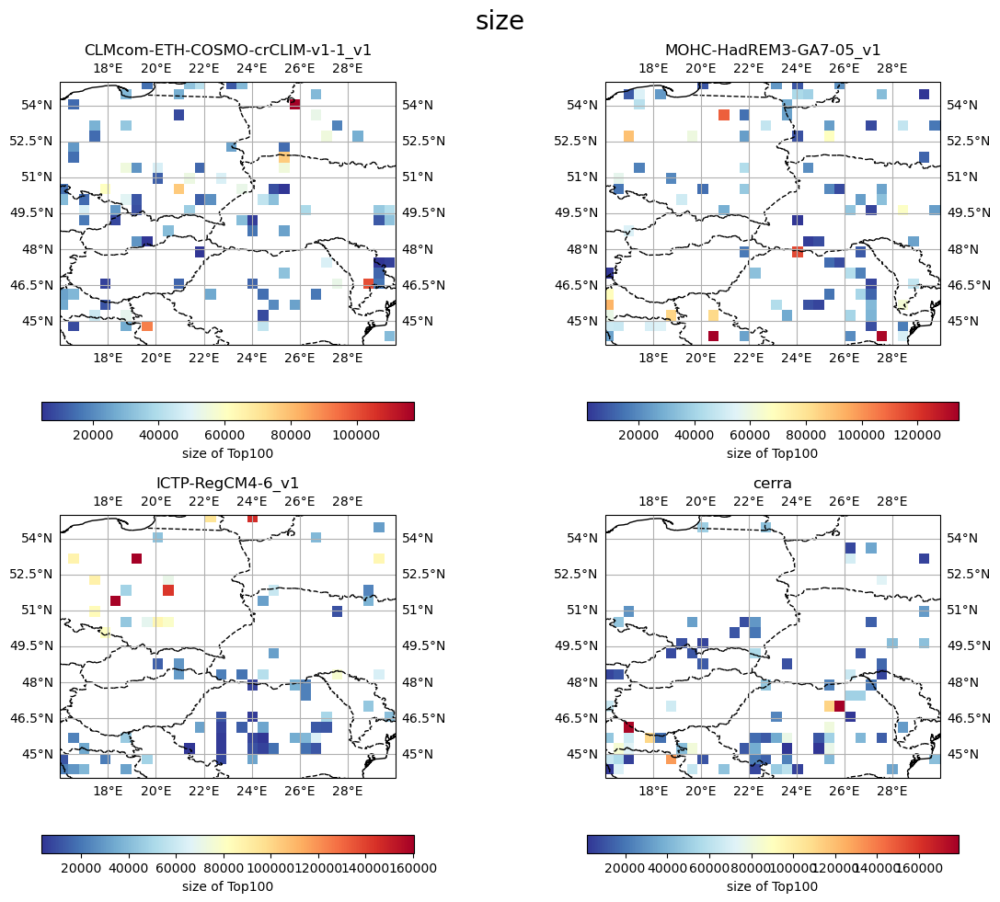

In [21]:
# prec_feature_ana_cmp_44.ipynb
EUR_1d = ['EUR-44', 'EUR-11']

n_eur = len(EUR_1d)
# lon_2d, lat_2d = np.meshgrid(lon_1d, lat_1d) # Lon, Lat

characters = ['max', 'min', 'mean', 'tot','size']
n_char = len(characters)

df_region = create_df_region('no plotting')
region = df_region.index.tolist()
n_region = len(df_region)
 

for res_EUR in EUR_1d:
    dir_eval = dir_d + res_EUR + '/'
    if res_EUR == 'EUR-44':
        model_s = ['CLMcom-CCLM5-0-6_v1', 'MOHC-HadGEM3-RA_v1', 'UCAN-WRF331G_v01']
    elif res_EUR == 'EUR-11':
        model_s = ['CLMcom-ETH-COSMO-crCLIM-v1-1_v1', \
                'MOHC-HadREM3-GA7-05_v1',\
                'ICTP-RegCM4-6_v1']

    n_model = len(model_s)

    # plotting
    dataset = model_s + ['cerra']
    n_ds = len(dataset)
    data_5d = np.zeros((n_ds, n_region, n_char, n_lat, n_lon))
    print(data_5d.shape)

    for nd in range(n_ds):
        if dataset[nd] == 'cerra':
            flnm = dir_o + 'obj_Top100Character_' + 'CERRA_' + 'EUR-44.nc'
        else:
            flnm = dir_o + 'obj_Top100Character_' + model_s[nd] + '_' + res_EUR + '.nc'
        print(flnm)
        with  xr.open_dataset(flnm) as ds:
            data_5d[nd] = ds['obj_characters'].values
        
    for nr in range(n_region):
        plot_obj_eval(df_region, region[nr], Lat, Lon, dataset, data_5d[:,nr,:,:], characters)   
    '''
    # plotting difference
    data_5d_new = data_5d[:-1].copy()

    for nd in range(len(dataset)-1):
        data_5d_new[nd] = data_5d[nd] - data_4d[-1]

    for nr in range(n_region):
        plot_obj_eval_diff(lat_2d, lon_2d, dataset[:-1], data_5d_new, characters)
     '''

#### box plot of prec. obj intensity

EUR-44 Top1 100 OBJ  max


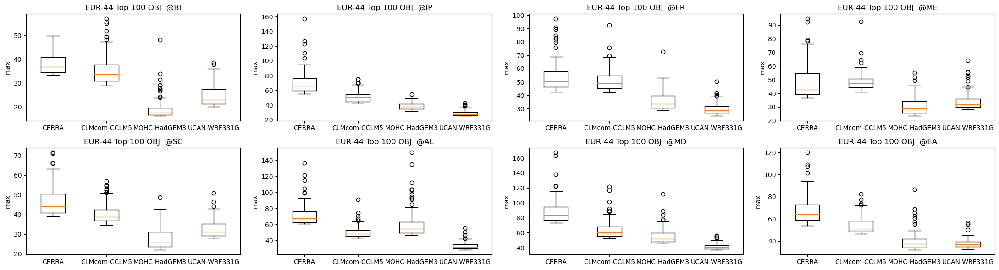

EUR-44 Top1 100 OBJ  min


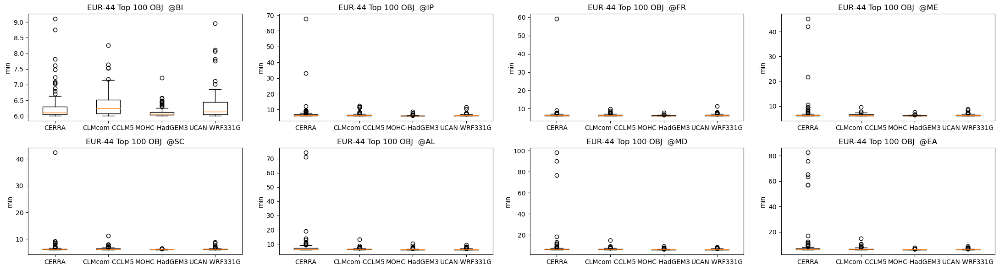

EUR-44 Top1 100 OBJ  avg


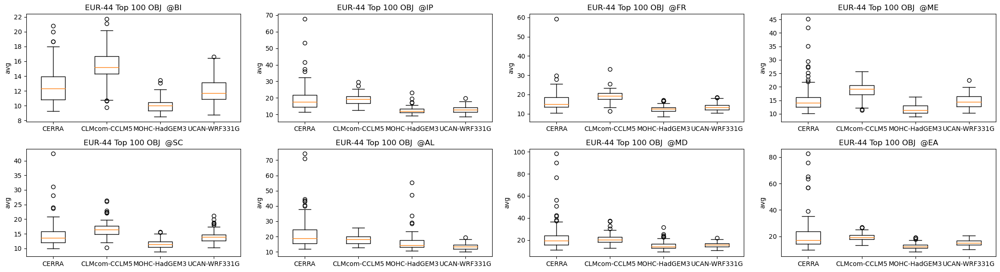

EUR-44 Top1 100 OBJ  size


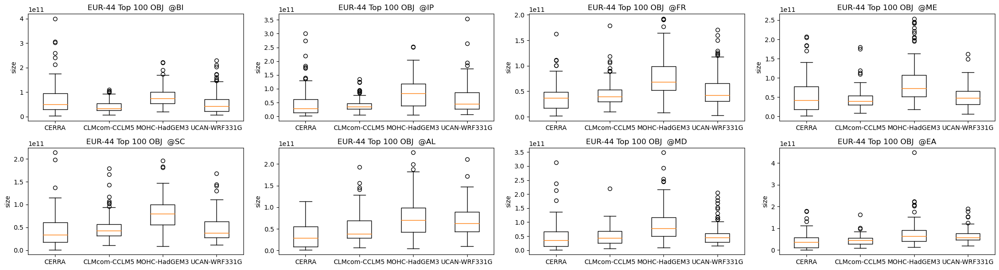

EUR-44 Top1 100 OBJ  tot


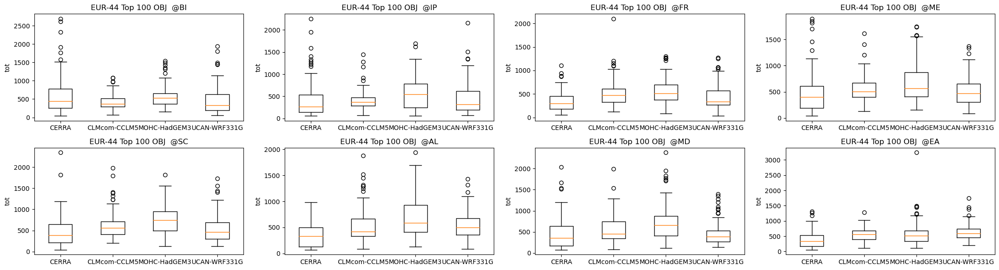

EUR-11 Top1 100 OBJ  max


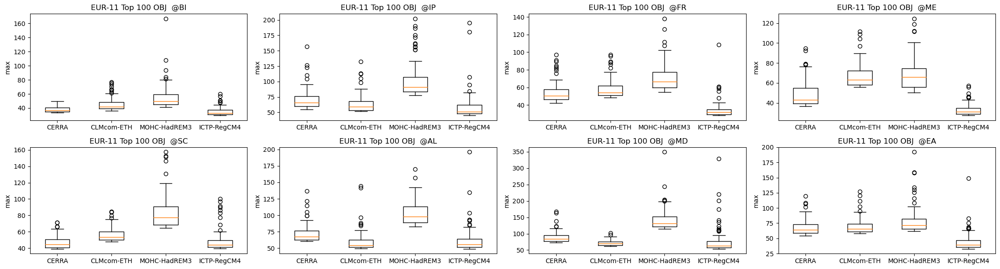

EUR-11 Top1 100 OBJ  min


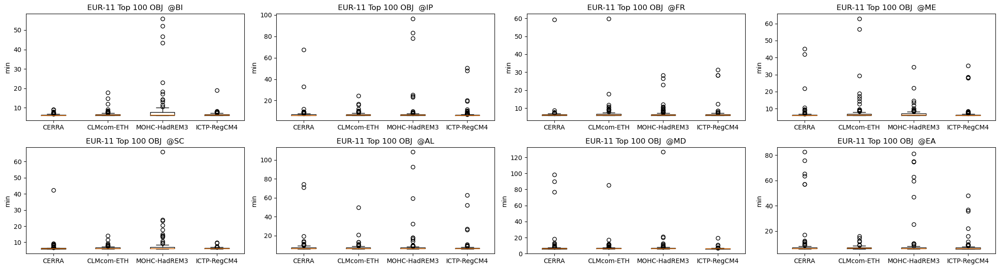

EUR-11 Top1 100 OBJ  avg


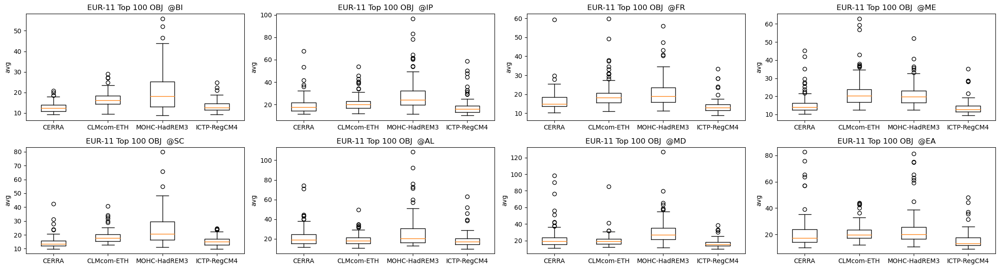

EUR-11 Top1 100 OBJ  size


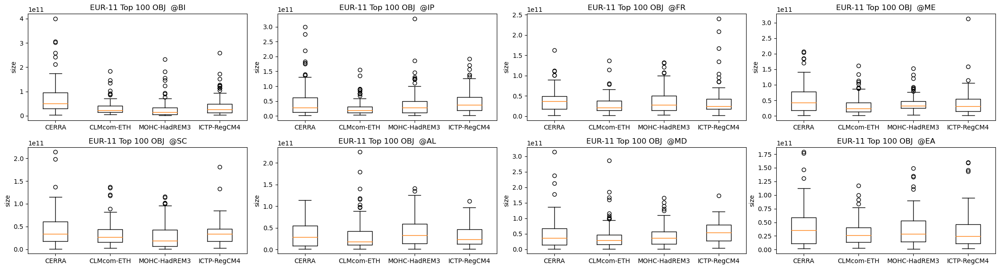

EUR-11 Top1 100 OBJ  tot


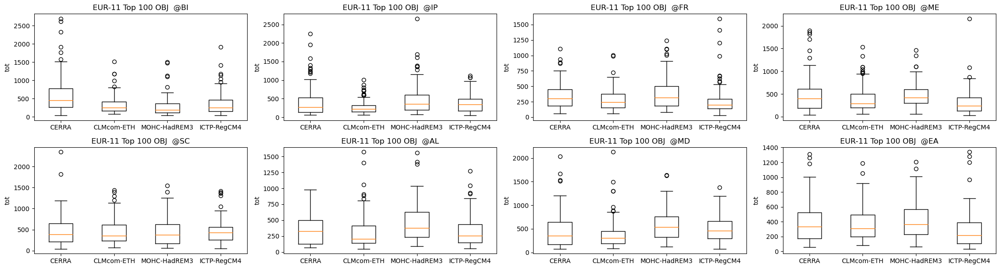

In [13]:
res_EUR = ['EUR-44', 'EUR-11']
var_1d = ['max','min','avg','size','tot']
region_1d = df_region.index.to_list()

def get_first_two_segments(input_string, delimiter):
    parts = input_string.split(delimiter)  # Split the string into parts based on the delimiter
    if len(parts) >= 2:
        return delimiter.join(parts[:2])  # Join the first two parts using the delimiter
    else:
        return input_string  # Return the original string if delimiter not found or string has less than 2 parts

for nr in range(len(res_EUR)):
    for nv in range(len(var_1d)):
        print(res_EUR[nr], 'Top1 100 OBJ ', var_1d[nv])
        plot_boxplot_p8(var_1d[nv], res_EUR[nr], region_1d)
 

In [106]:
aa ='dy_1_b_3_3'.rsplit('_', 1)
aa

['dy_1_b_3', '3']

In [107]:
def get_first_two_segments(input_string, delimiter):
    parts = input_string.split(delimiter)  # Split the string into parts based on the delimiter
    if len(parts) >= 2:
        return delimiter.join(parts[:2])  # Join the first two parts using the delimiter
    else:
        return input_string  # Return the original string if delimiter not found or string has less than 2 parts

# Example usage
original_string = "path/to/my/file.txt"
delimiter = "/"

result = get_first_two_segments(original_string, delimiter)
print(result)

path/to


In [113]:
original_string.replace('path', 'a')

'a/to/my/file.txt'